# Chronic Kidney Disease Analysis and Prediction

![](https://th.bing.com/th/id/R.7508e9f5ce7c05d2f2feb20cf9ea4436?rik=ap1KNSWzuYqBqQ&riu=http%3a%2f%2fwww.assignmentpoint.com%2fwp-content%2fuploads%2f2015%2f10%2fBioinformatics.jpg&ehk=jfYuZa%2b8bJCbDO2yzjFlWxGkCkkz6U%2b%2fN05aWJ95koQ%3d&risl=&pid=ImgRaw&r=0&sres=1&sresct=1)

# Table of contents
1. [Import packages](#1)
1. [Import data](#2)
1. [Data Cleaning](#3)
1. [EDA](#4)
1. [Variance Inflation Factor](#5)
1. [Principal Component Analysis](#6)  
1. [Decision Tree model](#7)   
1. [GridSearch](#8)    
1. [Feature Importance](#9)    
1. [Random Forest model](#10)    
1. [XgBoost model](#11)    
1. [TabNet model](#12)    
1. [TabNet + Optuna](#13)    
1. [Results](#14)    
1. [Conclusion](#15)    

<a id="1"></a>
# Import packages

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np

In [2]:
import warnings
warnings.filterwarnings("ignore")

<a id="2"></a>
# Import data

In [3]:
df_orig = pd.read_csv('../input/ckdisease/kidney_disease.csv')

In [4]:
df_orig.head()

,id,age,bp,sg,al,su,rbc,pc,pcc,ba,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
0,0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,4,51.0,80.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,...,35,7300,4.6,no,no,no,good,no,no,ckd


In [5]:
df_orig.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   id              400 non-null    int64  
 1   age             391 non-null    float64
 2   bp              388 non-null    float64
 3   sg              353 non-null    float64
 4   al              354 non-null    float64
 5   su              351 non-null    float64
 6   rbc             248 non-null    object 
 7   pc              335 non-null    object 
 8   pcc             396 non-null    object 
 9   ba              396 non-null    object 
 10  bgr             356 non-null    float64
 11  bu              381 non-null    float64
 12  sc              383 non-null    float64
 13  sod             313 non-null    float64
 14  pot             312 non-null    float64
 15  hemo            348 non-null    float64
 16  pcv             330 non-null    object 
 17  wc              295 non-null    obj

In [6]:
df_orig.describe()

,id,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo
count,400.000000,391.000000,388.000000,353.000000,354.000000,351.000000,356.000000,381.000000,383.000000,313.000000,312.000000,348.000000
mean,199.500000,51.483376,76.469072,1.017408,1.016949,0.450142,148.036517,57.425722,3.072454,137.528754,4.627244,12.526437
std,115.614301,17.169714,13.683637,0.005717,1.352679,1.099191,79.281714,50.503006,5.741126,10.408752,3.193904,2.912587
min,0.000000,2.000000,50.000000,1.005000,0.000000,0.000000,22.000000,1.500000,0.400000,4.500000,2.500000,3.100000
25%,99.750000,42.000000,70.000000,1.010000,0.000000,0.000000,99.000000,27.000000,0.900000,135.000000,3.800000,10.300000
50%,199.500000,55.000000,80.000000,1.020000,0.000000,0.000000,121.000000,42.000000,1.300000,138.000000,4.400000,12.650000
75%,299.250000,64.500000,80.000000,1.020000,2.000000,0.000000,163.000000,66.000000,2.800000,142.000000,4.900000,15.000000
max,399.000000,90.000000,180.000000,1.025000,5.000000,5.000000,490.000000,391.000000,76.000000,163.000000,47.000000,17.800000


In [7]:
df_orig.shape

(400, 26)

In [8]:
(df_orig.isnull().sum() / df_orig.shape[0] * 100.00).round(2)

id                 0.00
age                2.25
bp                 3.00
sg                11.75
al                11.50
su                12.25
rbc               38.00
pc                16.25
pcc                1.00
ba                 1.00
bgr               11.00
bu                 4.75
sc                 4.25
sod               21.75
pot               22.00
hemo              13.00
pcv               17.50
wc                26.25
rc                32.50
htn                0.50
dm                 0.50
cad                0.50
appet              0.25
pe                 0.25
ane                0.25
classification     0.00
dtype: float64

In [9]:
df_orig.shape

(400, 26)

<a id="3"></a>
# Data Cleaning

## Transform column names

In [10]:
df_orig.drop('id', axis = 1, inplace = True)

In [11]:
df_orig.columns = ['age', 'blood_pressure', 'specific_gravity', 'albumin', 'sugar', 'red_blood_cells', 'pus_cell',
              'pus_cell_clumps', 'bacteria', 'blood_glucose_random', 'blood_urea', 'serum_creatinine', 'sodium',
              'potassium', 'haemoglobin', 'packed_cell_volume', 'white_blood_cell_count', 'red_blood_cell_count',
              'hypertension', 'diabetes_mellitus', 'coronary_artery_disease', 'appetite', 'peda_edema',
              'aanemia', 'class']

In [12]:
df_orig.head()

,age,blood_pressure,specific_gravity,albumin,sugar,red_blood_cells,pus_cell,pus_cell_clumps,bacteria,blood_glucose_random,...,packed_cell_volume,white_blood_cell_count,red_blood_cell_count,hypertension,diabetes_mellitus,coronary_artery_disease,appetite,peda_edema,aanemia,class
0,48.0,80.0,1.020,1.0,0.0,NaN,normal,notpresent,notpresent,121.0,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,7.0,50.0,1.020,4.0,0.0,NaN,normal,notpresent,notpresent,NaN,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,62.0,80.0,1.010,2.0,3.0,normal,normal,notpresent,notpresent,423.0,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,117.0,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,51.0,80.0,1.010,2.0,0.0,normal,normal,notpresent,notpresent,106.0,...,35,7300,4.6,no,no,no,good,no,no,ckd


## Analyze categorical columns

In [13]:
df_orig['packed_cell_volume'] = pd.to_numeric(df_orig['packed_cell_volume'], errors='coerce')
df_orig['white_blood_cell_count'] = pd.to_numeric(df_orig['white_blood_cell_count'], errors='coerce')
df_orig['red_blood_cell_count'] = pd.to_numeric(df_orig['red_blood_cell_count'], errors='coerce')

In [14]:
cat_col=[col for col in df_orig.columns if df_orig[col].dtype=='object']
for col in cat_col:
    print('{} has {} values '.format(col,df_orig[col].unique()))
    print('\n')

red_blood_cells has [nan 'normal' 'abnormal'] values 


pus_cell has ['normal' 'abnormal' nan] values 


pus_cell_clumps has ['notpresent' 'present' nan] values 


bacteria has ['notpresent' 'present' nan] values 


hypertension has ['yes' 'no' nan] values 


diabetes_mellitus has ['yes' 'no' ' yes' '\tno' '\tyes' nan] values 


coronary_artery_disease has ['no' 'yes' '\tno' nan] values 


appetite has ['good' 'poor' nan] values 


peda_edema has ['no' 'yes' nan] values 


aanemia has ['no' 'yes' nan] values 


class has ['ckd' 'ckd\t' 'notckd'] values 




In [15]:
df_orig['diabetes_mellitus'].replace(to_replace = {'\tno':'no','\tyes':'yes',' yes':'yes'},inplace=True)

df_orig['coronary_artery_disease'] = df_orig['coronary_artery_disease'].replace(to_replace = '\tno', value='no')

df_orig['class'] = df_orig['class'].replace(to_replace = 'ckd\t', value = 'ckd')

df_orig['class'] = df_orig['class'].replace(to_replace = 'notckd', value = 'not ckd')


for col in cat_col:
    print('{} has {} values  '.format(col, df_orig[col].unique()))
    print('\n')

red_blood_cells has [nan 'normal' 'abnormal'] values  


pus_cell has ['normal' 'abnormal' nan] values  


pus_cell_clumps has ['notpresent' 'present' nan] values  


bacteria has ['notpresent' 'present' nan] values  


hypertension has ['yes' 'no' nan] values  


diabetes_mellitus has ['yes' 'no' nan] values  


coronary_artery_disease has ['no' 'yes' nan] values  


appetite has ['good' 'poor' nan] values  


peda_edema has ['no' 'yes' nan] values  


aanemia has ['no' 'yes' nan] values  


class has ['ckd' 'not ckd'] values  




In [16]:
df_orig['class'] = df_orig['class'].map({'ckd': 0, 'not ckd': 1})
df_orig['class'] = pd.to_numeric(df_orig['class'], errors='coerce')
cat_cols = [col for col in df_orig.columns if df_orig[col].dtype == 'object']
for col in cat_cols:
    print(f"{col} has {df_orig[col].unique()} values\n")

red_blood_cells has [nan 'normal' 'abnormal'] values

pus_cell has ['normal' 'abnormal' nan] values

pus_cell_clumps has ['notpresent' 'present' nan] values

bacteria has ['notpresent' 'present' nan] values

hypertension has ['yes' 'no' nan] values

diabetes_mellitus has ['yes' 'no' nan] values

coronary_artery_disease has ['no' 'yes' nan] values

appetite has ['good' 'poor' nan] values

peda_edema has ['no' 'yes' nan] values

aanemia has ['no' 'yes' nan] values



In [17]:
cat_cols = [col for col in df_orig.columns if df_orig[col].dtype == 'object']
num_cols = [col for col in df_orig.columns if df_orig[col].dtype != 'object']
num_cols = num_cols[:-1]
print(cat_cols)
print(num_cols)

['red_blood_cells', 'pus_cell', 'pus_cell_clumps', 'bacteria', 'hypertension', 'diabetes_mellitus', 'coronary_artery_disease', 'appetite', 'peda_edema', 'aanemia']
['age', 'blood_pressure', 'specific_gravity', 'albumin', 'sugar', 'blood_glucose_random', 'blood_urea', 'serum_creatinine', 'sodium', 'potassium', 'haemoglobin', 'packed_cell_volume', 'white_blood_cell_count', 'red_blood_cell_count']


## Replace NaN values

1) replace nan with mode for categorical values and mean for numerical:

In [18]:
df_orig_1 = df_orig

def mean_value_imputation(feature):
    mean = df_orig[feature].mean()
    df_orig[feature] = df_orig[feature].fillna(mean)
    
    
for col in num_cols:
    mean_value_imputation(col)

In [19]:
def impute_mode(feature):
    mode = df_orig[feature].mode()[0]
    df_orig[feature] = df_orig[feature].fillna(mode)
    
for col in cat_cols:
    impute_mode(col)

In [20]:
(df_orig.isnull().sum() / df_orig.shape[0] * 100.00).round(2)

age                        0.0
blood_pressure             0.0
specific_gravity           0.0
albumin                    0.0
sugar                      0.0
red_blood_cells            0.0
pus_cell                   0.0
pus_cell_clumps            0.0
bacteria                   0.0
blood_glucose_random       0.0
blood_urea                 0.0
serum_creatinine           0.0
sodium                     0.0
potassium                  0.0
haemoglobin                0.0
packed_cell_volume         0.0
white_blood_cell_count     0.0
red_blood_cell_count       0.0
hypertension               0.0
diabetes_mellitus          0.0
coronary_artery_disease    0.0
appetite                   0.0
peda_edema                 0.0
aanemia                    0.0
class                      0.0
dtype: float64

2) use knn to replace nan values:

In [21]:
from sklearn.impute import KNNImputer

imputer = KNNImputer(n_neighbors=11)
imputer.fit_transform(df_orig_1[num_cols])

def impute_mode(feature):
    mode = df_orig_1[feature].mode()[0]
    df_orig_1[feature] = df_orig_1[feature].fillna(mode)
    
for col in cat_cols:
    impute_mode(col)

In [22]:
(df_orig_1.isnull().sum() / df_orig_1.shape[0] * 100.00).round(2)

age                        0.0
blood_pressure             0.0
specific_gravity           0.0
albumin                    0.0
sugar                      0.0
red_blood_cells            0.0
pus_cell                   0.0
pus_cell_clumps            0.0
bacteria                   0.0
blood_glucose_random       0.0
blood_urea                 0.0
serum_creatinine           0.0
sodium                     0.0
potassium                  0.0
haemoglobin                0.0
packed_cell_volume         0.0
white_blood_cell_count     0.0
red_blood_cell_count       0.0
hypertension               0.0
diabetes_mellitus          0.0
coronary_artery_disease    0.0
appetite                   0.0
peda_edema                 0.0
aanemia                    0.0
class                      0.0
dtype: float64

Both methods work fine, but knn would be better for model accuracy.

<a id="4"></a>
# EDA

In [23]:
import pandas_profiling as pp

profile = pp.ProfileReport(df_orig, title="Chronic Kidney Disease Dataset Profile", html={"style": {"full_width": True}}, sort=None)
profile

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Check for outliers (there is apparently a lot of them):

In [24]:
num_cols1 = num_cols[:-2]
fig = px.box(df_orig[num_cols1], y=num_cols1)
fig.show()

In [25]:
fig = px.box(df_orig['white_blood_cell_count'], y='white_blood_cell_count')
fig.show()

In [26]:
fig = px.box(df_orig['red_blood_cell_count'], y='red_blood_cell_count')
fig.show()

In [27]:
import plotly.graph_objects as go
df_px = df_orig[num_cols]
fig = px.imshow(df_px.corr())
fig.show()

In [28]:
df_px = df_orig[['class', 'red_blood_cell_count', 'white_blood_cell_count', 'specific_gravity', 'packed_cell_volume']]
fig = px.scatter_matrix(df_px, 
    dimensions = ['red_blood_cell_count', 'white_blood_cell_count', 'specific_gravity', 'packed_cell_volume'],
    color="class")
fig.show()

In [29]:
fig = go.Figure([go.Histogram(x = df_orig['age'])])
fig.show()

From my perspective scaling age is not necessary, because the distribution is close to normal.

In [30]:
fig = go.Figure([go.Histogram(x = df_orig['white_blood_cell_count'])])
fig.show()

In [31]:
fig = go.Figure([go.Histogram(x = df_orig['red_blood_cell_count'])])
fig.show() 

In [32]:
fig = go.Figure([go.Histogram(x = df_orig['blood_glucose_random'])])
fig.show() 

Judging by the plots I would check the outliers and also use scaling for the columns mentioned above.

Let's check if diabetes and kidney disease are connected:

In [33]:
fig = px.scatter(df_orig, 
    x = df_orig['age'], y = df_orig['diabetes_mellitus'],
    color="class")
fig.show()

Seeing the there is no instances where there are both diabetes and ckd we can not assume that there is any correlation between them.

## Deal with Outliers

In [34]:
import numpy as np
# IQR
def IQR_outliers(col):

    Q1 = np.percentile(df_orig[col], 25,
                       interpolation = 'midpoint')

    Q3 = np.percentile(df_orig[col], 75,
                       interpolation = 'midpoint')
    
    per_95 = np.percentile(df_orig[col], 95,
                       interpolation = 'midpoint')
    
    IQR = Q3 - Q1
    
    upper = Q3+1.5*IQR
    lower = Q1-1.5*IQR
    
    df_orig[col] = np.where(df_orig[col] > upper, per_95, df_orig[col])
    df_orig[col] = np.where(df_orig[col] < lower, lower, df_orig[col])

    return df_orig



for col in num_cols:
    df_orig = IQR_outliers(col)

### Check outliers

In [35]:
num_cols1 = num_cols[:-2]
fig = px.box(df_orig[num_cols1], y=num_cols1)
fig.show()

In [36]:
fig = px.box(df_orig['white_blood_cell_count'], y='white_blood_cell_count')
fig.show()

In [37]:
fig = px.box(df_orig['red_blood_cell_count'], y='red_blood_cell_count')
fig.show()

## Use LabelEncoder for categorical values

In [38]:
for col in cat_cols:
    print(f"{col} has {df_orig[col].nunique()} categories\n")

red_blood_cells has 2 categories

pus_cell has 2 categories

pus_cell_clumps has 2 categories

bacteria has 2 categories

hypertension has 2 categories

diabetes_mellitus has 2 categories

coronary_artery_disease has 2 categories

appetite has 2 categories

peda_edema has 2 categories

aanemia has 2 categories



In [39]:
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

for col in cat_cols:
    df_orig[col] = le.fit_transform(df_orig[col])

In [40]:
df_orig.head()

,age,blood_pressure,specific_gravity,albumin,sugar,red_blood_cells,pus_cell,pus_cell_clumps,bacteria,blood_glucose_random,...,packed_cell_volume,white_blood_cell_count,red_blood_cell_count,hypertension,diabetes_mellitus,coronary_artery_disease,appetite,peda_edema,aanemia,class
0,48.0,80.0,1.0200,1.0,0.0,1,1,0,0,121.000000,...,44.0,7800.0,5.200000,1,1,0,0,0,0,0
1,9.0,55.0,1.0200,4.0,0.0,1,1,0,0,148.036517,...,38.0,6000.0,4.707435,0,0,0,0,0,0,0
2,62.0,80.0,1.0100,2.0,3.0,1,1,0,0,303.000000,...,31.0,7500.0,4.707435,0,1,0,1,0,1,0
3,48.0,70.0,1.0075,4.0,0.0,1,0,1,0,117.000000,...,32.0,6700.0,3.900000,1,0,0,1,1,1,0
4,51.0,80.0,1.0100,2.0,0.0,1,1,0,0,106.000000,...,35.0,7300.0,4.600000,0,0,0,0,0,0,0


In [41]:
df_orig.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   age                      400 non-null    float64
 1   blood_pressure           400 non-null    float64
 2   specific_gravity         400 non-null    float64
 3   albumin                  400 non-null    float64
 4   sugar                    400 non-null    float64
 5   red_blood_cells          400 non-null    int64  
 6   pus_cell                 400 non-null    int64  
 7   pus_cell_clumps          400 non-null    int64  
 8   bacteria                 400 non-null    int64  
 9   blood_glucose_random     400 non-null    float64
 10  blood_urea               400 non-null    float64
 11  serum_creatinine         400 non-null    float64
 12  sodium                   400 non-null    float64
 13  potassium                400 non-null    float64
 14  haemoglobin              4

In [42]:
from sklearn.model_selection import train_test_split
df, df_test = train_test_split(df_orig, test_size = 0.15, random_state = 42)

<a id="5"></a>
# Check VIF (Variance Inflation Factor)

In [43]:
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor

df_vif = df_orig
df_vif['const'] = 1

X = df_vif[num_cols+['const']]

vif_info = pd.DataFrame()
vif_info['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif_info['Column'] = X.columns
vif_info.sort_values('VIF', ascending=False)

,VIF,Column
14,61549.771696,const
11,4.309608,packed_cell_volume
10,4.278539,haemoglobin
6,2.864020,blood_urea
7,2.798366,serum_creatinine
13,2.176393,red_blood_cell_count
5,1.823602,blood_glucose_random
4,1.736423,sugar
3,1.720989,albumin
2,1.701454,specific_gravity


All features have VIF below 5, so they do not have multicolinearity.

*Not adding a column with constant leads to anomal values of VIF, the issue is described here:
https://github.com/statsmodels/statsmodels/issues/2376*

## Split the train/test data

I split train/validation/test as 65/20/15%, but because the dataset is small I would consider using 70/20/10% split.

In [44]:
ind_col = [col for col in df.columns if col != 'class']
dep_col = 'class'

X = df[ind_col]
y = df[dep_col]

X_test = df_test[ind_col]
y_test = df_test[dep_col]

In [45]:
print(X.shape)
print(X_test.shape)

(340, 24)
(60, 24)


In [46]:
from sklearn.model_selection import train_test_split

X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size = 0.20, random_state = 0)

<a id="6"></a>
# Perform PCA on data

In [47]:
from sklearn.decomposition import PCA
pca = PCA(n_components=24)
principalComponents = pca.fit_transform(X_train)
print (pca.explained_variance_ratio_.cumsum())

[0.99815566 0.99945531 0.9998701  0.9999449  0.99997971 0.99999282
 0.99999755 0.99999867 0.99999914 0.99999943 0.99999959 0.99999968
 0.99999974 0.99999979 0.99999984 0.99999987 0.9999999  0.99999992
 0.99999995 0.99999996 0.99999998 0.99999999 1.         1.        ]


*The PCA did not improve model perfomance so I did not use it, n_components = 24 remains the best if we use it.*

In [48]:
pca.fit(X_train)
X_valid_new = pca.transform(X_valid)

In [49]:
#pca.fit(X_train)
X_train_new = pca.transform(X_train)

In [50]:
X_train_new.shape

(272, 24)

In [51]:
X_valid_new.shape

(68, 24)

In [52]:
print(X_valid_new)

[[-9.67724432e+02 -1.93592687e+01 -1.52994433e+01 ...  3.32811497e-02
   3.13587954e-02 -5.05382073e-03]
 [ 2.23206350e+03 -7.81216685e+01  2.08000382e+01 ... -5.94053545e-02
  -2.94029912e-01  6.15268299e-03]
 [ 1.33293973e+03  1.43274418e+02 -3.78953973e+01 ...  7.70050148e-02
  -4.25982031e-02 -2.94547634e-03]
 ...
 [ 9.32177776e+02 -4.15719528e+01 -2.54938204e+01 ...  2.61335867e-02
   4.79425610e-04 -8.07666544e-04]
 [ 1.63204649e+03 -7.54960477e+01  3.71971995e+00 ... -3.00288570e-03
  -2.79640518e-02 -7.44410095e-04]
 [ 1.43204022e+03 -8.28178977e+01 -5.56503546e-01 ... -2.21844603e-02
  -6.04133567e-02  1.78931981e-03]]


### KMeans Clustering

Let's check best k for kmeans clustering:

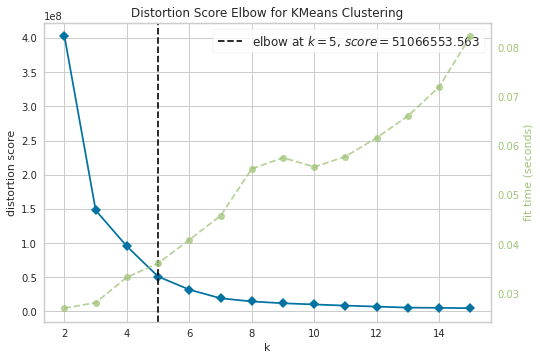

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [53]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
model = KElbowVisualizer(KMeans(), k=15)
model.fit(X_train)
model.show()

In [54]:
from sklearn.cluster import KMeans
kmeans = KMeans(
    init="random",
    n_clusters=5,
    n_init=10,
    max_iter=300,
    random_state=42
)
X_clustered = kmeans.fit_transform(X_train)
                        
from sklearn.metrics import silhouette_score
score = silhouette_score(X_clustered, kmeans.labels_)
print(score)

0.6659378288891068


# Modeling

<a id="7"></a>
# Build the Decision Tree model

In [55]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

dtc = DecisionTreeClassifier()
dtc.fit(X_train_new, y_train)

# accuracy score, confusion matrix and classification report of decision tree

dtc_acc = accuracy_score(y_valid, dtc.predict(X_valid_new))
dtc_acc_test = accuracy_score(y_test, dtc.predict(X_test))

print(f"Training Accuracy of Decision Tree Classifier is {accuracy_score(y_train, dtc.predict(X_train_new))}")
print(f"Test Accuracy of Decision Tree Classifier is {dtc_acc_test} \n")
print(f"Validation Accuracy of Decision Tree Classifier is {accuracy_score(y_valid, dtc.predict(X_valid_new))}")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, dtc.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, dtc.predict(X_valid_new))}")

Training Accuracy of Decision Tree Classifier is 1.0
Test Accuracy of Decision Tree Classifier is 0.6833333333333333 

Validation Accuracy of Decision Tree Classifier is 0.7941176470588235
Confusion Matrix :- 
[[24  5]
 [ 9 30]]

Classification Report :- 
               precision    recall  f1-score   support

           0       0.73      0.83      0.77        29
           1       0.86      0.77      0.81        39

    accuracy                           0.79        68
   macro avg       0.79      0.80      0.79        68
weighted avg       0.80      0.79      0.80        68



<a id="8"></a>
# Use GridSearch

In [56]:
from sklearn.model_selection import GridSearchCV
grid_param = {
    'criterion' : ['gini', 'entropy'],
    'max_depth' : [3, 5, 7, 10],
    'splitter' : ['best', 'random'],
    'min_samples_leaf' : [1, 2, 3, 5, 7],
    'min_samples_split' : [1, 2, 3, 5, 7],
    'max_features' : ['auto', 'sqrt', 'log2']
}

grid_search_dtc = GridSearchCV(dtc, grid_param, cv = 11, n_jobs = -1, verbose = 1)
grid_search_dtc.fit(X_train, y_train)
print(grid_search_dtc.best_params_)
print(grid_search_dtc.best_score_)

Fitting 11 folds for each of 1200 candidates, totalling 13200 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  88 tasks      | elapsed:    1.4s
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 231, in fit
    % self.min_samples_split)
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.p

{'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'splitter': 'best'}
0.9851515151515152


/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 231, in fit
    % self.min_samples_split)
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
T

##### Best parameters after using GridSearch are: 
*{'criterion': 'gini', 'max_depth': 7, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 7, 'splitter': 'best'}*

In [57]:
dtc = grid_search_dtc.best_estimator_

print(dtc)

# accuracy score, confusion matrix and classification report of grid search

dtc_gs_acc = accuracy_score(y_valid, dtc.predict(X_valid))
dtc_gs_acc_test = accuracy_score(y_test, dtc.predict(X_test))

print(f"Training Accuracy of Decision Tree Classifier is {accuracy_score(y_train, dtc.predict(X_train))}")
print(f"Test Accuracy of Decision Tree Classifier is {dtc_gs_acc_test}")
print(f"Validation Accuracy of Decision Tree Classifier is {accuracy_score(y_valid, dtc.predict(X_valid))} \n")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, dtc.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, dtc.predict(X_valid_new))}")

DecisionTreeClassifier(max_depth=5, max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=3)
Training Accuracy of Decision Tree Classifier is 0.9705882352941176
Test Accuracy of Decision Tree Classifier is 0.9833333333333333
Validation Accuracy of Decision Tree Classifier is 0.9264705882352942 

Confusion Matrix :- 
[[17 12]
 [24 15]]

Classification Report :- 
               precision    recall  f1-score   support

           0       0.41      0.59      0.49        29
           1       0.56      0.38      0.45        39

    accuracy                           0.47        68
   macro avg       0.49      0.49      0.47        68
weighted avg       0.50      0.47      0.47        68



<a id="9"></a>
# Feature Importance

According to National Health Service UK:
> Chronic kidney disease is usually caused by other conditions that put a strain on the kidneys. Often it's the result of a combination of different problems.

NHS gives further descriptions of possible CKD causes, such as:

>*CKD can be caused by:*
>* high blood pressure – over time, this can put strain on the small blood vessels in the kidneys and stop the kidneys working properly
>* diabetes – too much glucose in your blood can damage the tiny filters in the kidneys
>* high cholesterol – this can cause a build-up of fatty deposits in the blood vessels supplying your kidneys, which can make it harder for them to work properly
>* kidney infections
>* glomerulonephritis – kidney inflammation
>* polycystic kidney disease – an inherited condition where growths called cysts develop in the kidneys
>* blockages in the flow of urine – for example, from kidney stones that keep coming back, or an enlarged prostate long-term, regular use of certain medicines – such as lithium and non-steroidal anti-inflammatory drugs (NSAIDs)


3 methods were used to analyze feature importance for GridSearch model:

---> using built-in function

                    feature  importance
3                   albumin    0.626558
11         serum_creatinine    0.177554
22               peda_edema    0.050185
19        diabetes_mellitus    0.046095
17     red_blood_cell_count    0.040553
1            blood_pressure    0.035472
15       packed_cell_volume    0.021242
9      blood_glucose_random    0.002340
0                       age    0.000000
14              haemoglobin    0.000000
21                 appetite    0.000000
20  coronary_artery_disease    0.000000
18             hypertension    0.000000
16   white_blood_cell_count    0.000000
12                   sodium    0.000000
13                potassium    0.000000
10               blood_urea    0.000000
8                  bacteria    0.000000
7           pus_cell_clumps    0.000000
6                  pus_cell    0.000000
5           red_blood_cells    0.000000
4                     sugar    0.000000
2          specific_gravity    0.000000
23                  aanemia    0.000000


Text(0.5, 1.0, 'Feature Importance')

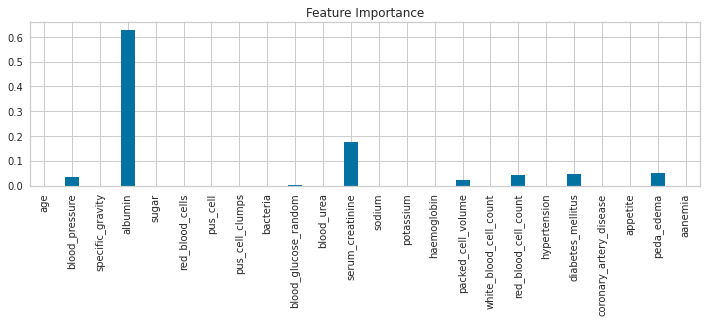

In [58]:
plt.figure(figsize=(12,3))
features = X_test.columns.values.tolist()
importance = dtc.feature_importances_.tolist()
ft_imp = pd.DataFrame()
ft_imp['feature'] = features
ft_imp['importance'] = importance
ft_imp.sort_values(by=['importance'], ascending = False, inplace=True)
print(ft_imp)
feature_series = pd.Series(data=importance,index=features)
feature_series.plot.bar()
plt.title('Feature Importance')

---> using LIME

In [59]:
import lime
import lime.lime_tabular

explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values, feature_names=X_test.columns.values.tolist(),
                                                  class_names=['skd', 'not skd'], verbose=True, mode='classification')

In [60]:
j = len(X_train) - 1
exp = explainer.explain_instance(X_train.values[j], grid_search_dtc.predict_proba, num_features=10)

Intercept 0.290156713446835
Prediction_local [-0.15405203]
Right: 0.0


In [61]:
exp.show_in_notebook(show_table=True)

---> using boruta-shap

In [62]:
!pip install borutashap

In [63]:
from BorutaShap import BorutaShap

Feature_Selector = BorutaShap(importance_measure='shap', classification=False)

Feature_Selector.fit(X=X_train, y=y_train, n_trials=50, random_state=0)

  0%|          | 0/50 [00:00<?, ?it/s]

8 attributes confirmed important: ['red_blood_cell_count', 'specific_gravity', 'serum_creatinine', 'hypertension', 'blood_glucose_random', 'albumin', 'haemoglobin', 'packed_cell_volume']
14 attributes confirmed unimportant: ['diabetes_mellitus', 'blood_pressure', 'aanemia', 'white_blood_cell_count', 'red_blood_cells', 'pus_cell', 'peda_edema', 'pus_cell_clumps', 'bacteria', 'coronary_artery_disease', 'age', 'potassium', 'sodium', 'appetite']
2 tentative attributes remains: ['sugar', 'blood_urea']


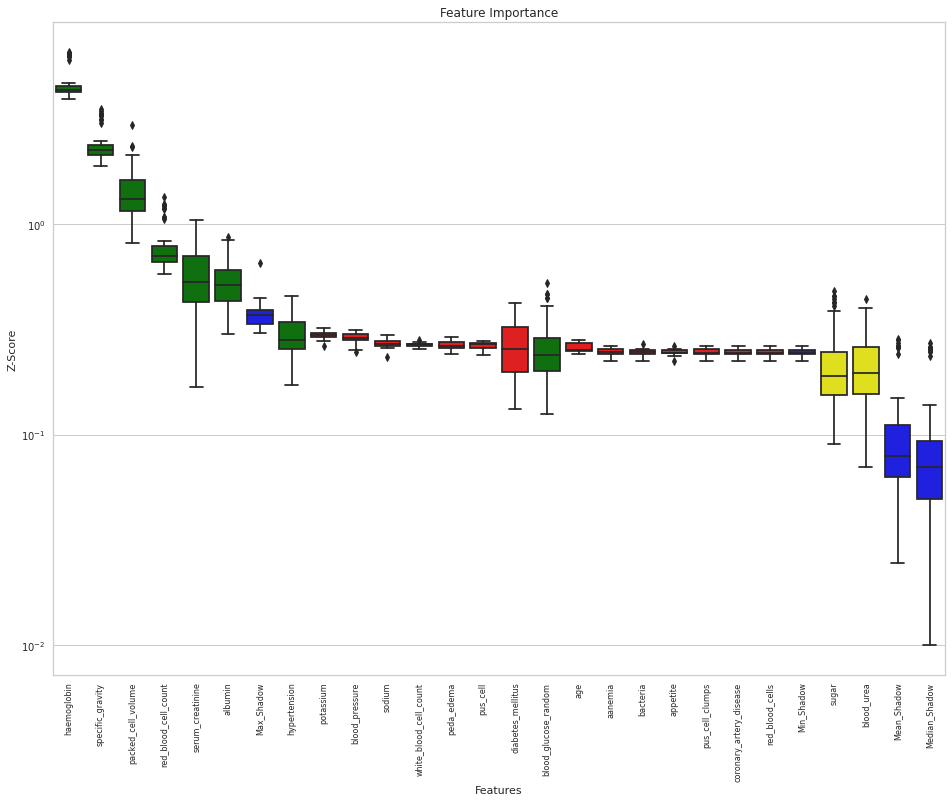

Selected features are: ['albumin', 'blood_glucose_random', 'haemoglobin', 'hypertension', 'packed_cell_volume', 'red_blood_cell_count', 'serum_creatinine', 'specific_gravity']


In [64]:
Feature_Selector.plot(which_features='all', figsize=(16,12))

selected_columns = list()
selected_columns.append(sorted(Feature_Selector.Subset().columns))
    
print(f"Selected features are: {selected_columns[-1]}")

##### All methods may slightly differ in their results, but all of them correspond to scientific definition of possible CKD causes. In conlusion, anomalies in specific gravity (kidney's ability to concentrate urine), blood pressure and presence of diabetes/high glucose level can be an alarming indicator of CKD.

<a id="10"></a>
# Random Forest

In [65]:
from sklearn.ensemble import RandomForestClassifier

rd_clf = RandomForestClassifier(criterion = 'entropy', max_depth = 10, max_features = 'auto', min_samples_leaf = 2, min_samples_split = 7, n_estimators = 12)
rd_clf.fit(X_train_new, y_train)

# accuracy score, confusion matrix and classification report of random forest

rd_clf_acc = accuracy_score(y_valid, rd_clf.predict(X_valid_new))
rd_clf_acc_test = accuracy_score(y_test, rd_clf.predict(X_test))

print(f"Training Accuracy of Random Forest Classifier is {accuracy_score(y_train, rd_clf.predict(X_train_new))}")
print(f"Test Accuracy of Random Forest Classifier is {rd_clf_acc_test} \n")
print(f"Validation Accuracy of Random Forest Classifier is {accuracy_score(y_valid, rd_clf.predict(X_valid_new))}")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, rd_clf.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, rd_clf.predict(X_valid_new))}")

Training Accuracy of Random Forest Classifier is 0.9926470588235294
Test Accuracy of Random Forest Classifier is 0.6833333333333333 

Validation Accuracy of Random Forest Classifier is 0.9264705882352942
Confusion Matrix :- 
[[29  0]
 [ 5 34]]

Classification Report :- 
               precision    recall  f1-score   support

           0       0.85      1.00      0.92        29
           1       1.00      0.87      0.93        39

    accuracy                           0.93        68
   macro avg       0.93      0.94      0.93        68
weighted avg       0.94      0.93      0.93        68



<a id="11"></a>
# XGBoost

In [66]:
from xgboost import XGBClassifier

xgb = XGBClassifier(objective = 'binary:logistic', learning_rate = 0.5, max_depth = 5, n_estimators = 150)
xgb.fit(X_train_new, y_train)

# accuracy score, confusion matrix and classification report of xgboost

xgb_acc = accuracy_score(y_valid, xgb.predict(X_valid_new))
xgb_acc_test = accuracy_score(y_test, xgb.predict(X_test))

print(f"Training Accuracy of XgBoost is {accuracy_score(y_train, xgb.predict(X_train_new))}")
print(f"Test Accuracy of XgBoost is {xgb_acc_test}")
print(f"Validation Accuracy of XgBoost is {accuracy_score(y_valid, xgb.predict(X_valid_new))} \n")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, xgb.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, xgb.predict(X_valid_new))}")

[12:51:30] WARNING: ../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Training Accuracy of XgBoost is 1.0
Test Accuracy of XgBoost is 0.6833333333333333
Validation Accuracy of XgBoost is 0.9558823529411765 

Confusion Matrix :- 
[[29  0]
 [ 3 36]]

Classification Report :- 
               precision    recall  f1-score   support

           0       0.91      1.00      0.95        29
           1       1.00      0.92      0.96        39

    accuracy                           0.96        68
   macro avg       0.95      0.96      0.96        68
weighted avg       0.96      0.96      0.96        68



<a id="12"></a>
# TabNet

In [67]:
!pip install pytorch-tabnet

In [68]:
from pytorch_tabnet.tab_model import TabNetClassifier
from sklearn.model_selection import KFold
import torch as torch

In [69]:
clf = TabNetClassifier(verbose=1,seed=42)

Device used : cpu


In [70]:
clf.fit(X_train=X_train_new, y_train=y_train,
               eval_metric=['auc'])

No early stopping will be performed, last training weights will be used.
epoch 0  | loss: 0.61245 |  0:00:00s
epoch 1  | loss: 0.5366  |  0:00:00s
epoch 2  | loss: 0.47675 |  0:00:00s
epoch 3  | loss: 0.4854  |  0:00:00s
epoch 4  | loss: 0.42861 |  0:00:00s
epoch 5  | loss: 0.39534 |  0:00:00s
epoch 6  | loss: 0.36983 |  0:00:00s
epoch 7  | loss: 0.33696 |  0:00:00s
epoch 8  | loss: 0.32421 |  0:00:00s
epoch 9  | loss: 0.30175 |  0:00:00s
epoch 10 | loss: 0.28307 |  0:00:00s
epoch 11 | loss: 0.26004 |  0:00:00s
epoch 12 | loss: 0.22831 |  0:00:00s
epoch 13 | loss: 0.23502 |  0:00:00s
epoch 14 | loss: 0.193   |  0:00:00s
epoch 15 | loss: 0.19102 |  0:00:00s
epoch 16 | loss: 0.17174 |  0:00:00s
epoch 17 | loss: 0.14431 |  0:00:00s
epoch 18 | loss: 0.12649 |  0:00:00s
epoch 19 | loss: 0.11688 |  0:00:00s
epoch 20 | loss: 0.13117 |  0:00:00s
epoch 21 | loss: 0.09641 |  0:00:00s
epoch 22 | loss: 0.1157  |  0:00:00s
epoch 23 | loss: 0.07184 |  0:00:00s
epoch 24 | loss: 0.08985 |  0:00:00s
ep

In [71]:
tbnt_acc = accuracy_score(y_valid, clf.predict(X_valid_new))
#tbnt_acc_test = accuracy_score(y_test, clf.predict(X_test))

print(f"Training Accuracy of TabNet is {accuracy_score(y_train, clf.predict(X_train_new))}")
#print(f"Test Accuracy of TabNet is {tbnt_acc_test} \n")
print(f"Validation Accuracy of TabNet is {accuracy_score(y_valid, clf.predict(X_valid_new))}")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, clf.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, clf.predict(X_valid_new))}")

Training Accuracy of TabNet is 0.9191176470588235
Validation Accuracy of TabNet is 0.8676470588235294
Confusion Matrix :- 
[[25  4]
 [ 5 34]]

Classification Report :- 
               precision    recall  f1-score   support

           0       0.83      0.86      0.85        29
           1       0.89      0.87      0.88        39

    accuracy                           0.87        68
   macro avg       0.86      0.87      0.87        68
weighted avg       0.87      0.87      0.87        68



<a id="13"></a>
# TabNet Optimization (Optuna)

In [72]:
import optuna
from optuna import Trial

In [73]:
EPOCHS = 30
BATCH_SIZE = 32

def objective(trial):
    # parameter set by optuna
    N_D = trial.suggest_int('N_D', 8, 32)
    N_A = N_D
    GAMMA = trial.suggest_float('GAMMA', 1.0, 2.0)
    N_STEPS = trial.suggest_int('N_STEPS', 1, 3, 1)
    LAMBDA_SPARSE = trial.suggest_loguniform("LAMBDA_SPARSE", 1e-5, 1e-1)
    
    # changes
    # introduced lambda-sparse
    clf = TabNetClassifier(
                       optimizer_fn=torch.optim.Adam,
                       optimizer_params=dict(lr=2e-2),
                       scheduler_params={"step_size":4,
                                         "gamma":0.9},
                       scheduler_fn=torch.optim.lr_scheduler.StepLR,
                       mask_type='sparsemax',
                          n_d = N_D,
                          n_a = N_A,
                          gamma = GAMMA,
                          n_steps = N_STEPS,
                          lambda_sparse = LAMBDA_SPARSE)
    
    clf.fit(X_train_new, y_train,
        eval_set=[(X_train_new, y_train),(X_valid_new, y_valid)],
        max_epochs = EPOCHS,
        batch_size = BATCH_SIZE,
        patience = 5,
        eval_name=['train', 'valid'],
        eval_metric=['auc']
           )
    
    # changed, now score is max val_uac
    score = np.max(clf.history['valid_auc'])
    
    return score

In [74]:
study = optuna.create_study(direction='maximize', study_name = 'tabnet-study')

study.optimize(objective, n_trials=150, timeout = 3600*8)

print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2022-01-11 12:52:09,061] A new study created in memory with name: tabnet-study


Device used : cpu
epoch 0  | loss: 0.81876 | train_auc: 0.64004 | valid_auc: 0.65517 |  0:00:00s
epoch 1  | loss: 0.547   | train_auc: 0.74179 | valid_auc: 0.70734 |  0:00:00s
epoch 2  | loss: 0.34929 | train_auc: 0.78037 | valid_auc: 0.79134 |  0:00:00s
epoch 3  | loss: 0.33439 | train_auc: 0.86341 | valid_auc: 0.88506 |  0:00:01s
epoch 4  | loss: 0.30081 | train_auc: 0.94293 | valid_auc: 0.89744 |  0:00:01s
epoch 5  | loss: 0.24032 | train_auc: 0.92264 | valid_auc: 0.86737 |  0:00:01s
epoch 6  | loss: 0.33126 | train_auc: 0.95223 | valid_auc: 0.90363 |  0:00:02s
epoch 7  | loss: 0.18822 | train_auc: 0.96824 | valid_auc: 0.9328  |  0:00:02s
epoch 8  | loss: 0.15222 | train_auc: 0.97005 | valid_auc: 0.94253 |  0:00:02s
epoch 9  | loss: 0.14917 | train_auc: 0.96987 | valid_auc: 0.92396 |  0:00:02s
epoch 10 | loss: 0.19763 | train_auc: 0.98001 | valid_auc: 0.95491 |  0:00:03s
epoch 11 | loss: 0.12752 | train_auc: 0.98771 | valid_auc: 0.94341 |  0:00:03s
epoch 12 | loss: 0.08184 | train_a

[I 2022-01-11 12:52:15,503] Trial 0 finished with value: 0.982316534040672 and parameters: {'N_D': 28, 'GAMMA': 1.5338755290498869, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.002620037496335036}. Best is trial 0 with value: 0.982316534040672.


epoch 22 | loss: 0.01217 | train_auc: 0.98998 | valid_auc: 0.97613 |  0:00:06s

Early stopping occurred at epoch 22 with best_epoch = 17 and best_valid_auc = 0.98232
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 1.05011 | train_auc: 0.45012 | valid_auc: 0.54111 |  0:00:00s
epoch 1  | loss: 0.65442 | train_auc: 0.60568 | valid_auc: 0.58179 |  0:00:00s
epoch 2  | loss: 0.57414 | train_auc: 0.67778 | valid_auc: 0.56145 |  0:00:00s
epoch 3  | loss: 0.48767 | train_auc: 0.7712  | valid_auc: 0.62157 |  0:00:00s
epoch 4  | loss: 0.44056 | train_auc: 0.81377 | valid_auc: 0.76127 |  0:00:01s
epoch 5  | loss: 0.40885 | train_auc: 0.85459 | valid_auc: 0.83466 |  0:00:01s
epoch 6  | loss: 0.33085 | train_auc: 0.88919 | valid_auc: 0.88683 |  0:00:01s
epoch 7  | loss: 0.33651 | train_auc: 0.91111 | valid_auc: 0.92838 |  0:00:01s
epoch 8  | loss: 0.26903 | train_auc: 0.90996 | valid_auc: 0.92308 |  0:00:02s
epoch 9  | loss: 0.242   | train_auc: 0.92874 | vali

[I 2022-01-11 12:52:22,095] Trial 1 finished with value: 0.9832007073386384 and parameters: {'N_D': 8, 'GAMMA': 1.8581805573393444, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0009268944058298628}. Best is trial 1 with value: 0.9832007073386384.


epoch 29 | loss: 0.14326 | train_auc: 0.98376 | valid_auc: 0.9664  |  0:00:06s
Stop training because you reached max_epochs = 30 with best_epoch = 26 and best_valid_auc = 0.9832
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 1.39863 | train_auc: 0.61063 | valid_auc: 0.78868 |  0:00:00s
epoch 1  | loss: 0.51448 | train_auc: 0.68351 | valid_auc: 0.59063 |  0:00:00s
epoch 2  | loss: 0.3946  | train_auc: 0.71075 | valid_auc: 0.7206  |  0:00:00s
epoch 3  | loss: 0.3171  | train_auc: 0.8599  | valid_auc: 0.81521 |  0:00:00s
epoch 4  | loss: 0.28591 | train_auc: 0.92729 | valid_auc: 0.89478 |  0:00:00s
epoch 5  | loss: 0.28477 | train_auc: 0.94674 | valid_auc: 0.90363 |  0:00:01s
epoch 6  | loss: 0.21595 | train_auc: 0.97802 | valid_auc: 0.92661 |  0:00:01s
epoch 7  | loss: 0.2139  | train_auc: 0.97723 | valid_auc: 0.93722 |  0:00:01s
epoch 8  | loss: 0.13937 | train_auc: 0.97512 | valid_auc: 0.94695 |  0:00:01s
epoch 9  | loss: 0.12955 | train_auc: 0.

[I 2022-01-11 12:52:26,102] Trial 2 finished with value: 0.9885057471264367 and parameters: {'N_D': 26, 'GAMMA': 1.9005887672025925, 'N_STEPS': 2, 'LAMBDA_SPARSE': 7.638843454178862e-05}. Best is trial 2 with value: 0.9885057471264367.


Device used : cpu
epoch 0  | loss: 0.48756 | train_auc: 0.67156 | valid_auc: 0.74359 |  0:00:00s
epoch 1  | loss: 0.39581 | train_auc: 0.79481 | valid_auc: 0.82051 |  0:00:00s
epoch 2  | loss: 0.24771 | train_auc: 0.86039 | valid_auc: 0.87179 |  0:00:00s
epoch 3  | loss: 0.12022 | train_auc: 0.93907 | valid_auc: 0.94607 |  0:00:00s
epoch 4  | loss: 0.07    | train_auc: 0.96576 | valid_auc: 0.95491 |  0:00:00s
epoch 5  | loss: 0.20893 | train_auc: 0.98315 | valid_auc: 0.93988 |  0:00:00s
epoch 6  | loss: 0.1893  | train_auc: 0.97856 | valid_auc: 0.92838 |  0:00:01s
epoch 7  | loss: 0.07077 | train_auc: 0.99366 | valid_auc: 0.9832  |  0:00:01s
epoch 8  | loss: 0.12503 | train_auc: 0.99324 | valid_auc: 0.96905 |  0:00:01s
epoch 9  | loss: 0.0569  | train_auc: 0.99571 | valid_auc: 0.9611  |  0:00:01s
epoch 10 | loss: 0.04074 | train_auc: 0.99001 | valid_auc: 0.96905 |  0:00:01s


[I 2022-01-11 12:52:28,169] Trial 3 finished with value: 0.9832007073386384 and parameters: {'N_D': 32, 'GAMMA': 1.926066489461844, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.012602041717106134}. Best is trial 2 with value: 0.9885057471264367.


epoch 11 | loss: 0.03879 | train_auc: 0.99149 | valid_auc: 0.96552 |  0:00:01s
epoch 12 | loss: 0.09738 | train_auc: 0.99203 | valid_auc: 0.95137 |  0:00:02s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.9832
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.57257 | train_auc: 0.6538  | valid_auc: 0.64633 |  0:00:00s
epoch 1  | loss: 0.41428 | train_auc: 0.76129 | valid_auc: 0.66932 |  0:00:00s
epoch 2  | loss: 0.33687 | train_auc: 0.82886 | valid_auc: 0.7931  |  0:00:00s
epoch 3  | loss: 0.27557 | train_auc: 0.90616 | valid_auc: 0.90451 |  0:00:00s
epoch 4  | loss: 0.22468 | train_auc: 0.95851 | valid_auc: 0.94872 |  0:00:00s
epoch 5  | loss: 0.24293 | train_auc: 0.96769 | valid_auc: 0.95933 |  0:00:00s
epoch 6  | loss: 0.22909 | train_auc: 0.95495 | valid_auc: 0.96198 |  0:00:01s
epoch 7  | loss: 0.20177 | train_auc: 0.96866 | valid_auc: 0.95579 |  0:00:01s
epoch 8  | loss: 0.11743 | train_auc: 0.966   | valid_

[I 2022-01-11 12:52:29,956] Trial 4 finished with value: 0.9619805481874447 and parameters: {'N_D': 27, 'GAMMA': 1.0411822343789927, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005036919421968264}. Best is trial 2 with value: 0.9885057471264367.


epoch 10 | loss: 0.16376 | train_auc: 0.97862 | valid_auc: 0.93811 |  0:00:01s
epoch 11 | loss: 0.13119 | train_auc: 0.98442 | valid_auc: 0.93988 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.96198
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.58368 | train_auc: 0.5282  | valid_auc: 0.61273 |  0:00:00s
epoch 1  | loss: 0.44995 | train_auc: 0.72216 | valid_auc: 0.7321  |  0:00:00s
epoch 2  | loss: 0.37844 | train_auc: 0.74179 | valid_auc: 0.77542 |  0:00:00s
epoch 3  | loss: 0.36617 | train_auc: 0.75984 | valid_auc: 0.78338 |  0:00:00s
epoch 4  | loss: 0.35638 | train_auc: 0.7968  | valid_auc: 0.73828 |  0:00:01s
epoch 5  | loss: 0.32524 | train_auc: 0.90507 | valid_auc: 0.90363 |  0:00:01s
epoch 6  | loss: 0.21981 | train_auc: 0.91534 | valid_auc: 0.95844 |  0:00:01s
epoch 7  | loss: 0.25108 | train_auc: 0.95266 | valid_auc: 0.96817 |  0:00:01s
epoch 8  | loss: 0.14258 | train_auc: 0.95399 | valid

[I 2022-01-11 12:52:35,862] Trial 5 finished with value: 0.9964633068081343 and parameters: {'N_D': 15, 'GAMMA': 1.783805239171806, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.004681495149628316}. Best is trial 5 with value: 0.9964633068081343.


epoch 24 | loss: 0.02417 | train_auc: 0.99964 | valid_auc: 0.99204 |  0:00:05s

Early stopping occurred at epoch 24 with best_epoch = 19 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62059 | train_auc: 0.69994 | valid_auc: 0.75774 |  0:00:00s
epoch 1  | loss: 0.46864 | train_auc: 0.77222 | valid_auc: 0.67286 |  0:00:00s
epoch 2  | loss: 0.3517  | train_auc: 0.85924 | valid_auc: 0.7595  |  0:00:00s
epoch 3  | loss: 0.23731 | train_auc: 0.94318 | valid_auc: 0.84262 |  0:00:00s
epoch 4  | loss: 0.1421  | train_auc: 0.97874 | valid_auc: 0.94607 |  0:00:00s
epoch 5  | loss: 0.11325 | train_auc: 0.98213 | valid_auc: 0.95933 |  0:00:00s
epoch 6  | loss: 0.09664 | train_auc: 0.98635 | valid_auc: 0.9496  |  0:00:00s
epoch 7  | loss: 0.08493 | train_auc: 0.99444 | valid_auc: 0.96552 |  0:00:01s
epoch 8  | loss: 0.10159 | train_auc: 0.98919 | valid_auc: 0.99293 |  0:00:01s
epoch 9  | loss: 0.1811  | train_auc: 0.98466 | vali

[I 2022-01-11 12:52:37,703] Trial 6 finished with value: 0.9929266136162688 and parameters: {'N_D': 21, 'GAMMA': 1.889722283610524, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0012951633661337104}. Best is trial 5 with value: 0.9964633068081343.


epoch 13 | loss: 0.06823 | train_auc: 0.99553 | valid_auc: 0.95668 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.58116 | train_auc: 0.63992 | valid_auc: 0.4359  |  0:00:00s
epoch 1  | loss: 0.50061 | train_auc: 0.70278 | valid_auc: 0.48806 |  0:00:00s
epoch 2  | loss: 0.44221 | train_auc: 0.81546 | valid_auc: 0.6817  |  0:00:00s
epoch 3  | loss: 0.34769 | train_auc: 0.87681 | valid_auc: 0.8099  |  0:00:00s
epoch 4  | loss: 0.28611 | train_auc: 0.94197 | valid_auc: 0.84792 |  0:00:00s
epoch 5  | loss: 0.25139 | train_auc: 0.97271 | valid_auc: 0.92263 |  0:00:00s
epoch 6  | loss: 0.18755 | train_auc: 0.96893 | valid_auc: 0.93988 |  0:00:00s
epoch 7  | loss: 0.11142 | train_auc: 0.98551 | valid_auc: 0.97524 |  0:00:01s
epoch 8  | loss: 0.12645 | train_auc: 0.98647 | valid_auc: 0.98143 |  0:00:01s
epoch 9  | loss: 0.06888 | train_auc: 0.98656 | valid

[I 2022-01-11 12:52:40,082] Trial 7 finished with value: 0.9964633068081343 and parameters: {'N_D': 8, 'GAMMA': 1.86546622303399, 'N_STEPS': 1, 'LAMBDA_SPARSE': 4.200046862193929e-05}. Best is trial 5 with value: 0.9964633068081343.


epoch 17 | loss: 0.04052 | train_auc: 0.9939  | valid_auc: 0.99469 |  0:00:02s
epoch 18 | loss: 0.03941 | train_auc: 0.99432 | valid_auc: 0.99381 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60196 | train_auc: 0.60797 | valid_auc: 0.64191 |  0:00:00s
epoch 1  | loss: 0.48678 | train_auc: 0.62911 | valid_auc: 0.64545 |  0:00:00s
epoch 2  | loss: 0.40801 | train_auc: 0.78829 | valid_auc: 0.77984 |  0:00:00s
epoch 3  | loss: 0.4193  | train_auc: 0.9006  | valid_auc: 0.87091 |  0:00:00s
epoch 4  | loss: 0.37761 | train_auc: 0.94547 | valid_auc: 0.89125 |  0:00:00s
epoch 5  | loss: 0.33833 | train_auc: 0.92579 | valid_auc: 0.8771  |  0:00:01s
epoch 6  | loss: 0.24427 | train_auc: 0.92258 | valid_auc: 0.87445 |  0:00:01s
epoch 7  | loss: 0.2668  | train_auc: 0.94577 | valid_auc: 0.88064 |  0:00:01s
epoch 8  | loss: 0.23242 | train_auc: 0.96329 | vali

[I 2022-01-11 12:52:44,676] Trial 8 finished with value: 0.9929266136162687 and parameters: {'N_D': 15, 'GAMMA': 1.1295184169076649, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0590243201237604}. Best is trial 5 with value: 0.9964633068081343.


epoch 25 | loss: 0.1122  | train_auc: 0.99239 | valid_auc: 0.98939 |  0:00:04s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 1.41022 | train_auc: 0.57138 | valid_auc: 0.63926 |  0:00:00s
epoch 1  | loss: 0.48726 | train_auc: 0.79336 | valid_auc: 0.72502 |  0:00:00s
epoch 2  | loss: 0.35652 | train_auc: 0.88031 | valid_auc: 0.84439 |  0:00:00s
epoch 3  | loss: 0.26222 | train_auc: 0.93581 | valid_auc: 0.95137 |  0:00:00s
epoch 4  | loss: 0.21946 | train_auc: 0.96473 | valid_auc: 0.9664  |  0:00:00s
epoch 5  | loss: 0.1354  | train_auc: 0.97494 | valid_auc: 0.95668 |  0:00:01s
epoch 6  | loss: 0.17348 | train_auc: 0.99149 | valid_auc: 0.95225 |  0:00:01s
epoch 7  | loss: 0.14324 | train_auc: 0.99342 | valid_auc: 0.95933 |  0:00:01s
epoch 8  | loss: 0.07131 | train_auc: 0.99378 | valid_auc: 0.96552 |  0:00:01s
epoch 9  | loss: 0.07781 | train_auc: 0.99535 | vali

[I 2022-01-11 12:52:49,298] Trial 9 finished with value: 0.9982316534040672 and parameters: {'N_D': 26, 'GAMMA': 1.237851662502111, 'N_STEPS': 2, 'LAMBDA_SPARSE': 1.0910060337826043e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 22 | loss: 0.01673 | train_auc: 0.99517 | valid_auc: 0.99381 |  0:00:04s

Early stopping occurred at epoch 22 with best_epoch = 17 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.5996  | train_auc: 0.57893 | valid_auc: 0.44562 |  0:00:00s
epoch 1  | loss: 0.45188 | train_auc: 0.57065 | valid_auc: 0.61981 |  0:00:00s
epoch 2  | loss: 0.36364 | train_auc: 0.74336 | valid_auc: 0.74359 |  0:00:00s
epoch 3  | loss: 0.30999 | train_auc: 0.86298 | valid_auc: 0.78691 |  0:00:00s
epoch 4  | loss: 0.21206 | train_auc: 0.91842 | valid_auc: 0.87975 |  0:00:00s
epoch 5  | loss: 0.15485 | train_auc: 0.94124 | valid_auc: 0.88329 |  0:00:01s
epoch 6  | loss: 0.13019 | train_auc: 0.97198 | valid_auc: 0.88948 |  0:00:01s
epoch 7  | loss: 0.16134 | train_auc: 0.96866 | valid_auc: 0.9107  |  0:00:01s
epoch 8  | loss: 0.18042 | train_auc: 0.97289 | valid_auc: 0.90893 |  0:00:01s
epoch 9  | loss: 0.12852 | train_auc: 0.97204 | vali

[I 2022-01-11 12:52:51,833] Trial 10 finished with value: 0.9106984969053934 and parameters: {'N_D': 21, 'GAMMA': 1.3033295811626184, 'N_STEPS': 2, 'LAMBDA_SPARSE': 1.2037686086228452e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 12 | loss: 0.16807 | train_auc: 0.98448 | valid_auc: 0.89655 |  0:00:02s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.9107
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60057 | train_auc: 0.53436 | valid_auc: 0.56145 |  0:00:00s
epoch 1  | loss: 0.431   | train_auc: 0.67114 | valid_auc: 0.63572 |  0:00:00s
epoch 2  | loss: 0.37197 | train_auc: 0.75036 | valid_auc: 0.72502 |  0:00:00s
epoch 3  | loss: 0.35162 | train_auc: 0.80918 | valid_auc: 0.83024 |  0:00:00s
epoch 4  | loss: 0.32894 | train_auc: 0.84348 | valid_auc: 0.77542 |  0:00:01s
epoch 5  | loss: 0.40069 | train_auc: 0.93623 | valid_auc: 0.86384 |  0:00:01s
epoch 6  | loss: 0.30871 | train_auc: 0.91395 | valid_auc: 0.90451 |  0:00:01s
epoch 7  | loss: 0.22744 | train_auc: 0.90368 | valid_auc: 0.92042 |  0:00:01s
epoch 8  | loss: 0.29034 | train_auc: 0.88816 | valid_auc: 0.89213 |  0:00:02s
epoch 9  | loss: 0.29375 | train_auc: 0.92585 | valid_

[I 2022-01-11 12:52:57,734] Trial 11 finished with value: 0.9929266136162689 and parameters: {'N_D': 15, 'GAMMA': 1.5917445328361208, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.00865557103665964}. Best is trial 9 with value: 0.9982316534040672.


epoch 24 | loss: 0.0557  | train_auc: 0.99783 | valid_auc: 0.99027 |  0:00:05s

Early stopping occurred at epoch 24 with best_epoch = 19 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61821 | train_auc: 0.66214 | valid_auc: 0.69231 |  0:00:00s
epoch 1  | loss: 0.46992 | train_auc: 0.71226 | valid_auc: 0.62069 |  0:00:00s
epoch 2  | loss: 0.38715 | train_auc: 0.71878 | valid_auc: 0.72414 |  0:00:00s
epoch 3  | loss: 0.3334  | train_auc: 0.86196 | valid_auc: 0.8603  |  0:00:00s
epoch 4  | loss: 0.37424 | train_auc: 0.87717 | valid_auc: 0.82759 |  0:00:01s
epoch 5  | loss: 0.23535 | train_auc: 0.89695 | valid_auc: 0.8267  |  0:00:01s
epoch 6  | loss: 0.22545 | train_auc: 0.92844 | valid_auc: 0.86118 |  0:00:01s
epoch 7  | loss: 0.22641 | train_auc: 0.89221 | valid_auc: 0.8382  |  0:00:01s
epoch 8  | loss: 0.21328 | train_auc: 0.95888 | valid_auc: 0.93192 |  0:00:02s
epoch 9  | loss: 0.16489 | train_auc: 0.98019 | vali

[I 2022-01-11 12:53:02,066] Trial 12 finished with value: 0.9664014146772768 and parameters: {'N_D': 16, 'GAMMA': 1.3433019975634406, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0002670887983029555}. Best is trial 9 with value: 0.9982316534040672.


epoch 17 | loss: 0.10376 | train_auc: 0.99529 | valid_auc: 0.96463 |  0:00:04s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.9664
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65751 | train_auc: 0.75048 | valid_auc: 0.65252 |  0:00:00s
epoch 1  | loss: 0.3956  | train_auc: 0.85477 | valid_auc: 0.77719 |  0:00:00s
epoch 2  | loss: 0.37867 | train_auc: 0.90791 | valid_auc: 0.82228 |  0:00:00s
epoch 3  | loss: 0.33671 | train_auc: 0.8731  | valid_auc: 0.88771 |  0:00:00s
epoch 4  | loss: 0.23043 | train_auc: 0.88478 | valid_auc: 0.76127 |  0:00:00s
epoch 5  | loss: 0.18537 | train_auc: 0.8994  | valid_auc: 0.76746 |  0:00:01s
epoch 6  | loss: 0.19184 | train_auc: 0.91872 | valid_auc: 0.82847 |  0:00:01s
epoch 7  | loss: 0.14904 | train_auc: 0.95248 | valid_auc: 0.89655 |  0:00:01s
epoch 8  | loss: 0.14788 | train_auc: 0.9872  | valid_auc: 0.916   |  0:00:01s
epoch 9  | loss: 0.09844 | train_auc: 0.99396 | valid

[I 2022-01-11 12:53:05,263] Trial 13 finished with value: 0.9549071618037135 and parameters: {'N_D': 24, 'GAMMA': 1.6950668237382642, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.006320099963517254}. Best is trial 9 with value: 0.9982316534040672.


Device used : cpu
epoch 0  | loss: 0.67836 | train_auc: 0.66341 | valid_auc: 0.62688 |  0:00:00s
epoch 1  | loss: 0.54098 | train_auc: 0.71039 | valid_auc: 0.66048 |  0:00:00s
epoch 2  | loss: 0.48352 | train_auc: 0.83418 | valid_auc: 0.771   |  0:00:00s
epoch 3  | loss: 0.35544 | train_auc: 0.88098 | valid_auc: 0.81521 |  0:00:00s
epoch 4  | loss: 0.33681 | train_auc: 0.92669 | valid_auc: 0.91866 |  0:00:00s
epoch 5  | loss: 0.28254 | train_auc: 0.95543 | valid_auc: 0.93369 |  0:00:01s
epoch 6  | loss: 0.21489 | train_auc: 0.97572 | valid_auc: 0.92308 |  0:00:01s
epoch 7  | loss: 0.20302 | train_auc: 0.97911 | valid_auc: 0.93457 |  0:00:01s
epoch 8  | loss: 0.17186 | train_auc: 0.98859 | valid_auc: 0.95579 |  0:00:01s
epoch 9  | loss: 0.19811 | train_auc: 0.98949 | valid_auc: 0.95049 |  0:00:01s
epoch 10 | loss: 0.09071 | train_auc: 0.99698 | valid_auc: 0.96905 |  0:00:01s
epoch 11 | loss: 0.13499 | train_auc: 0.99405 | valid_auc: 0.97171 |  0:00:02s
epoch 12 | loss: 0.11722 | train_a

[I 2022-01-11 12:53:09,566] Trial 14 finished with value: 0.9938107869142352 and parameters: {'N_D': 12, 'GAMMA': 1.3460720205281702, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.06845979577120846}. Best is trial 9 with value: 0.9982316534040672.


Device used : cpu
epoch 0  | loss: 0.62569 | train_auc: 0.69004 | valid_auc: 0.60212 |  0:00:00s
epoch 1  | loss: 0.42222 | train_auc: 0.71443 | valid_auc: 0.67462 |  0:00:00s
epoch 2  | loss: 0.35381 | train_auc: 0.81033 | valid_auc: 0.80195 |  0:00:00s
epoch 3  | loss: 0.27538 | train_auc: 0.86298 | valid_auc: 0.87533 |  0:00:01s
epoch 4  | loss: 0.24907 | train_auc: 0.82246 | valid_auc: 0.83731 |  0:00:01s
epoch 5  | loss: 0.23746 | train_auc: 0.89686 | valid_auc: 0.89832 |  0:00:01s
epoch 6  | loss: 0.22631 | train_auc: 0.91316 | valid_auc: 0.87798 |  0:00:02s
epoch 7  | loss: 0.21606 | train_auc: 0.943   | valid_auc: 0.88859 |  0:00:02s
epoch 8  | loss: 0.19362 | train_auc: 0.98056 | valid_auc: 0.88683 |  0:00:02s
epoch 9  | loss: 0.23936 | train_auc: 0.9875  | valid_auc: 0.90893 |  0:00:02s
epoch 10 | loss: 0.13116 | train_auc: 0.98889 | valid_auc: 0.94164 |  0:00:03s
epoch 11 | loss: 0.1561  | train_auc: 0.99124 | valid_auc: 0.9664  |  0:00:03s
epoch 12 | loss: 0.0879  | train_a

[I 2022-01-11 12:53:15,176] Trial 15 finished with value: 0.9920424403183024 and parameters: {'N_D': 18, 'GAMMA': 1.2100035681847912, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.00016438832437138453}. Best is trial 9 with value: 0.9982316534040672.


epoch 20 | loss: 0.09938 | train_auc: 0.99046 | valid_auc: 0.95314 |  0:00:05s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.63902 | train_auc: 0.56972 | valid_auc: 0.54907 |  0:00:00s
epoch 1  | loss: 0.4702  | train_auc: 0.69318 | valid_auc: 0.70911 |  0:00:00s
epoch 2  | loss: 0.3698  | train_auc: 0.85972 | valid_auc: 0.88329 |  0:00:00s
epoch 3  | loss: 0.31471 | train_auc: 0.9067  | valid_auc: 0.89213 |  0:00:00s
epoch 4  | loss: 0.2177  | train_auc: 0.90942 | valid_auc: 0.94872 |  0:00:01s
epoch 5  | loss: 0.21971 | train_auc: 0.94789 | valid_auc: 0.95093 |  0:00:01s
epoch 6  | loss: 0.15919 | train_auc: 0.96093 | valid_auc: 0.89655 |  0:00:01s
epoch 7  | loss: 0.20231 | train_auc: 0.96751 | valid_auc: 0.92042 |  0:00:01s
epoch 8  | loss: 0.12352 | train_auc: 0.98243 | valid_auc: 0.96552 |  0:00:01s
epoch 9  | loss: 0.1202  | train_auc: 0.98835 | vali

[I 2022-01-11 12:53:19,471] Trial 16 finished with value: 0.9946949602122015 and parameters: {'N_D': 31, 'GAMMA': 1.6922169733677457, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.021467466770298482}. Best is trial 9 with value: 0.9982316534040672.


epoch 19 | loss: 0.03684 | train_auc: 0.99952 | valid_auc: 0.98408 |  0:00:04s

Early stopping occurred at epoch 19 with best_epoch = 14 and best_valid_auc = 0.99469
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61876 | train_auc: 0.60918 | valid_auc: 0.64898 |  0:00:00s
epoch 1  | loss: 0.53332 | train_auc: 0.73303 | valid_auc: 0.7878  |  0:00:00s
epoch 2  | loss: 0.46167 | train_auc: 0.79529 | valid_auc: 0.81432 |  0:00:00s
epoch 3  | loss: 0.41196 | train_auc: 0.82905 | valid_auc: 0.74094 |  0:00:00s
epoch 4  | loss: 0.35003 | train_auc: 0.88913 | valid_auc: 0.82405 |  0:00:00s
epoch 5  | loss: 0.24019 | train_auc: 0.87796 | valid_auc: 0.85853 |  0:00:00s
epoch 6  | loss: 0.24402 | train_auc: 0.90501 | valid_auc: 0.84085 |  0:00:00s
epoch 7  | loss: 0.16877 | train_auc: 0.95157 | valid_auc: 0.8771  |  0:00:00s
epoch 8  | loss: 0.10949 | train_auc: 0.97144 | valid_auc: 0.91158 |  0:00:00s
epoch 9  | loss: 0.14151 | train_auc: 0.98587 | vali

[I 2022-01-11 12:53:22,442] Trial 17 finished with value: 0.9893899204244032 and parameters: {'N_D': 9, 'GAMMA': 1.4346226856614586, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.0533880152806868e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 25 | loss: 0.01895 | train_auc: 0.99589 | valid_auc: 0.97171 |  0:00:02s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56405 | train_auc: 0.70229 | valid_auc: 0.59063 |  0:00:00s
epoch 1  | loss: 0.4501  | train_auc: 0.80791 | valid_auc: 0.70292 |  0:00:00s
epoch 2  | loss: 0.34852 | train_auc: 0.69752 | valid_auc: 0.68435 |  0:00:00s
epoch 3  | loss: 0.32789 | train_auc: 0.68231 | valid_auc: 0.6649  |  0:00:00s
epoch 4  | loss: 0.27798 | train_auc: 0.80918 | valid_auc: 0.81521 |  0:00:00s
epoch 5  | loss: 0.23911 | train_auc: 0.84179 | valid_auc: 0.78426 |  0:00:01s
epoch 6  | loss: 0.21723 | train_auc: 0.91703 | valid_auc: 0.82847 |  0:00:01s
epoch 7  | loss: 0.35607 | train_auc: 0.95465 | valid_auc: 0.85234 |  0:00:01s
epoch 8  | loss: 0.2099  | train_auc: 0.9756  | valid_auc: 0.85853 |  0:00:01s
epoch 9  | loss: 0.21004 | train_auc: 0.98659 | vali

[I 2022-01-11 12:53:26,984] Trial 18 finished with value: 0.9734748010610079 and parameters: {'N_D': 23, 'GAMMA': 1.7294612441048547, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0032434917528525826}. Best is trial 9 with value: 0.9982316534040672.


epoch 22 | loss: 0.07744 | train_auc: 0.99813 | valid_auc: 0.95844 |  0:00:04s

Early stopping occurred at epoch 22 with best_epoch = 17 and best_valid_auc = 0.97347
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.72236 | train_auc: 0.659   | valid_auc: 0.67905 |  0:00:00s
epoch 1  | loss: 0.52373 | train_auc: 0.78907 | valid_auc: 0.69938 |  0:00:00s
epoch 2  | loss: 0.42437 | train_auc: 0.86383 | valid_auc: 0.80195 |  0:00:00s
epoch 3  | loss: 0.32425 | train_auc: 0.89064 | valid_auc: 0.89213 |  0:00:00s
epoch 4  | loss: 0.30316 | train_auc: 0.89022 | valid_auc: 0.82317 |  0:00:01s
epoch 5  | loss: 0.24888 | train_auc: 0.859   | valid_auc: 0.84881 |  0:00:01s
epoch 6  | loss: 0.17594 | train_auc: 0.91008 | valid_auc: 0.90274 |  0:00:01s
epoch 7  | loss: 0.32625 | train_auc: 0.96159 | valid_auc: 0.89567 |  0:00:01s
epoch 8  | loss: 0.24641 | train_auc: 0.97198 | valid_auc: 0.93634 |  0:00:02s
epoch 9  | loss: 0.17117 | train_auc: 0.9689  | vali

[I 2022-01-11 12:53:32,979] Trial 19 finished with value: 0.9902740937223696 and parameters: {'N_D': 12, 'GAMMA': 1.1967216066819186, 'N_STEPS': 3, 'LAMBDA_SPARSE': 2.837434107394502e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 25 | loss: 0.11453 | train_auc: 0.99529 | valid_auc: 0.98762 |  0:00:05s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99027
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56608 | train_auc: 0.65643 | valid_auc: 0.70822 |  0:00:00s
epoch 1  | loss: 0.43049 | train_auc: 0.69553 | valid_auc: 0.65164 |  0:00:00s
epoch 2  | loss: 0.40006 | train_auc: 0.8003  | valid_auc: 0.73298 |  0:00:00s
epoch 3  | loss: 0.32248 | train_auc: 0.81377 | valid_auc: 0.65429 |  0:00:01s
epoch 4  | loss: 0.32554 | train_auc: 0.84897 | valid_auc: 0.78957 |  0:00:01s
epoch 5  | loss: 0.27445 | train_auc: 0.80803 | valid_auc: 0.76658 |  0:00:01s
epoch 6  | loss: 0.33225 | train_auc: 0.87657 | valid_auc: 0.82847 |  0:00:02s
epoch 7  | loss: 0.18108 | train_auc: 0.94167 | valid_auc: 0.84262 |  0:00:02s
epoch 8  | loss: 0.22776 | train_auc: 0.96093 | valid_auc: 0.8939  |  0:00:02s
epoch 9  | loss: 0.28973 | train_auc: 0.95737 | vali

[I 2022-01-11 12:53:38,510] Trial 20 finished with value: 0.9549071618037135 and parameters: {'N_D': 29, 'GAMMA': 1.437618715342781, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.030200794107445677}. Best is trial 9 with value: 0.9982316534040672.


epoch 18 | loss: 0.17854 | train_auc: 0.98164 | valid_auc: 0.94518 |  0:00:05s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.95491
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59167 | train_auc: 0.57621 | valid_auc: 0.66136 |  0:00:00s
epoch 1  | loss: 0.52999 | train_auc: 0.6628  | valid_auc: 0.67728 |  0:00:00s
epoch 2  | loss: 0.44495 | train_auc: 0.73527 | valid_auc: 0.74271 |  0:00:00s
epoch 3  | loss: 0.421   | train_auc: 0.82409 | valid_auc: 0.82405 |  0:00:00s
epoch 4  | loss: 0.34367 | train_auc: 0.87754 | valid_auc: 0.84615 |  0:00:00s
epoch 5  | loss: 0.31986 | train_auc: 0.91612 | valid_auc: 0.87356 |  0:00:00s
epoch 6  | loss: 0.26049 | train_auc: 0.94638 | valid_auc: 0.88064 |  0:00:00s
epoch 7  | loss: 0.16163 | train_auc: 0.97101 | valid_auc: 0.92308 |  0:00:00s
epoch 8  | loss: 0.1075  | train_auc: 0.9567  | valid_auc: 0.93811 |  0:00:01s
epoch 9  | loss: 0.07368 | train_auc: 0.94988 | vali

[I 2022-01-11 12:53:41,039] Trial 21 finished with value: 0.9743589743589743 and parameters: {'N_D': 12, 'GAMMA': 1.996571125590172, 'N_STEPS': 1, 'LAMBDA_SPARSE': 3.918447227669988e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 21 | loss: 0.02373 | train_auc: 0.99444 | valid_auc: 0.96729 |  0:00:02s

Early stopping occurred at epoch 21 with best_epoch = 16 and best_valid_auc = 0.97436
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59692 | train_auc: 0.5971  | valid_auc: 0.62599 |  0:00:00s
epoch 1  | loss: 0.47766 | train_auc: 0.72856 | valid_auc: 0.72767 |  0:00:00s
epoch 2  | loss: 0.35    | train_auc: 0.83967 | valid_auc: 0.85942 |  0:00:00s
epoch 3  | loss: 0.27595 | train_auc: 0.89656 | valid_auc: 0.88329 |  0:00:00s
epoch 4  | loss: 0.18159 | train_auc: 0.96395 | valid_auc: 0.93899 |  0:00:00s
epoch 5  | loss: 0.21331 | train_auc: 0.98406 | valid_auc: 0.93811 |  0:00:00s
epoch 6  | loss: 0.07318 | train_auc: 0.98774 | valid_auc: 0.91424 |  0:00:00s
epoch 7  | loss: 0.10167 | train_auc: 0.98865 | valid_auc: 0.92042 |  0:00:00s
epoch 8  | loss: 0.04161 | train_auc: 0.99577 | valid_auc: 0.95668 |  0:00:01s
epoch 9  | loss: 0.04764 | train_auc: 0.99903 | vali

[I 2022-01-11 12:53:44,932] Trial 22 finished with value: 0.9929266136162688 and parameters: {'N_D': 18, 'GAMMA': 1.8005021351231987, 'N_STEPS': 1, 'LAMBDA_SPARSE': 3.105359593249585e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 27 | loss: 0.00257 | train_auc: 0.99934 | valid_auc: 0.98851 |  0:00:03s

Early stopping occurred at epoch 27 with best_epoch = 22 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.79458 | train_auc: 0.59861 | valid_auc: 0.43236 |  0:00:00s
epoch 1  | loss: 0.52866 | train_auc: 0.70725 | valid_auc: 0.65164 |  0:00:00s
epoch 2  | loss: 0.42933 | train_auc: 0.78315 | valid_auc: 0.79487 |  0:00:00s
epoch 3  | loss: 0.34421 | train_auc: 0.89306 | valid_auc: 0.86384 |  0:00:00s
epoch 4  | loss: 0.28052 | train_auc: 0.90767 | valid_auc: 0.89655 |  0:00:00s
epoch 5  | loss: 0.31394 | train_auc: 0.92047 | valid_auc: 0.89655 |  0:00:00s
epoch 6  | loss: 0.24639 | train_auc: 0.93605 | valid_auc: 0.93103 |  0:00:01s
epoch 7  | loss: 0.27101 | train_auc: 0.95091 | valid_auc: 0.93899 |  0:00:01s
epoch 8  | loss: 0.20904 | train_auc: 0.96014 | valid_auc: 0.9275  |  0:00:01s
epoch 9  | loss: 0.17066 | train_auc: 0.96926 | vali

[I 2022-01-11 12:53:47,142] Trial 23 finished with value: 0.9389920424403182 and parameters: {'N_D': 10, 'GAMMA': 1.5826642476056478, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.00010626900341544105}. Best is trial 9 with value: 0.9982316534040672.


epoch 12 | loss: 0.20253 | train_auc: 0.99022 | valid_auc: 0.89478 |  0:00:02s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.93899
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.54124 | train_auc: 0.64004 | valid_auc: 0.67639 |  0:00:00s
epoch 1  | loss: 0.432   | train_auc: 0.64022 | valid_auc: 0.70645 |  0:00:00s
epoch 2  | loss: 0.33085 | train_auc: 0.83436 | valid_auc: 0.80371 |  0:00:00s
epoch 3  | loss: 0.23027 | train_auc: 0.91365 | valid_auc: 0.78868 |  0:00:00s
epoch 4  | loss: 0.14149 | train_auc: 0.95027 | valid_auc: 0.86561 |  0:00:00s
epoch 5  | loss: 0.1269  | train_auc: 0.98158 | valid_auc: 0.90009 |  0:00:00s
epoch 6  | loss: 0.13576 | train_auc: 0.99475 | valid_auc: 0.96021 |  0:00:00s
epoch 7  | loss: 0.12693 | train_auc: 0.9962  | valid_auc: 0.98143 |  0:00:01s
epoch 8  | loss: 0.04829 | train_auc: 0.99668 | valid_auc: 0.97701 |  0:00:01s
epoch 9  | loss: 0.03318 | train_auc: 0.99592 | valid

[I 2022-01-11 12:53:49,921] Trial 24 finished with value: 0.9955791335101679 and parameters: {'N_D': 24, 'GAMMA': 1.7966051054905874, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.9193382738835217e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 19 | loss: 0.02279 | train_auc: 0.99577 | valid_auc: 0.98762 |  0:00:02s
epoch 20 | loss: 0.01541 | train_auc: 0.99601 | valid_auc: 0.99204 |  0:00:02s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.86321 | train_auc: 0.69541 | valid_auc: 0.51459 |  0:00:00s
epoch 1  | loss: 0.42749 | train_auc: 0.76588 | valid_auc: 0.74005 |  0:00:00s
epoch 2  | loss: 0.385   | train_auc: 0.79589 | valid_auc: 0.77896 |  0:00:00s
epoch 3  | loss: 0.35996 | train_auc: 0.90604 | valid_auc: 0.91158 |  0:00:00s
epoch 4  | loss: 0.30258 | train_auc: 0.94946 | valid_auc: 0.91512 |  0:00:00s
epoch 5  | loss: 0.22262 | train_auc: 0.96715 | valid_auc: 0.9107  |  0:00:01s
epoch 6  | loss: 0.20174 | train_auc: 0.98333 | valid_auc: 0.92794 |  0:00:01s
epoch 7  | loss: 0.1255  | train_auc: 0.97835 | valid_auc: 0.90893 |  0:00:01s
epoch 8  | loss: 0.14068 | train_auc: 0.98077 | vali

[I 2022-01-11 12:53:52,270] Trial 25 finished with value: 0.9279398762157381 and parameters: {'N_D': 19, 'GAMMA': 1.978119531386316, 'N_STEPS': 2, 'LAMBDA_SPARSE': 7.288210994960283e-05}. Best is trial 9 with value: 0.9982316534040672.


Device used : cpu
epoch 0  | loss: 0.77415 | train_auc: 0.65682 | valid_auc: 0.79576 |  0:00:00s
epoch 1  | loss: 0.56922 | train_auc: 0.78871 | valid_auc: 0.83643 |  0:00:00s
epoch 2  | loss: 0.47374 | train_auc: 0.72633 | valid_auc: 0.75508 |  0:00:00s
epoch 3  | loss: 0.38302 | train_auc: 0.85839 | valid_auc: 0.85323 |  0:00:00s
epoch 4  | loss: 0.35248 | train_auc: 0.86679 | valid_auc: 0.95137 |  0:00:00s
epoch 5  | loss: 0.26324 | train_auc: 0.9122  | valid_auc: 0.89478 |  0:00:01s
epoch 6  | loss: 0.2298  | train_auc: 0.92482 | valid_auc: 0.90805 |  0:00:01s
epoch 7  | loss: 0.21953 | train_auc: 0.92071 | valid_auc: 0.93369 |  0:00:01s
epoch 8  | loss: 0.25246 | train_auc: 0.91171 | valid_auc: 0.89302 |  0:00:01s


[I 2022-01-11 12:53:54,209] Trial 26 finished with value: 0.9513704686118479 and parameters: {'N_D': 14, 'GAMMA': 1.6487501183338404, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.00023499798617135034}. Best is trial 9 with value: 0.9982316534040672.


epoch 9  | loss: 0.15623 | train_auc: 0.96763 | valid_auc: 0.91335 |  0:00:01s

Early stopping occurred at epoch 9 with best_epoch = 4 and best_valid_auc = 0.95137
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.63775 | train_auc: 0.57736 | valid_auc: 0.66313 |  0:00:00s
epoch 1  | loss: 0.50498 | train_auc: 0.69777 | valid_auc: 0.68877 |  0:00:00s
epoch 2  | loss: 0.41742 | train_auc: 0.70314 | valid_auc: 0.72591 |  0:00:00s
epoch 3  | loss: 0.35763 | train_auc: 0.72168 | valid_auc: 0.77365 |  0:00:00s
epoch 4  | loss: 0.33583 | train_auc: 0.82361 | valid_auc: 0.89213 |  0:00:01s
epoch 5  | loss: 0.27721 | train_auc: 0.85537 | valid_auc: 0.92927 |  0:00:01s
epoch 6  | loss: 0.32287 | train_auc: 0.89052 | valid_auc: 0.93634 |  0:00:01s
epoch 7  | loss: 0.25082 | train_auc: 0.89728 | valid_auc: 0.92396 |  0:00:01s
epoch 8  | loss: 0.22044 | train_auc: 0.9186  | valid_auc: 0.89478 |  0:00:02s
epoch 9  | loss: 0.1964  | train_auc: 0.94064 | valid_

[I 2022-01-11 12:53:59,275] Trial 27 finished with value: 0.9752431476569409 and parameters: {'N_D': 10, 'GAMMA': 1.0169196398745042, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0028881461539648316}. Best is trial 9 with value: 0.9982316534040672.


epoch 20 | loss: 0.1003  | train_auc: 0.99342 | valid_auc: 0.96994 |  0:00:04s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.97524
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61537 | train_auc: 0.70393 | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.46327 | train_auc: 0.79674 | valid_auc: 0.61096 |  0:00:00s
epoch 2  | loss: 0.42643 | train_auc: 0.80097 | valid_auc: 0.64279 |  0:00:00s
epoch 3  | loss: 0.35193 | train_auc: 0.86806 | valid_auc: 0.69231 |  0:00:00s
epoch 4  | loss: 0.32039 | train_auc: 0.89716 | valid_auc: 0.72856 |  0:00:00s
epoch 5  | loss: 0.29194 | train_auc: 0.93992 | valid_auc: 0.7321  |  0:00:00s
epoch 6  | loss: 0.22472 | train_auc: 0.9747  | valid_auc: 0.81786 |  0:00:00s
epoch 7  | loss: 0.1765  | train_auc: 0.98303 | valid_auc: 0.8824  |  0:00:01s
epoch 8  | loss: 0.13405 | train_auc: 0.98436 | valid_auc: 0.89478 |  0:00:01s
epoch 9  | loss: 0.16019 | train_auc: 0.99771 | vali

[I 2022-01-11 12:54:03,185] Trial 28 finished with value: 0.9964633068081344 and parameters: {'N_D': 17, 'GAMMA': 1.7880667199665952, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00047483388873154975}. Best is trial 9 with value: 0.9982316534040672.


epoch 28 | loss: 0.02685 | train_auc: 0.99511 | valid_auc: 0.98851 |  0:00:03s
epoch 29 | loss: 0.0148  | train_auc: 0.99505 | valid_auc: 0.99293 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 25 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56757 | train_auc: 0.77319 | valid_auc: 0.78161 |  0:00:00s
epoch 1  | loss: 0.40227 | train_auc: 0.78931 | valid_auc: 0.68523 |  0:00:00s
epoch 2  | loss: 0.30913 | train_auc: 0.92464 | valid_auc: 0.88683 |  0:00:00s
epoch 3  | loss: 0.24716 | train_auc: 0.94897 | valid_auc: 0.87798 |  0:00:00s
epoch 4  | loss: 0.16648 | train_auc: 0.95779 | valid_auc: 0.89036 |  0:00:00s
epoch 5  | loss: 0.18007 | train_auc: 0.98919 | valid_auc: 0.96463 |  0:00:00s
epoch 6  | loss: 0.07528 | train_auc: 0.98804 | valid_auc: 0.97613 |  0:00:01s
epoch 7  | loss: 0.05727 | train_auc: 0.99022 | valid_auc: 0.96994 |  0:00:01s
epoch 8  | loss: 0.0997  | train_auc: 0

[I 2022-01-11 12:54:05,075] Trial 29 finished with value: 0.9761273209549071 and parameters: {'N_D': 30, 'GAMMA': 1.4673452709875283, 'N_STEPS': 1, 'LAMBDA_SPARSE': 4.63653528545213e-05}. Best is trial 9 with value: 0.9982316534040672.


epoch 10 | loss: 0.08644 | train_auc: 0.99088 | valid_auc: 0.94076 |  0:00:01s
epoch 11 | loss: 0.05131 | train_auc: 0.99281 | valid_auc: 0.91777 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.97613
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.57264 | train_auc: 0.64807 | valid_auc: 0.63926 |  0:00:00s
epoch 1  | loss: 0.4162  | train_auc: 0.7695  | valid_auc: 0.6817  |  0:00:00s
epoch 2  | loss: 0.33512 | train_auc: 0.84064 | valid_auc: 0.84173 |  0:00:00s
epoch 3  | loss: 0.27247 | train_auc: 0.91486 | valid_auc: 0.93015 |  0:00:00s
epoch 4  | loss: 0.23124 | train_auc: 0.90972 | valid_auc: 0.9664  |  0:00:00s
epoch 5  | loss: 0.25399 | train_auc: 0.90652 | valid_auc: 0.96817 |  0:00:00s
epoch 6  | loss: 0.2257  | train_auc: 0.96262 | valid_auc: 0.96286 |  0:00:01s
epoch 7  | loss: 0.18308 | train_auc: 0.95743 | valid_auc: 0.87622 |  0:00:01s
epoch 8  | loss: 0.17699 | train_auc: 0.97391 | valid

[I 2022-01-11 12:54:07,352] Trial 30 finished with value: 0.9761273209549071 and parameters: {'N_D': 27, 'GAMMA': 1.5632325497430237, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00039532342250253165}. Best is trial 9 with value: 0.9982316534040672.


epoch 14 | loss: 0.09762 | train_auc: 0.99197 | valid_auc: 0.96198 |  0:00:02s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.97613
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61148 | train_auc: 0.71787 | valid_auc: 0.70557 |  0:00:00s
epoch 1  | loss: 0.47246 | train_auc: 0.78973 | valid_auc: 0.65164 |  0:00:00s
epoch 2  | loss: 0.43481 | train_auc: 0.8061  | valid_auc: 0.70203 |  0:00:00s
epoch 3  | loss: 0.38732 | train_auc: 0.84463 | valid_auc: 0.7542  |  0:00:00s
epoch 4  | loss: 0.28686 | train_auc: 0.86854 | valid_auc: 0.72502 |  0:00:00s
epoch 5  | loss: 0.23431 | train_auc: 0.90483 | valid_auc: 0.76569 |  0:00:00s
epoch 6  | loss: 0.19311 | train_auc: 0.94481 | valid_auc: 0.83908 |  0:00:00s
epoch 7  | loss: 0.13322 | train_auc: 0.96014 | valid_auc: 0.88064 |  0:00:01s
epoch 8  | loss: 0.11216 | train_auc: 0.97603 | valid_auc: 0.93634 |  0:00:01s
epoch 9  | loss: 0.12005 | train_auc: 0.991   | valid

[I 2022-01-11 12:54:11,197] Trial 31 finished with value: 0.9982316534040673 and parameters: {'N_D': 17, 'GAMMA': 1.7933790536967036, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010510563472641602}. Best is trial 31 with value: 0.9982316534040673.


epoch 29 | loss: 0.01096 | train_auc: 0.99583 | valid_auc: 0.99823 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 29 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61149 | train_auc: 0.71787 | valid_auc: 0.70557 |  0:00:00s
epoch 1  | loss: 0.47246 | train_auc: 0.78973 | valid_auc: 0.65164 |  0:00:00s
epoch 2  | loss: 0.43481 | train_auc: 0.8061  | valid_auc: 0.70203 |  0:00:00s
epoch 3  | loss: 0.38732 | train_auc: 0.84469 | valid_auc: 0.7542  |  0:00:00s
epoch 4  | loss: 0.28686 | train_auc: 0.86854 | valid_auc: 0.72502 |  0:00:00s
epoch 5  | loss: 0.23432 | train_auc: 0.90483 | valid_auc: 0.76569 |  0:00:00s
epoch 6  | loss: 0.1931  | train_auc: 0.94481 | valid_auc: 0.83908 |  0:00:00s
epoch 7  | loss: 0.13321 | train_auc: 0.96014 | valid_auc: 0.88064 |  0:00:01s
epoch 8  | loss: 0.11215 | train_auc: 0.97603 | valid_auc: 0.93634 |  0:00:01s
epoch 9  | loss: 0.12002 | train_auc: 0

[I 2022-01-11 12:54:14,598] Trial 32 finished with value: 1.0 and parameters: {'N_D': 17, 'GAMMA': 1.7817474179284212, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010565699004884388}. Best is trial 32 with value: 1.0.


epoch 25 | loss: 0.00956 | train_auc: 0.99481 | valid_auc: 0.99823 |  0:00:03s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 1.0
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61172 | train_auc: 0.71787 | valid_auc: 0.7038  |  0:00:00s
epoch 1  | loss: 0.47313 | train_auc: 0.79082 | valid_auc: 0.64898 |  0:00:00s
epoch 2  | loss: 0.43583 | train_auc: 0.81769 | valid_auc: 0.68966 |  0:00:00s
epoch 3  | loss: 0.39342 | train_auc: 0.84499 | valid_auc: 0.76569 |  0:00:00s
epoch 4  | loss: 0.30642 | train_auc: 0.86606 | valid_auc: 0.75155 |  0:00:00s
epoch 5  | loss: 0.27527 | train_auc: 0.90688 | valid_auc: 0.78073 |  0:00:01s
epoch 6  | loss: 0.19638 | train_auc: 0.94414 | valid_auc: 0.81874 |  0:00:01s
epoch 7  | loss: 0.1668  | train_auc: 0.95972 | valid_auc: 0.8603  |  0:00:01s
epoch 8  | loss: 0.1772  | train_auc: 0.97114 | valid_auc: 0.87798 |  0:00:01s
epoch 9  | loss: 0.15622 | train_auc: 0.98466 | valid_au

[I 2022-01-11 12:54:18,903] Trial 33 finished with value: 0.9929266136162688 and parameters: {'N_D': 17, 'GAMMA': 1.6510415288973506, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0012717378174648}. Best is trial 32 with value: 1.0.


epoch 29 | loss: 0.02151 | train_auc: 0.99928 | valid_auc: 0.99027 |  0:00:04s
Stop training because you reached max_epochs = 30 with best_epoch = 27 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66771 | train_auc: 0.6446  | valid_auc: 0.67905 |  0:00:00s
epoch 1  | loss: 0.51562 | train_auc: 0.73291 | valid_auc: 0.81167 |  0:00:00s
epoch 2  | loss: 0.42709 | train_auc: 0.78146 | valid_auc: 0.8099  |  0:00:00s
epoch 3  | loss: 0.37426 | train_auc: 0.87428 | valid_auc: 0.86649 |  0:00:00s
epoch 4  | loss: 0.25355 | train_auc: 0.92572 | valid_auc: 0.88859 |  0:00:00s
epoch 5  | loss: 0.19213 | train_auc: 0.95622 | valid_auc: 0.86295 |  0:00:00s
epoch 6  | loss: 0.1629  | train_auc: 0.98339 | valid_auc: 0.91158 |  0:00:00s
epoch 7  | loss: 0.09061 | train_auc: 0.99752 | valid_auc: 0.96375 |  0:00:01s
epoch 8  | loss: 0.06057 | train_auc: 0.9971  | valid_auc: 0.98143 |  0:00:01s
epoch 9  | loss: 0.02031 | train_auc: 0

[I 2022-01-11 12:54:21,235] Trial 34 finished with value: 0.9893899204244032 and parameters: {'N_D': 20, 'GAMMA': 1.7457561633760816, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007436889790998031}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.1025  | train_auc: 0.99553 | valid_auc: 0.9779  |  0:00:02s
epoch 16 | loss: 0.03125 | train_auc: 0.99583 | valid_auc: 0.98055 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65611 | train_auc: 0.75106 | valid_auc: 0.78957 |  0:00:00s
epoch 1  | loss: 0.35    | train_auc: 0.84508 | valid_auc: 0.76216 |  0:00:00s
epoch 2  | loss: 0.23606 | train_auc: 0.89426 | valid_auc: 0.89832 |  0:00:00s
epoch 3  | loss: 0.14919 | train_auc: 0.94704 | valid_auc: 0.93722 |  0:00:00s
epoch 4  | loss: 0.09182 | train_auc: 0.98557 | valid_auc: 0.91866 |  0:00:00s
epoch 5  | loss: 0.10361 | train_auc: 0.9878  | valid_auc: 0.95623 |  0:00:00s
epoch 6  | loss: 0.07013 | train_auc: 0.98318 | valid_auc: 0.97259 |  0:00:00s
epoch 7  | loss: 0.10002 | train_auc: 0.99481 | valid_auc: 0.95402 |  0:00:01s
epoch 8  | loss: 0.13245 | train_auc: 0.99583 | vali

[I 2022-01-11 12:54:22,900] Trial 35 finished with value: 0.9725906277630416 and parameters: {'N_D': 23, 'GAMMA': 1.9338956602895174, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.001877221494175365}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.07035 | train_auc: 0.99432 | valid_auc: 0.95137 |  0:00:01s
epoch 11 | loss: 0.04276 | train_auc: 0.9942  | valid_auc: 0.93722 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.97259
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60931 | train_auc: 0.72977 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.4651  | train_auc: 0.791   | valid_auc: 0.64898 |  0:00:00s
epoch 2  | loss: 0.42719 | train_auc: 0.83998 | valid_auc: 0.66401 |  0:00:00s
epoch 3  | loss: 0.36198 | train_auc: 0.84897 | valid_auc: 0.74801 |  0:00:00s
epoch 4  | loss: 0.30639 | train_auc: 0.88521 | valid_auc: 0.72502 |  0:00:00s
epoch 5  | loss: 0.21422 | train_auc: 0.94475 | valid_auc: 0.78338 |  0:00:00s
epoch 6  | loss: 0.14675 | train_auc: 0.97446 | valid_auc: 0.86384 |  0:00:00s
epoch 7  | loss: 0.11684 | train_auc: 0.98641 | valid_auc: 0.85323 |  0:00:00s
epoch 8  | loss: 0.10557 | train_auc: 0.98883 | valid

[I 2022-01-11 12:54:25,593] Trial 36 finished with value: 0.9964633068081343 and parameters: {'N_D': 17, 'GAMMA': 1.8408951905477708, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0008332752474052881}. Best is trial 32 with value: 1.0.


epoch 20 | loss: 0.1071  | train_auc: 0.99553 | valid_auc: 0.98497 |  0:00:02s
epoch 21 | loss: 0.06909 | train_auc: 0.99469 | valid_auc: 0.99293 |  0:00:02s

Early stopping occurred at epoch 21 with best_epoch = 16 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66727 | train_auc: 0.63738 | valid_auc: 0.64279 |  0:00:00s
epoch 1  | loss: 0.51607 | train_auc: 0.69052 | valid_auc: 0.78603 |  0:00:00s
epoch 2  | loss: 0.46809 | train_auc: 0.73068 | valid_auc: 0.7374  |  0:00:00s
epoch 3  | loss: 0.42535 | train_auc: 0.82198 | valid_auc: 0.7763  |  0:00:00s
epoch 4  | loss: 0.33834 | train_auc: 0.88967 | valid_auc: 0.80018 |  0:00:00s
epoch 5  | loss: 0.25819 | train_auc: 0.92144 | valid_auc: 0.83996 |  0:00:00s
epoch 6  | loss: 0.22819 | train_auc: 0.97277 | valid_auc: 0.92042 |  0:00:00s
epoch 7  | loss: 0.13317 | train_auc: 0.98321 | valid_auc: 0.91866 |  0:00:01s
epoch 8  | loss: 0.09678 | train_auc: 0.99771 | vali

[I 2022-01-11 12:54:28,966] Trial 37 finished with value: 0.9929266136162688 and parameters: {'N_D': 20, 'GAMMA': 1.6292620722772142, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005484101937957446}. Best is trial 32 with value: 1.0.


epoch 24 | loss: 0.12084 | train_auc: 0.9962  | valid_auc: 0.98762 |  0:00:03s
epoch 25 | loss: 0.04459 | train_auc: 0.99607 | valid_auc: 0.98939 |  0:00:03s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62051 | train_auc: 0.67959 | valid_auc: 0.64279 |  0:00:00s
epoch 1  | loss: 0.51854 | train_auc: 0.7096  | valid_auc: 0.77365 |  0:00:00s
epoch 2  | loss: 0.44966 | train_auc: 0.83635 | valid_auc: 0.81256 |  0:00:00s
epoch 3  | loss: 0.35501 | train_auc: 0.8974  | valid_auc: 0.85853 |  0:00:00s
epoch 4  | loss: 0.28395 | train_auc: 0.92017 | valid_auc: 0.86118 |  0:00:00s
epoch 5  | loss: 0.28419 | train_auc: 0.91184 | valid_auc: 0.86561 |  0:00:00s
epoch 6  | loss: 0.31789 | train_auc: 0.95091 | valid_auc: 0.87179 |  0:00:00s
epoch 7  | loss: 0.19868 | train_auc: 0.97591 | valid_auc: 0.85765 |  0:00:00s
epoch 8  | loss: 0.15519 | train_auc: 0.98219 | vali

[I 2022-01-11 12:54:31,935] Trial 38 finished with value: 0.9893899204244032 and parameters: {'N_D': 13, 'GAMMA': 1.5164703234880301, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0019850867798260024}. Best is trial 32 with value: 1.0.


epoch 24 | loss: 0.02026 | train_auc: 0.99982 | valid_auc: 0.97966 |  0:00:02s

Early stopping occurred at epoch 24 with best_epoch = 19 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60411 | train_auc: 0.59879 | valid_auc: 0.60212 |  0:00:00s
epoch 1  | loss: 0.45953 | train_auc: 0.76395 | valid_auc: 0.82493 |  0:00:00s
epoch 2  | loss: 0.31565 | train_auc: 0.86612 | valid_auc: 0.96552 |  0:00:00s
epoch 3  | loss: 0.3089  | train_auc: 0.85465 | valid_auc: 0.97436 |  0:00:00s
epoch 4  | loss: 0.22914 | train_auc: 0.88182 | valid_auc: 0.92396 |  0:00:00s
epoch 5  | loss: 0.18259 | train_auc: 0.93998 | valid_auc: 0.96021 |  0:00:00s
epoch 6  | loss: 0.12624 | train_auc: 0.9558  | valid_auc: 0.93811 |  0:00:00s


[I 2022-01-11 12:54:33,153] Trial 39 finished with value: 0.9743589743589743 and parameters: {'N_D': 22, 'GAMMA': 1.83997943241462, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00029623647975066786}. Best is trial 32 with value: 1.0.


epoch 7  | loss: 0.11309 | train_auc: 0.96975 | valid_auc: 0.94872 |  0:00:01s
epoch 8  | loss: 0.06785 | train_auc: 0.97536 | valid_auc: 0.94872 |  0:00:01s

Early stopping occurred at epoch 8 with best_epoch = 3 and best_valid_auc = 0.97436
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64431 | train_auc: 0.71993 | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.44981 | train_auc: 0.82023 | valid_auc: 0.82051 |  0:00:00s
epoch 2  | loss: 0.4093  | train_auc: 0.86244 | valid_auc: 0.90539 |  0:00:00s
epoch 3  | loss: 0.30607 | train_auc: 0.88131 | valid_auc: 0.93546 |  0:00:00s
epoch 4  | loss: 0.28563 | train_auc: 0.90036 | valid_auc: 0.92838 |  0:00:00s
epoch 5  | loss: 0.24776 | train_auc: 0.96612 | valid_auc: 0.97966 |  0:00:00s
epoch 6  | loss: 0.14178 | train_auc: 0.98068 | valid_auc: 0.98232 |  0:00:00s
epoch 7  | loss: 0.09081 | train_auc: 0.99384 | valid_auc: 0.98408 |  0:00:01s
epoch 8  | loss: 0.06639 | train_auc: 0.9945  | valid_

[I 2022-01-11 12:54:35,815] Trial 40 finished with value: 0.9973474801061009 and parameters: {'N_D': 19, 'GAMMA': 1.9279245774197595, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00014302391004120688}. Best is trial 32 with value: 1.0.


epoch 20 | loss: 0.02513 | train_auc: 0.99568 | valid_auc: 0.99735 |  0:00:02s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.99735
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6443  | train_auc: 0.72005 | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.4498  | train_auc: 0.82023 | valid_auc: 0.82051 |  0:00:00s
epoch 2  | loss: 0.4093  | train_auc: 0.86244 | valid_auc: 0.90539 |  0:00:00s
epoch 3  | loss: 0.3061  | train_auc: 0.88119 | valid_auc: 0.93546 |  0:00:00s
epoch 4  | loss: 0.28577 | train_auc: 0.89994 | valid_auc: 0.92661 |  0:00:00s
epoch 5  | loss: 0.24872 | train_auc: 0.96667 | valid_auc: 0.9832  |  0:00:00s
epoch 6  | loss: 0.13895 | train_auc: 0.97645 | valid_auc: 0.96198 |  0:00:00s
epoch 7  | loss: 0.07898 | train_auc: 0.99378 | valid_auc: 0.98851 |  0:00:00s
epoch 8  | loss: 0.0536  | train_auc: 0.99674 | valid_auc: 0.98585 |  0:00:01s
epoch 9  | loss: 0.03673 | train_auc: 0.99716 | vali

[I 2022-01-11 12:54:37,840] Trial 41 finished with value: 0.9946949602122015 and parameters: {'N_D': 19, 'GAMMA': 1.9235497962358248, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00013225118129423478}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.02912 | train_auc: 0.99366 | valid_auc: 0.98408 |  0:00:01s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.99469
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60908 | train_auc: 0.72983 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46505 | train_auc: 0.79233 | valid_auc: 0.64545 |  0:00:00s
epoch 2  | loss: 0.42742 | train_auc: 0.83351 | valid_auc: 0.65782 |  0:00:00s
epoch 3  | loss: 0.36686 | train_auc: 0.86159 | valid_auc: 0.7374  |  0:00:00s
epoch 4  | loss: 0.31791 | train_auc: 0.88056 | valid_auc: 0.75508 |  0:00:00s
epoch 5  | loss: 0.19985 | train_auc: 0.92295 | valid_auc: 0.80018 |  0:00:00s
epoch 6  | loss: 0.1571  | train_auc: 0.98321 | valid_auc: 0.86649 |  0:00:00s
epoch 7  | loss: 0.13299 | train_auc: 0.98231 | valid_auc: 0.87356 |  0:00:01s
epoch 8  | loss: 0.12069 | train_auc: 0.99354 | valid_auc: 0.89125 |  0:00:01s
epoch 9  | loss: 0.07545 | train_auc: 0.99873 | vali

[I 2022-01-11 12:54:40,243] Trial 42 finished with value: 0.9832007073386384 and parameters: {'N_D': 17, 'GAMMA': 1.7623142388202988, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005941834442202414}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.07019 | train_auc: 0.99402 | valid_auc: 0.95491 |  0:00:02s
epoch 18 | loss: 0.0275  | train_auc: 0.99668 | valid_auc: 0.95844 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.9832
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65568 | train_auc: 0.65812 | valid_auc: 0.61362 |  0:00:00s
epoch 1  | loss: 0.47686 | train_auc: 0.78593 | valid_auc: 0.70999 |  0:00:00s
epoch 2  | loss: 0.38639 | train_auc: 0.84384 | valid_auc: 0.79664 |  0:00:00s
epoch 3  | loss: 0.25701 | train_auc: 0.87717 | valid_auc: 0.83643 |  0:00:00s
epoch 4  | loss: 0.17682 | train_auc: 0.89426 | valid_auc: 0.86163 |  0:00:00s
epoch 5  | loss: 0.15392 | train_auc: 0.88641 | valid_auc: 0.88683 |  0:00:00s
epoch 6  | loss: 0.09144 | train_auc: 0.9827  | valid_auc: 0.92838 |  0:00:00s
epoch 7  | loss: 0.12532 | train_auc: 0.99058 | valid_auc: 0.92927 |  0:00:00s
epoch 8  | loss: 0.07798 | train_auc: 0.99031 | valid

[I 2022-01-11 12:54:42,593] Trial 43 finished with value: 0.9902740937223696 and parameters: {'N_D': 16, 'GAMMA': 1.8788436617658986, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0016117298269407291}. Best is trial 32 with value: 1.0.


epoch 18 | loss: 0.06247 | train_auc: 0.99909 | valid_auc: 0.98143 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.99027
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.73007 | train_auc: 0.57651 | valid_auc: 0.687   |  0:00:00s
epoch 1  | loss: 0.50729 | train_auc: 0.73545 | valid_auc: 0.58444 |  0:00:00s
epoch 2  | loss: 0.4025  | train_auc: 0.85109 | valid_auc: 0.7206  |  0:00:00s
epoch 3  | loss: 0.29748 | train_auc: 0.93508 | valid_auc: 0.79045 |  0:00:00s
epoch 4  | loss: 0.25747 | train_auc: 0.96377 | valid_auc: 0.90805 |  0:00:00s
epoch 5  | loss: 0.21107 | train_auc: 0.98829 | valid_auc: 0.95668 |  0:00:00s
epoch 6  | loss: 0.15341 | train_auc: 0.99577 | valid_auc: 0.97436 |  0:00:00s
epoch 7  | loss: 0.10184 | train_auc: 0.98868 | valid_auc: 0.98762 |  0:00:01s
epoch 8  | loss: 0.10927 | train_auc: 0.99103 | valid_auc: 0.97701 |  0:00:01s
epoch 9  | loss: 0.13217 | train_auc: 0.99493 | vali

[I 2022-01-11 12:54:44,417] Trial 44 finished with value: 0.9876215738284704 and parameters: {'N_D': 25, 'GAMMA': 1.8184191686158786, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010390447767569398}. Best is trial 32 with value: 1.0.


epoch 11 | loss: 0.05741 | train_auc: 0.99112 | valid_auc: 0.9664  |  0:00:01s
epoch 12 | loss: 0.08212 | train_auc: 0.99414 | valid_auc: 0.96375 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.98762
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64217 | train_auc: 0.73518 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.44893 | train_auc: 0.80987 | valid_auc: 0.84527 |  0:00:00s
epoch 2  | loss: 0.42216 | train_auc: 0.87425 | valid_auc: 0.90186 |  0:00:00s
epoch 3  | loss: 0.28812 | train_auc: 0.89623 | valid_auc: 0.85411 |  0:00:00s
epoch 4  | loss: 0.25547 | train_auc: 0.95568 | valid_auc: 0.92485 |  0:00:00s
epoch 5  | loss: 0.19143 | train_auc: 0.98025 | valid_auc: 0.94872 |  0:00:00s
epoch 6  | loss: 0.09382 | train_auc: 0.9869  | valid_auc: 0.9443  |  0:00:00s
epoch 7  | loss: 0.0787  | train_auc: 0.99118 | valid_auc: 0.96021 |  0:00:01s
epoch 8  | loss: 0.07732 | train_auc: 0.98877 | valid

[I 2022-01-11 12:54:48,775] Trial 45 finished with value: 0.995579133510168 and parameters: {'N_D': 19, 'GAMMA': 1.0945555658239925, 'N_STEPS': 1, 'LAMBDA_SPARSE': 6.925563305280615e-05}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.03169 | train_auc: 0.99589 | valid_auc: 0.99204 |  0:00:04s
epoch 29 | loss: 0.06926 | train_auc: 0.99614 | valid_auc: 0.99116 |  0:00:04s
Stop training because you reached max_epochs = 30 with best_epoch = 25 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62003 | train_auc: 0.57742 | valid_auc: 0.44828 |  0:00:00s
epoch 1  | loss: 0.42988 | train_auc: 0.65543 | valid_auc: 0.56676 |  0:00:00s
epoch 2  | loss: 0.38275 | train_auc: 0.68992 | valid_auc: 0.68523 |  0:00:00s
epoch 3  | loss: 0.39626 | train_auc: 0.75471 | valid_auc: 0.70734 |  0:00:00s
epoch 4  | loss: 0.30572 | train_auc: 0.85882 | valid_auc: 0.84704 |  0:00:01s
epoch 5  | loss: 0.25231 | train_auc: 0.89022 | valid_auc: 0.88152 |  0:00:01s
epoch 6  | loss: 0.22699 | train_auc: 0.92379 | valid_auc: 0.92838 |  0:00:01s
epoch 7  | loss: 0.17184 | train_auc: 0.96045 | valid_auc: 0.91424 |  0:00:01s
epoch 8  | loss: 0.16583 | train_auc: 0

[I 2022-01-11 12:54:53,081] Trial 46 finished with value: 0.9920424403183024 and parameters: {'N_D': 21, 'GAMMA': 1.9479064311615684, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0003906836550328508}. Best is trial 32 with value: 1.0.


Device used : cpu
epoch 0  | loss: 0.57865 | train_auc: 0.54402 | valid_auc: 0.50133 |  0:00:00s
epoch 1  | loss: 0.39372 | train_auc: 0.72156 | valid_auc: 0.66401 |  0:00:00s
epoch 2  | loss: 0.26081 | train_auc: 0.85175 | valid_auc: 0.76923 |  0:00:00s
epoch 3  | loss: 0.15208 | train_auc: 0.88466 | valid_auc: 0.82051 |  0:00:00s
epoch 4  | loss: 0.11461 | train_auc: 0.93593 | valid_auc: 0.86737 |  0:00:00s
epoch 5  | loss: 0.09299 | train_auc: 0.93327 | valid_auc: 0.84262 |  0:00:00s
epoch 6  | loss: 0.04599 | train_auc: 0.95918 | valid_auc: 0.86737 |  0:00:00s
epoch 7  | loss: 0.03115 | train_auc: 0.9939  | valid_auc: 0.97347 |  0:00:00s
epoch 8  | loss: 0.06537 | train_auc: 0.9933  | valid_auc: 0.98851 |  0:00:01s
epoch 9  | loss: 0.05825 | train_auc: 0.99454 | valid_auc: 0.99204 |  0:00:01s
epoch 10 | loss: 0.09122 | train_auc: 0.99472 | valid_auc: 0.99027 |  0:00:01s
epoch 11 | loss: 0.06645 | train_auc: 0.99484 | valid_auc: 0.99116 |  0:00:01s
epoch 12 | loss: 0.03934 | train_a

[I 2022-01-11 12:54:54,915] Trial 47 finished with value: 0.9920424403183024 and parameters: {'N_D': 14, 'GAMMA': 1.7061883687379045, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.004047099183605667}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.05744 | train_auc: 0.99571 | valid_auc: 0.97082 |  0:00:01s
epoch 14 | loss: 0.04571 | train_auc: 0.9962  | valid_auc: 0.98408 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.70607 | train_auc: 0.64523 | valid_auc: 0.56057 |  0:00:00s
epoch 1  | loss: 0.49048 | train_auc: 0.76987 | valid_auc: 0.78161 |  0:00:00s
epoch 2  | loss: 0.39191 | train_auc: 0.82029 | valid_auc: 0.82051 |  0:00:00s
epoch 3  | loss: 0.30129 | train_auc: 0.90139 | valid_auc: 0.87622 |  0:00:00s
epoch 4  | loss: 0.24933 | train_auc: 0.96171 | valid_auc: 0.94164 |  0:00:00s
epoch 5  | loss: 0.21485 | train_auc: 0.97047 | valid_auc: 0.95402 |  0:00:01s
epoch 6  | loss: 0.15043 | train_auc: 0.95199 | valid_auc: 0.93811 |  0:00:01s
epoch 7  | loss: 0.19599 | train_auc: 0.97971 | valid_auc: 0.94607 |  0:00:01s
epoch 8  | loss: 0.22805 | train_auc: 0.96597 | valid

[I 2022-01-11 12:54:57,665] Trial 48 finished with value: 0.9610963748894783 and parameters: {'N_D': 18, 'GAMMA': 1.2495965003914646, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.00019010123970832253}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.08401 | train_auc: 0.99523 | valid_auc: 0.95314 |  0:00:02s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.9611
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66159 | train_auc: 0.61274 | valid_auc: 0.59151 |  0:00:00s
epoch 1  | loss: 0.45393 | train_auc: 0.73128 | valid_auc: 0.70601 |  0:00:00s
epoch 2  | loss: 0.37291 | train_auc: 0.82144 | valid_auc: 0.8214  |  0:00:00s
epoch 3  | loss: 0.2451  | train_auc: 0.91908 | valid_auc: 0.86914 |  0:00:00s
epoch 4  | loss: 0.18046 | train_auc: 0.96787 | valid_auc: 0.90186 |  0:00:00s
epoch 5  | loss: 0.16326 | train_auc: 0.98382 | valid_auc: 0.90186 |  0:00:00s
epoch 6  | loss: 0.11308 | train_auc: 0.94807 | valid_auc: 0.8603  |  0:00:00s
epoch 7  | loss: 0.12607 | train_auc: 0.993   | valid_auc: 0.95314 |  0:00:00s
epoch 8  | loss: 0.0516  | train_auc: 0.99638 | valid_auc: 0.95402 |  0:00:01s
epoch 9  | loss: 0.12777 | train_auc: 0.99342 | valid_

[I 2022-01-11 12:54:59,846] Trial 49 finished with value: 0.9752431476569408 and parameters: {'N_D': 16, 'GAMMA': 1.8888419853701828, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.9715664124135324e-05}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.00985 | train_auc: 0.99789 | valid_auc: 0.93811 |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.97524
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61692 | train_auc: 0.62349 | valid_auc: 0.74182 |  0:00:00s
epoch 1  | loss: 0.48234 | train_auc: 0.72784 | valid_auc: 0.8099  |  0:00:00s
epoch 2  | loss: 0.37138 | train_auc: 0.83388 | valid_auc: 0.85765 |  0:00:00s
epoch 3  | loss: 0.35508 | train_auc: 0.89855 | valid_auc: 0.81874 |  0:00:00s
epoch 4  | loss: 0.24611 | train_auc: 0.94185 | valid_auc: 0.90716 |  0:00:00s
epoch 5  | loss: 0.19745 | train_auc: 0.94004 | valid_auc: 0.91512 |  0:00:00s
epoch 6  | loss: 0.17161 | train_auc: 0.96027 | valid_auc: 0.86826 |  0:00:00s
epoch 7  | loss: 0.17805 | train_auc: 0.97814 | valid_auc: 0.85411 |  0:00:01s
epoch 8  | loss: 0.13444 | train_auc: 0.98092 | valid_auc: 0.87533 |  0:00:01s


[I 2022-01-11 12:55:01,375] Trial 50 finished with value: 0.9151193633952255 and parameters: {'N_D': 22, 'GAMMA': 1.8646736917789846, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.011796354302899062}. Best is trial 32 with value: 1.0.


epoch 9  | loss: 0.12781 | train_auc: 0.98007 | valid_auc: 0.86649 |  0:00:01s
epoch 10 | loss: 0.12381 | train_auc: 0.98394 | valid_auc: 0.88064 |  0:00:01s

Early stopping occurred at epoch 10 with best_epoch = 5 and best_valid_auc = 0.91512
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6369  | train_auc: 0.65184 | valid_auc: 0.61715 |  0:00:00s
epoch 1  | loss: 0.37611 | train_auc: 0.8096  | valid_auc: 0.80592 |  0:00:00s
epoch 2  | loss: 0.32099 | train_auc: 0.91636 | valid_auc: 0.82935 |  0:00:00s
epoch 3  | loss: 0.1933  | train_auc: 0.97319 | valid_auc: 0.86561 |  0:00:00s
epoch 4  | loss: 0.22771 | train_auc: 0.99366 | valid_auc: 0.92131 |  0:00:00s
epoch 5  | loss: 0.12382 | train_auc: 0.99082 | valid_auc: 0.93634 |  0:00:00s
epoch 6  | loss: 0.10767 | train_auc: 0.98992 | valid_auc: 0.93015 |  0:00:00s
epoch 7  | loss: 0.089   | train_auc: 0.99704 | valid_auc: 0.92927 |  0:00:01s
epoch 8  | loss: 0.06338 | train_auc: 0.99813 | valid

[I 2022-01-11 12:55:05,295] Trial 51 finished with value: 0.995579133510168 and parameters: {'N_D': 26, 'GAMMA': 1.769262037547054, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.4266111235679132e-05}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.01712 | train_auc: 0.99879 | valid_auc: 0.99558 |  0:00:03s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60922 | train_auc: 0.72989 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46515 | train_auc: 0.79155 | valid_auc: 0.64456 |  0:00:00s
epoch 2  | loss: 0.42651 | train_auc: 0.83484 | valid_auc: 0.66401 |  0:00:00s
epoch 3  | loss: 0.36646 | train_auc: 0.85537 | valid_auc: 0.74713 |  0:00:00s
epoch 4  | loss: 0.31802 | train_auc: 0.88043 | valid_auc: 0.76569 |  0:00:00s
epoch 5  | loss: 0.23699 | train_auc: 0.92258 | valid_auc: 0.78515 |  0:00:00s
epoch 6  | loss: 0.17635 | train_auc: 0.9654  | valid_auc: 0.83289 |  0:00:00s
epoch 7  | loss: 0.12254 | train_auc: 0.98086 | valid_auc: 0.8603  |  0:00:00s
epoch 8  | loss: 0.09377 | train_auc: 0.99396 | valid_auc: 0.89478 |  0:00:01s
epoch 9  | loss: 0.12268 | train_auc: 0.99438 | vali

[I 2022-01-11 12:55:08,126] Trial 52 finished with value: 0.9796640141467727 and parameters: {'N_D': 17, 'GAMMA': 1.8318130822317529, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007386718371348341}. Best is trial 32 with value: 1.0.


epoch 21 | loss: 0.05294 | train_auc: 0.99795 | valid_auc: 0.96817 |  0:00:02s
epoch 22 | loss: 0.01299 | train_auc: 0.99239 | valid_auc: 0.96375 |  0:00:02s

Early stopping occurred at epoch 22 with best_epoch = 17 and best_valid_auc = 0.97966
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59778 | train_auc: 0.58913 | valid_auc: 0.66313 |  0:00:00s
epoch 1  | loss: 0.48301 | train_auc: 0.72415 | valid_auc: 0.70203 |  0:00:00s
epoch 2  | loss: 0.35698 | train_auc: 0.82132 | valid_auc: 0.84527 |  0:00:00s
epoch 3  | loss: 0.301   | train_auc: 0.90205 | valid_auc: 0.89478 |  0:00:00s
epoch 4  | loss: 0.2274  | train_auc: 0.94372 | valid_auc: 0.88152 |  0:00:00s
epoch 5  | loss: 0.14841 | train_auc: 0.96413 | valid_auc: 0.87975 |  0:00:00s
epoch 6  | loss: 0.08289 | train_auc: 0.98992 | valid_auc: 0.96021 |  0:00:00s
epoch 7  | loss: 0.0996  | train_auc: 0.99293 | valid_auc: 0.9443  |  0:00:00s
epoch 8  | loss: 0.08322 | train_auc: 0.99263 | vali

[I 2022-01-11 12:55:09,636] Trial 53 finished with value: 0.9602122015915119 and parameters: {'N_D': 18, 'GAMMA': 1.9633531789969794, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0008439474770219859}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.04954 | train_auc: 0.99571 | valid_auc: 0.92042 |  0:00:01s
epoch 11 | loss: 0.10767 | train_auc: 0.99348 | valid_auc: 0.91689 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.96021
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62398 | train_auc: 0.72301 | valid_auc: 0.77896 |  0:00:00s
epoch 1  | loss: 0.46642 | train_auc: 0.83152 | valid_auc: 0.80725 |  0:00:00s
epoch 2  | loss: 0.30435 | train_auc: 0.8817  | valid_auc: 0.81609 |  0:00:00s
epoch 3  | loss: 0.17488 | train_auc: 0.93955 | valid_auc: 0.84085 |  0:00:00s
epoch 4  | loss: 0.20577 | train_auc: 0.96202 | valid_auc: 0.90451 |  0:00:00s
epoch 5  | loss: 0.08303 | train_auc: 0.97005 | valid_auc: 0.89832 |  0:00:00s
epoch 6  | loss: 0.12347 | train_auc: 0.98901 | valid_auc: 0.9328  |  0:00:00s
epoch 7  | loss: 0.0672  | train_auc: 0.99758 | valid_auc: 0.94607 |  0:00:00s
epoch 8  | loss: 0.06862 | train_auc: 0.99704 | valid

[I 2022-01-11 12:55:11,244] Trial 54 finished with value: 0.9460654288240494 and parameters: {'N_D': 15, 'GAMMA': 1.9103685711364382, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00033999541243855575}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.07086 | train_auc: 0.99716 | valid_auc: 0.91335 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.94607
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65501 | train_auc: 0.65821 | valid_auc: 0.65164 |  0:00:00s
epoch 1  | loss: 0.47768 | train_auc: 0.78376 | valid_auc: 0.70734 |  0:00:00s
epoch 2  | loss: 0.39034 | train_auc: 0.84813 | valid_auc: 0.80283 |  0:00:00s
epoch 3  | loss: 0.24761 | train_auc: 0.91159 | valid_auc: 0.81565 |  0:00:00s
epoch 4  | loss: 0.18687 | train_auc: 0.95791 | valid_auc: 0.85279 |  0:00:00s
epoch 5  | loss: 0.1513  | train_auc: 0.95513 | valid_auc: 0.90097 |  0:00:00s
epoch 6  | loss: 0.08616 | train_auc: 0.94728 | valid_auc: 0.88594 |  0:00:00s
epoch 7  | loss: 0.14092 | train_auc: 0.97893 | valid_auc: 0.91777 |  0:00:00s
epoch 8  | loss: 0.08991 | train_auc: 0.9596  | valid_auc: 0.90539 |  0:00:01s
epoch 9  | loss: 0.0925  | train_auc: 0.99577 | valid

[I 2022-01-11 12:55:13,461] Trial 55 finished with value: 0.9761273209549073 and parameters: {'N_D': 16, 'GAMMA': 1.7277154760704077, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0011833299985490211}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.01443 | train_auc: 0.99837 | valid_auc: 0.96375 |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.97613
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64233 | train_auc: 0.71008 | valid_auc: 0.57471 |  0:00:00s
epoch 1  | loss: 0.46642 | train_auc: 0.73937 | valid_auc: 0.72502 |  0:00:00s
epoch 2  | loss: 0.45967 | train_auc: 0.75574 | valid_auc: 0.69054 |  0:00:00s
epoch 3  | loss: 0.44156 | train_auc: 0.85761 | valid_auc: 0.76569 |  0:00:00s
epoch 4  | loss: 0.39749 | train_auc: 0.8779  | valid_auc: 0.79134 |  0:00:01s
epoch 5  | loss: 0.35478 | train_auc: 0.87089 | valid_auc: 0.78338 |  0:00:01s
epoch 6  | loss: 0.34893 | train_auc: 0.88152 | valid_auc: 0.7931  |  0:00:01s
epoch 7  | loss: 0.25404 | train_auc: 0.92536 | valid_auc: 0.80902 |  0:00:01s
epoch 8  | loss: 0.18324 | train_auc: 0.91969 | valid_auc: 0.83908 |  0:00:02s
epoch 9  | loss: 0.24103 | train_auc: 0.92989 | vali

[I 2022-01-11 12:55:17,449] Trial 56 finished with value: 0.9213085764809903 and parameters: {'N_D': 14, 'GAMMA': 1.6791587251405964, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0034472428759530446}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.08728 | train_auc: 0.97868 | valid_auc: 0.88948 |  0:00:03s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.92131
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56177 | train_auc: 0.67591 | valid_auc: 0.63395 |  0:00:00s
epoch 1  | loss: 0.39463 | train_auc: 0.75839 | valid_auc: 0.61096 |  0:00:00s
epoch 2  | loss: 0.41197 | train_auc: 0.81329 | valid_auc: 0.78073 |  0:00:00s
epoch 3  | loss: 0.33623 | train_auc: 0.8756  | valid_auc: 0.84704 |  0:00:00s
epoch 4  | loss: 0.25935 | train_auc: 0.90072 | valid_auc: 0.89655 |  0:00:01s
epoch 5  | loss: 0.25283 | train_auc: 0.9195  | valid_auc: 0.91512 |  0:00:01s
epoch 6  | loss: 0.19636 | train_auc: 0.93557 | valid_auc: 0.94783 |  0:00:01s
epoch 7  | loss: 0.21129 | train_auc: 0.9503  | valid_auc: 0.93722 |  0:00:01s
epoch 8  | loss: 0.13118 | train_auc: 0.97077 | valid_auc: 0.95844 |  0:00:01s
epoch 9  | loss: 0.18382 | train_auc: 0.97597 | vali

[I 2022-01-11 12:55:21,861] Trial 57 finished with value: 0.9849690539345712 and parameters: {'N_D': 20, 'GAMMA': 1.3509835511607489, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.007069506106011122}. Best is trial 32 with value: 1.0.


epoch 20 | loss: 0.12453 | train_auc: 0.9942  | valid_auc: 0.97878 |  0:00:04s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.98497
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66175 | train_auc: 0.59795 | valid_auc: 0.57383 |  0:00:00s
epoch 1  | loss: 0.49022 | train_auc: 0.64088 | valid_auc: 0.44651 |  0:00:00s
epoch 2  | loss: 0.52789 | train_auc: 0.66914 | valid_auc: 0.67109 |  0:00:00s
epoch 3  | loss: 0.44479 | train_auc: 0.72107 | valid_auc: 0.74978 |  0:00:00s
epoch 4  | loss: 0.39894 | train_auc: 0.84293 | valid_auc: 0.80813 |  0:00:01s
epoch 5  | loss: 0.38664 | train_auc: 0.88472 | valid_auc: 0.87445 |  0:00:01s
epoch 6  | loss: 0.36556 | train_auc: 0.92059 | valid_auc: 0.92219 |  0:00:01s
epoch 7  | loss: 0.3766  | train_auc: 0.92446 | valid_auc: 0.95225 |  0:00:01s
epoch 8  | loss: 0.2966  | train_auc: 0.94541 | valid_auc: 0.92838 |  0:00:02s
epoch 9  | loss: 0.29189 | train_auc: 0.959   | vali

/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 231, in fit
    % self.min_samples_split)
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)


epoch 10 | loss: 0.33016 | train_auc: 0.95864 | valid_auc: 0.93103 |  0:00:02s


/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 231, in fit
    % self.min_samples_split)
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
T

epoch 11 | loss: 0.29851 | train_auc: 0.97029 | valid_auc: 0.916   |  0:00:03s


/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 531, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 894, in fit
    X_idx_sorted=X_idx_sorted)
  File "/opt/conda/lib/python3.7/site-packages/sklearn/tree/_classes.py", line 231, in fit
    % self.min_samples_split)
ValueError: min_samples_split must be an integer greater than 1 or a float in (0.0, 1.0]; got the integer 1

  FitFailedWarning)
/opt/conda/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:552: FitFailedWarning: Estimator fit failed. The score on this train-test partition for these parameters will be set to nan. Details: 
T

epoch 12 | loss: 0.28557 | train_auc: 0.97144 | valid_auc: 0.93369 |  0:00:03s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.95225
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.7746  | train_auc: 0.70797 | valid_auc: 0.69319 |  0:00:00s
epoch 1  | loss: 0.39674 | train_auc: 0.80809 | valid_auc: 0.71441 |  0:00:00s
epoch 2  | loss: 0.28795 | train_auc: 0.84505 | valid_auc: 0.86295 |  0:00:00s
epoch 3  | loss: 0.22363 | train_auc: 0.92917 | valid_auc: 0.92573 |  0:00:00s
epoch 4  | loss: 0.19071 | train_auc: 0.95429 | valid_auc: 0.93988 |  0:00:01s
epoch 5  | loss: 0.23622 | train_auc: 0.96733 | valid_auc: 0.90716 |  0:00:01s
epoch 6  | loss: 0.23502 | train_auc: 0.9285  | valid_auc: 0.93457 |  0:00:01s
epoch 7  | loss: 0.24475 | train_auc: 0.98895 | valid_auc: 0.95579 |  0:00:01s
epoch 8  | loss: 0.10179 | train_auc: 0.9808  | valid_auc: 0.97171 |  0:00:01s
epoch 9  | loss: 0.13207 | train_auc: 0.98122 | valid

[I 2022-01-11 12:55:28,334] Trial 59 finished with value: 0.9717064544650752 and parameters: {'N_D': 32, 'GAMMA': 1.8668714785546006, 'N_STEPS': 2, 'LAMBDA_SPARSE': 5.1154129173552116e-05}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.08011 | train_auc: 0.99239 | valid_auc: 0.95668 |  0:00:02s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.97171
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.58124 | train_auc: 0.63937 | valid_auc: 0.4359  |  0:00:00s
epoch 1  | loss: 0.50067 | train_auc: 0.70272 | valid_auc: 0.48806 |  0:00:00s
epoch 2  | loss: 0.44228 | train_auc: 0.81576 | valid_auc: 0.67816 |  0:00:00s
epoch 3  | loss: 0.34672 | train_auc: 0.8788  | valid_auc: 0.81079 |  0:00:00s
epoch 4  | loss: 0.29025 | train_auc: 0.93412 | valid_auc: 0.84262 |  0:00:00s
epoch 5  | loss: 0.25305 | train_auc: 0.97479 | valid_auc: 0.9076  |  0:00:00s
epoch 6  | loss: 0.16962 | train_auc: 0.97415 | valid_auc: 0.91335 |  0:00:00s
epoch 7  | loss: 0.11813 | train_auc: 0.991   | valid_auc: 0.9611  |  0:00:00s
epoch 8  | loss: 0.10455 | train_auc: 0.99158 | valid_auc: 0.98851 |  0:00:00s
epoch 9  | loss: 0.06824 | train_auc: 0.99251 | valid

[I 2022-01-11 12:55:30,355] Trial 60 finished with value: 0.9920424403183024 and parameters: {'N_D': 8, 'GAMMA': 1.901250209022284, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00011045132933029322}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.03977 | train_auc: 0.99505 | valid_auc: 0.99027 |  0:00:01s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59681 | train_auc: 0.68104 | valid_auc: 0.80283 |  0:00:00s
epoch 1  | loss: 0.51365 | train_auc: 0.73967 | valid_auc: 0.69673 |  0:00:00s
epoch 2  | loss: 0.51439 | train_auc: 0.76262 | valid_auc: 0.74447 |  0:00:00s
epoch 3  | loss: 0.50317 | train_auc: 0.82289 | valid_auc: 0.82405 |  0:00:00s
epoch 4  | loss: 0.46025 | train_auc: 0.86129 | valid_auc: 0.82228 |  0:00:01s
epoch 5  | loss: 0.3838  | train_auc: 0.85368 | valid_auc: 0.84527 |  0:00:01s
epoch 6  | loss: 0.36199 | train_auc: 0.81854 | valid_auc: 0.71706 |  0:00:01s
epoch 7  | loss: 0.39577 | train_auc: 0.8715  | valid_auc: 0.76923 |  0:00:01s
epoch 8  | loss: 0.35058 | train_auc: 0.92264 | valid_auc: 0.85676 |  0:00:02s
epoch 9  | loss: 0.31673 | train_auc: 0.9439  | vali

[I 2022-01-11 12:55:34,088] Trial 61 finished with value: 0.9469496021220158 and parameters: {'N_D': 10, 'GAMMA': 1.8072577930868665, 'N_STEPS': 3, 'LAMBDA_SPARSE': 2.8359975301230687e-05}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.22824 | train_auc: 0.97222 | valid_auc: 0.88594 |  0:00:03s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.94695
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.72649 | train_auc: 0.70791 | valid_auc: 0.67462 |  0:00:00s
epoch 1  | loss: 0.50053 | train_auc: 0.80103 | valid_auc: 0.70999 |  0:00:00s
epoch 2  | loss: 0.37475 | train_auc: 0.89444 | valid_auc: 0.82935 |  0:00:00s
epoch 3  | loss: 0.31188 | train_auc: 0.86975 | valid_auc: 0.78603 |  0:00:00s
epoch 4  | loss: 0.33775 | train_auc: 0.91721 | valid_auc: 0.85057 |  0:00:00s
epoch 5  | loss: 0.26495 | train_auc: 0.9349  | valid_auc: 0.88859 |  0:00:01s
epoch 6  | loss: 0.25274 | train_auc: 0.9529  | valid_auc: 0.90893 |  0:00:01s
epoch 7  | loss: 0.25005 | train_auc: 0.95417 | valid_auc: 0.90451 |  0:00:01s
epoch 8  | loss: 0.24569 | train_auc: 0.95574 | valid_auc: 0.91158 |  0:00:01s
epoch 9  | loss: 0.18313 | train_auc: 0.966   | vali

[I 2022-01-11 12:55:38,836] Trial 62 finished with value: 0.9655172413793103 and parameters: {'N_D': 17, 'GAMMA': 1.8401992870809816, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0053550584732775484}. Best is trial 32 with value: 1.0.


Device used : cpu
epoch 0  | loss: 0.59744 | train_auc: 0.66618 | valid_auc: 0.71972 |  0:00:00s
epoch 1  | loss: 0.44875 | train_auc: 0.7506  | valid_auc: 0.78426 |  0:00:00s
epoch 2  | loss: 0.43913 | train_auc: 0.64976 | valid_auc: 0.6702  |  0:00:00s
epoch 3  | loss: 0.37702 | train_auc: 0.6663  | valid_auc: 0.687   |  0:00:00s
epoch 4  | loss: 0.39591 | train_auc: 0.81854 | valid_auc: 0.84262 |  0:00:01s
epoch 5  | loss: 0.38762 | train_auc: 0.89915 | valid_auc: 0.86207 |  0:00:01s
epoch 6  | loss: 0.31129 | train_auc: 0.90688 | valid_auc: 0.85323 |  0:00:01s
epoch 7  | loss: 0.26529 | train_auc: 0.94143 | valid_auc: 0.90097 |  0:00:01s
epoch 8  | loss: 0.25252 | train_auc: 0.97017 | valid_auc: 0.94518 |  0:00:02s
epoch 9  | loss: 0.25602 | train_auc: 0.96256 | valid_auc: 0.97171 |  0:00:02s
epoch 10 | loss: 0.23897 | train_auc: 0.96492 | valid_auc: 0.93634 |  0:00:02s
epoch 11 | loss: 0.29644 | train_auc: 0.95133 | valid_auc: 0.93899 |  0:00:02s
epoch 12 | loss: 0.32442 | train_a

[I 2022-01-11 12:55:42,430] Trial 63 finished with value: 0.9717064544650751 and parameters: {'N_D': 15, 'GAMMA': 1.9998671524499734, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0004735365628427975}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.24929 | train_auc: 0.97971 | valid_auc: 0.92308 |  0:00:03s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.97171
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64475 | train_auc: 0.7218  | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.45011 | train_auc: 0.82047 | valid_auc: 0.8214  |  0:00:00s
epoch 2  | loss: 0.41187 | train_auc: 0.86401 | valid_auc: 0.90274 |  0:00:00s
epoch 3  | loss: 0.31002 | train_auc: 0.8795  | valid_auc: 0.92485 |  0:00:00s
epoch 4  | loss: 0.27441 | train_auc: 0.91902 | valid_auc: 0.94518 |  0:00:00s
epoch 5  | loss: 0.21619 | train_auc: 0.97331 | valid_auc: 0.97878 |  0:00:00s
epoch 6  | loss: 0.12716 | train_auc: 0.98738 | valid_auc: 0.97701 |  0:00:00s
epoch 7  | loss: 0.0843  | train_auc: 0.9945  | valid_auc: 0.98143 |  0:00:00s
epoch 8  | loss: 0.03745 | train_auc: 0.993   | valid_auc: 0.97524 |  0:00:01s
epoch 9  | loss: 0.07887 | train_auc: 0.99577 | valid

[I 2022-01-11 12:55:44,963] Trial 64 finished with value: 0.9920424403183024 and parameters: {'N_D': 19, 'GAMMA': 1.7778845127471383, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005971155071769104}. Best is trial 32 with value: 1.0.


epoch 18 | loss: 0.02612 | train_auc: 0.99426 | valid_auc: 0.98939 |  0:00:02s
epoch 19 | loss: 0.00301 | train_auc: 0.99354 | valid_auc: 0.99027 |  0:00:02s

Early stopping occurred at epoch 19 with best_epoch = 14 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.5991  | train_auc: 0.59752 | valid_auc: 0.67993 |  0:00:00s
epoch 1  | loss: 0.47774 | train_auc: 0.6933  | valid_auc: 0.80902 |  0:00:00s
epoch 2  | loss: 0.32651 | train_auc: 0.79064 | valid_auc: 0.83466 |  0:00:00s
epoch 3  | loss: 0.23819 | train_auc: 0.90386 | valid_auc: 0.92838 |  0:00:00s
epoch 4  | loss: 0.15143 | train_auc: 0.97349 | valid_auc: 0.92661 |  0:00:00s
epoch 5  | loss: 0.10861 | train_auc: 0.98116 | valid_auc: 0.93899 |  0:00:00s
epoch 6  | loss: 0.0965  | train_auc: 0.9965  | valid_auc: 0.9832  |  0:00:00s
epoch 7  | loss: 0.06923 | train_auc: 0.98853 | valid_auc: 0.93369 |  0:00:00s
epoch 8  | loss: 0.0267  | train_auc: 0.98478 | vali

[I 2022-01-11 12:55:46,499] Trial 65 finished with value: 0.9832007073386384 and parameters: {'N_D': 18, 'GAMMA': 1.726112200893396, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.002168741051747759}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.03271 | train_auc: 0.99293 | valid_auc: 0.97436 |  0:00:01s
epoch 11 | loss: 0.09048 | train_auc: 0.99952 | valid_auc: 0.98232 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.9832
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61331 | train_auc: 0.68684 | valid_auc: 0.71441 |  0:00:00s
epoch 1  | loss: 0.4898  | train_auc: 0.6433  | valid_auc: 0.68523 |  0:00:00s
epoch 2  | loss: 0.43112 | train_auc: 0.77373 | valid_auc: 0.76393 |  0:00:00s
epoch 3  | loss: 0.37627 | train_auc: 0.85429 | valid_auc: 0.75597 |  0:00:00s
epoch 4  | loss: 0.30347 | train_auc: 0.93973 | valid_auc: 0.94076 |  0:00:00s
epoch 5  | loss: 0.24335 | train_auc: 0.94891 | valid_auc: 0.89744 |  0:00:01s
epoch 6  | loss: 0.16555 | train_auc: 0.94843 | valid_auc: 0.89036 |  0:00:01s
epoch 7  | loss: 0.15611 | train_auc: 0.97754 | valid_auc: 0.96198 |  0:00:01s
epoch 8  | loss: 0.13932 | train_auc: 0.98931 | valid_

[I 2022-01-11 12:55:49,747] Trial 66 finished with value: 0.9805481874447393 and parameters: {'N_D': 16, 'GAMMA': 1.671294708124603, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.001487946588291984}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.12054 | train_auc: 0.99408 | valid_auc: 0.96729 |  0:00:03s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.98055
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61134 | train_auc: 0.71993 | valid_auc: 0.66932 |  0:00:00s
epoch 1  | loss: 0.47001 | train_auc: 0.77838 | valid_auc: 0.60831 |  0:00:00s
epoch 2  | loss: 0.43281 | train_auc: 0.8128  | valid_auc: 0.62423 |  0:00:00s
epoch 3  | loss: 0.35717 | train_auc: 0.87331 | valid_auc: 0.67816 |  0:00:00s
epoch 4  | loss: 0.31838 | train_auc: 0.91383 | valid_auc: 0.8099  |  0:00:00s
epoch 5  | loss: 0.25271 | train_auc: 0.96588 | valid_auc: 0.87268 |  0:00:00s
epoch 6  | loss: 0.15905 | train_auc: 0.97802 | valid_auc: 0.87622 |  0:00:00s
epoch 7  | loss: 0.10597 | train_auc: 0.98376 | valid_auc: 0.86384 |  0:00:01s
epoch 8  | loss: 0.12358 | train_auc: 0.9869  | valid_auc: 0.88771 |  0:00:01s
epoch 9  | loss: 0.12592 | train_auc: 0.99167 | vali

[I 2022-01-11 12:55:53,829] Trial 67 finished with value: 0.9938107869142352 and parameters: {'N_D': 17, 'GAMMA': 1.07858265118869, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.002432419522391618}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.02989 | train_auc: 0.99511 | valid_auc: 0.98674 |  0:00:03s
epoch 29 | loss: 0.01315 | train_auc: 0.99547 | valid_auc: 0.98674 |  0:00:04s

Early stopping occurred at epoch 29 with best_epoch = 24 and best_valid_auc = 0.99381
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62389 | train_auc: 0.72421 | valid_auc: 0.77896 |  0:00:00s
epoch 1  | loss: 0.46634 | train_auc: 0.8314  | valid_auc: 0.80725 |  0:00:00s
epoch 2  | loss: 0.30431 | train_auc: 0.88321 | valid_auc: 0.81256 |  0:00:00s
epoch 3  | loss: 0.17591 | train_auc: 0.92796 | valid_auc: 0.86207 |  0:00:00s
epoch 4  | loss: 0.18914 | train_auc: 0.97615 | valid_auc: 0.90539 |  0:00:00s
epoch 5  | loss: 0.06265 | train_auc: 0.98738 | valid_auc: 0.92042 |  0:00:00s
epoch 6  | loss: 0.10642 | train_auc: 0.99601 | valid_auc: 0.88594 |  0:00:00s
epoch 7  | loss: 0.07912 | train_auc: 0.99734 | valid_auc: 0.89478 |  0:00:00s
epoch 8  | loss: 0.07317 | train_auc: 0.98798 | vali

[I 2022-01-11 12:55:55,203] Trial 68 finished with value: 0.9204244031830239 and parameters: {'N_D': 15, 'GAMMA': 1.399597758905636, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00023385727132277517}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.02612 | train_auc: 0.99855 | valid_auc: 0.8824  |  0:00:01s

Early stopping occurred at epoch 10 with best_epoch = 5 and best_valid_auc = 0.92042
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62546 | train_auc: 0.71117 | valid_auc: 0.79134 |  0:00:00s
epoch 1  | loss: 0.46938 | train_auc: 0.85441 | valid_auc: 0.78515 |  0:00:00s
epoch 2  | loss: 0.38242 | train_auc: 0.90882 | valid_auc: 0.87887 |  0:00:00s
epoch 3  | loss: 0.25736 | train_auc: 0.93659 | valid_auc: 0.87887 |  0:00:00s
epoch 4  | loss: 0.181   | train_auc: 0.9535  | valid_auc: 0.93015 |  0:00:00s
epoch 5  | loss: 0.13797 | train_auc: 0.97929 | valid_auc: 0.98232 |  0:00:00s
epoch 6  | loss: 0.18179 | train_auc: 0.98388 | valid_auc: 0.9779  |  0:00:00s
epoch 7  | loss: 0.10049 | train_auc: 0.98056 | valid_auc: 0.97347 |  0:00:01s
epoch 8  | loss: 0.12109 | train_auc: 0.95525 | valid_auc: 0.86737 |  0:00:01s


[I 2022-01-11 12:55:56,728] Trial 69 finished with value: 0.982316534040672 and parameters: {'N_D': 21, 'GAMMA': 1.6120707702411483, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.004625632783567685}. Best is trial 32 with value: 1.0.


epoch 9  | loss: 0.11919 | train_auc: 0.98684 | valid_auc: 0.96021 |  0:00:01s
epoch 10 | loss: 0.07605 | train_auc: 0.9901  | valid_auc: 0.95491 |  0:00:01s

Early stopping occurred at epoch 10 with best_epoch = 5 and best_valid_auc = 0.98232
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60513 | train_auc: 0.64607 | valid_auc: 0.63926 |  0:00:00s
epoch 1  | loss: 0.44813 | train_auc: 0.77953 | valid_auc: 0.78957 |  0:00:00s
epoch 2  | loss: 0.39238 | train_auc: 0.83629 | valid_auc: 0.79929 |  0:00:00s
epoch 3  | loss: 0.3009  | train_auc: 0.89535 | valid_auc: 0.85323 |  0:00:00s
epoch 4  | loss: 0.34356 | train_auc: 0.90133 | valid_auc: 0.82759 |  0:00:00s
epoch 5  | loss: 0.2905  | train_auc: 0.9157  | valid_auc: 0.84792 |  0:00:01s
epoch 6  | loss: 0.24227 | train_auc: 0.91238 | valid_auc: 0.84969 |  0:00:01s
epoch 7  | loss: 0.27041 | train_auc: 0.92428 | valid_auc: 0.86472 |  0:00:01s
epoch 8  | loss: 0.26403 | train_auc: 0.93388 | valid

[I 2022-01-11 12:56:01,501] Trial 70 finished with value: 0.946949602122016 and parameters: {'N_D': 11, 'GAMMA': 1.2776584045466743, 'N_STEPS': 2, 'LAMBDA_SPARSE': 8.780863607230124e-05}. Best is trial 32 with value: 1.0.


epoch 26 | loss: 0.08205 | train_auc: 0.99795 | valid_auc: 0.93722 |  0:00:04s
epoch 27 | loss: 0.06476 | train_auc: 0.99843 | valid_auc: 0.93988 |  0:00:04s

Early stopping occurred at epoch 27 with best_epoch = 22 and best_valid_auc = 0.94695
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66753 | train_auc: 0.62838 | valid_auc: 0.6366  |  0:00:00s
epoch 1  | loss: 0.51834 | train_auc: 0.67428 | valid_auc: 0.75685 |  0:00:00s
epoch 2  | loss: 0.45681 | train_auc: 0.70187 | valid_auc: 0.68435 |  0:00:00s
epoch 3  | loss: 0.40663 | train_auc: 0.85072 | valid_auc: 0.84792 |  0:00:00s
epoch 4  | loss: 0.29774 | train_auc: 0.92905 | valid_auc: 0.88064 |  0:00:00s
epoch 5  | loss: 0.20444 | train_auc: 0.94547 | valid_auc: 0.91777 |  0:00:00s
epoch 6  | loss: 0.1772  | train_auc: 0.95006 | valid_auc: 0.96375 |  0:00:00s
epoch 7  | loss: 0.16914 | train_auc: 0.95362 | valid_auc: 0.97171 |  0:00:00s
epoch 8  | loss: 0.11966 | train_auc: 0.98913 | vali

[I 2022-01-11 12:56:04,422] Trial 71 finished with value: 0.9893899204244032 and parameters: {'N_D': 20, 'GAMMA': 1.8486769183252147, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.5484336993580728e-05}. Best is trial 32 with value: 1.0.


epoch 21 | loss: 0.0435  | train_auc: 0.99909 | valid_auc: 0.98674 |  0:00:02s
epoch 22 | loss: 0.02795 | train_auc: 0.99752 | valid_auc: 0.98674 |  0:00:02s

Early stopping occurred at epoch 22 with best_epoch = 17 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59717 | train_auc: 0.59034 | valid_auc: 0.65075 |  0:00:00s
epoch 1  | loss: 0.48178 | train_auc: 0.71896 | valid_auc: 0.70115 |  0:00:00s
epoch 2  | loss: 0.3592  | train_auc: 0.81238 | valid_auc: 0.85411 |  0:00:00s
epoch 3  | loss: 0.2779  | train_auc: 0.88339 | valid_auc: 0.88329 |  0:00:00s
epoch 4  | loss: 0.17311 | train_auc: 0.87929 | valid_auc: 0.90186 |  0:00:00s
epoch 5  | loss: 0.15281 | train_auc: 0.96938 | valid_auc: 0.94783 |  0:00:00s
epoch 6  | loss: 0.08529 | train_auc: 0.99149 | valid_auc: 0.95756 |  0:00:00s
epoch 7  | loss: 0.09872 | train_auc: 0.99306 | valid_auc: 0.95049 |  0:00:00s
epoch 8  | loss: 0.06371 | train_auc: 0.99076 | vali

[I 2022-01-11 12:56:07,819] Trial 72 finished with value: 0.9911582670203359 and parameters: {'N_D': 18, 'GAMMA': 1.7458981944269703, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00016341528770697986}. Best is trial 32 with value: 1.0.


epoch 26 | loss: 0.03086 | train_auc: 0.99934 | valid_auc: 0.98585 |  0:00:03s

Early stopping occurred at epoch 26 with best_epoch = 21 and best_valid_auc = 0.99116
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64214 | train_auc: 0.73415 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.4491  | train_auc: 0.81498 | valid_auc: 0.84881 |  0:00:00s
epoch 2  | loss: 0.41926 | train_auc: 0.87717 | valid_auc: 0.88683 |  0:00:00s
epoch 3  | loss: 0.28289 | train_auc: 0.9032  | valid_auc: 0.84262 |  0:00:00s
epoch 4  | loss: 0.24656 | train_auc: 0.95607 | valid_auc: 0.90097 |  0:00:00s
epoch 5  | loss: 0.18506 | train_auc: 0.98436 | valid_auc: 0.93103 |  0:00:00s
epoch 6  | loss: 0.10275 | train_auc: 0.98644 | valid_auc: 0.94783 |  0:00:00s
epoch 7  | loss: 0.07485 | train_auc: 0.99263 | valid_auc: 0.99027 |  0:00:00s
epoch 8  | loss: 0.06669 | train_auc: 0.99281 | valid_auc: 0.98055 |  0:00:01s
epoch 9  | loss: 0.07467 | train_auc: 0.99185 | vali

[I 2022-01-11 12:56:09,454] Trial 73 finished with value: 0.9902740937223695 and parameters: {'N_D': 19, 'GAMMA': 1.1631437118164374, 'N_STEPS': 1, 'LAMBDA_SPARSE': 3.7330340836533486e-05}. Best is trial 32 with value: 1.0.


epoch 11 | loss: 0.0355  | train_auc: 0.99589 | valid_auc: 0.98408 |  0:00:01s
epoch 12 | loss: 0.09565 | train_auc: 0.99517 | valid_auc: 0.98585 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.99027
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.63137 | train_auc: 0.61322 | valid_auc: 0.51459 |  0:00:00s
epoch 1  | loss: 0.38861 | train_auc: 0.80924 | valid_auc: 0.80637 |  0:00:00s
epoch 2  | loss: 0.24224 | train_auc: 0.91021 | valid_auc: 0.90716 |  0:00:00s
epoch 3  | loss: 0.16607 | train_auc: 0.88647 | valid_auc: 0.94607 |  0:00:00s
epoch 4  | loss: 0.10936 | train_auc: 0.94529 | valid_auc: 0.96729 |  0:00:00s
epoch 5  | loss: 0.10672 | train_auc: 0.99112 | valid_auc: 0.98851 |  0:00:00s
epoch 6  | loss: 0.04386 | train_auc: 0.99632 | valid_auc: 0.99646 |  0:00:00s
epoch 7  | loss: 0.0836  | train_auc: 0.993   | valid_auc: 0.99204 |  0:00:01s
epoch 8  | loss: 0.05319 | train_auc: 0.99052 | valid

[I 2022-01-11 12:56:11,138] Trial 74 finished with value: 0.9964633068081343 and parameters: {'N_D': 28, 'GAMMA': 1.817077598930794, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0009349842522224836}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.03747 | train_auc: 0.99837 | valid_auc: 0.98408 |  0:00:01s
epoch 11 | loss: 0.04788 | train_auc: 0.99855 | valid_auc: 0.98055 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.78572 | train_auc: 0.65187 | valid_auc: 0.66667 |  0:00:00s
epoch 1  | loss: 0.41123 | train_auc: 0.78774 | valid_auc: 0.78338 |  0:00:00s
epoch 2  | loss: 0.34704 | train_auc: 0.86836 | valid_auc: 0.79487 |  0:00:00s
epoch 3  | loss: 0.28502 | train_auc: 0.91685 | valid_auc: 0.84173 |  0:00:00s
epoch 4  | loss: 0.16983 | train_auc: 0.95797 | valid_auc: 0.92042 |  0:00:00s
epoch 5  | loss: 0.15208 | train_auc: 0.97222 | valid_auc: 0.94783 |  0:00:00s
epoch 6  | loss: 0.11802 | train_auc: 0.98146 | valid_auc: 0.9443  |  0:00:00s
epoch 7  | loss: 0.11248 | train_auc: 0.98551 | valid_auc: 0.9443  |  0:00:01s
epoch 8  | loss: 0.11457 | train_auc: 0.98152 | valid

[I 2022-01-11 12:56:13,672] Trial 75 finished with value: 0.9840848806366047 and parameters: {'N_D': 29, 'GAMMA': 1.9579428999535688, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0008430888206922347}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.02264 | train_auc: 0.99656 | valid_auc: 0.93811 |  0:00:02s
epoch 17 | loss: 0.09307 | train_auc: 0.99607 | valid_auc: 0.94783 |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.98408
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62215 | train_auc: 0.6462  | valid_auc: 0.5137  |  0:00:00s
epoch 1  | loss: 0.48813 | train_auc: 0.76081 | valid_auc: 0.77719 |  0:00:00s
epoch 2  | loss: 0.36245 | train_auc: 0.87874 | valid_auc: 0.8214  |  0:00:00s
epoch 3  | loss: 0.33879 | train_auc: 0.9349  | valid_auc: 0.90628 |  0:00:00s
epoch 4  | loss: 0.27509 | train_auc: 0.93629 | valid_auc: 0.88948 |  0:00:00s
epoch 5  | loss: 0.24073 | train_auc: 0.93768 | valid_auc: 0.89036 |  0:00:00s
epoch 6  | loss: 0.20653 | train_auc: 0.9465  | valid_auc: 0.92131 |  0:00:00s
epoch 7  | loss: 0.21308 | train_auc: 0.9567  | valid_auc: 0.93015 |  0:00:01s
epoch 8  | loss: 0.1582  | train_auc: 0.96697 | vali

[I 2022-01-11 12:56:15,875] Trial 76 finished with value: 0.9575596816976126 and parameters: {'N_D': 27, 'GAMMA': 1.8157791550192481, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.05091237776239186}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.05577 | train_auc: 0.99472 | valid_auc: 0.93103 |  0:00:02s
epoch 15 | loss: 0.08487 | train_auc: 0.99463 | valid_auc: 0.92573 |  0:00:02s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.95756
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.63668 | train_auc: 0.57035 | valid_auc: 0.49337 |  0:00:00s
epoch 1  | loss: 0.42164 | train_auc: 0.74293 | valid_auc: 0.76746 |  0:00:00s
epoch 2  | loss: 0.26629 | train_auc: 0.88741 | valid_auc: 0.78868 |  0:00:00s
epoch 3  | loss: 0.22645 | train_auc: 0.93487 | valid_auc: 0.92219 |  0:00:00s
epoch 4  | loss: 0.12607 | train_auc: 0.94058 | valid_auc: 0.88329 |  0:00:00s
epoch 5  | loss: 0.1096  | train_auc: 0.98889 | valid_auc: 0.97613 |  0:00:00s
epoch 6  | loss: 0.08587 | train_auc: 0.99342 | valid_auc: 0.97171 |  0:00:00s
epoch 7  | loss: 0.03369 | train_auc: 0.97868 | valid_auc: 0.95668 |  0:00:01s
epoch 8  | loss: 0.08824 | train_auc: 0.99281 | vali

[I 2022-01-11 12:56:18,277] Trial 77 finished with value: 0.9867374005305041 and parameters: {'N_D': 28, 'GAMMA': 1.9185916925422952, 'N_STEPS': 1, 'LAMBDA_SPARSE': 2.174800981746409e-05}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.0216  | train_auc: 0.99855 | valid_auc: 0.98143 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.98674
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.71984 | train_auc: 0.62325 | valid_auc: 0.66667 |  0:00:00s
epoch 1  | loss: 0.4732  | train_auc: 0.74155 | valid_auc: 0.70027 |  0:00:00s
epoch 2  | loss: 0.38496 | train_auc: 0.79746 | valid_auc: 0.77454 |  0:00:00s
epoch 3  | loss: 0.31587 | train_auc: 0.81926 | valid_auc: 0.87268 |  0:00:01s
epoch 4  | loss: 0.27271 | train_auc: 0.86196 | valid_auc: 0.88329 |  0:00:01s
epoch 5  | loss: 0.25026 | train_auc: 0.83364 | valid_auc: 0.81344 |  0:00:01s
epoch 6  | loss: 0.18166 | train_auc: 0.90193 | valid_auc: 0.88683 |  0:00:01s
epoch 7  | loss: 0.24782 | train_auc: 0.93315 | valid_auc: 0.87356 |  0:00:02s
epoch 8  | loss: 0.35039 | train_auc: 0.89197 | valid_auc: 0.91866 |  0:00:02s
epoch 9  | loss: 0.38831 | train_auc: 0.92174 | vali

[I 2022-01-11 12:56:22,491] Trial 78 finished with value: 0.918656056587091 and parameters: {'N_D': 30, 'GAMMA': 1.7106367437041807, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.0004455040627950548}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.14828 | train_auc: 0.96268 | valid_auc: 0.89478 |  0:00:04s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.91866
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61685 | train_auc: 0.62295 | valid_auc: 0.60566 |  0:00:00s
epoch 1  | loss: 0.54962 | train_auc: 0.78599 | valid_auc: 0.74005 |  0:00:00s
epoch 2  | loss: 0.46484 | train_auc: 0.79958 | valid_auc: 0.79929 |  0:00:00s
epoch 3  | loss: 0.36816 | train_auc: 0.85803 | valid_auc: 0.79222 |  0:00:00s
epoch 4  | loss: 0.28722 | train_auc: 0.88895 | valid_auc: 0.78868 |  0:00:00s
epoch 5  | loss: 0.30036 | train_auc: 0.91636 | valid_auc: 0.81609 |  0:00:00s
epoch 6  | loss: 0.25275 | train_auc: 0.95417 | valid_auc: 0.89832 |  0:00:00s
epoch 7  | loss: 0.18675 | train_auc: 0.97361 | valid_auc: 0.9107  |  0:00:00s
epoch 8  | loss: 0.12825 | train_auc: 0.98116 | valid_auc: 0.93103 |  0:00:01s
epoch 9  | loss: 0.1434  | train_auc: 0.98037 | valid

[I 2022-01-11 12:56:26,339] Trial 79 finished with value: 0.9982316534040672 and parameters: {'N_D': 13, 'GAMMA': 1.8836301952305168, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.0118908972044315e-05}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.00823 | train_auc: 0.99831 | valid_auc: 0.99735 |  0:00:03s
epoch 29 | loss: 0.0043  | train_auc: 0.99771 | valid_auc: 0.99735 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 26 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61685 | train_auc: 0.62301 | valid_auc: 0.60566 |  0:00:00s
epoch 1  | loss: 0.54962 | train_auc: 0.78599 | valid_auc: 0.74005 |  0:00:00s
epoch 2  | loss: 0.46485 | train_auc: 0.79958 | valid_auc: 0.79929 |  0:00:00s
epoch 3  | loss: 0.36816 | train_auc: 0.85809 | valid_auc: 0.79222 |  0:00:00s
epoch 4  | loss: 0.28723 | train_auc: 0.88895 | valid_auc: 0.78868 |  0:00:00s
epoch 5  | loss: 0.30035 | train_auc: 0.91649 | valid_auc: 0.81521 |  0:00:00s
epoch 6  | loss: 0.25268 | train_auc: 0.95374 | valid_auc: 0.8992  |  0:00:00s
epoch 7  | loss: 0.18755 | train_auc: 0.97264 | valid_auc: 0.90893 |  0:00:00s
epoch 8  | loss: 0.1267  | train_auc: 0

[I 2022-01-11 12:56:29,818] Trial 80 finished with value: 0.995579133510168 and parameters: {'N_D': 13, 'GAMMA': 1.8895410201869878, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.3871695057226824e-05}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.01863 | train_auc: 0.99946 | valid_auc: 0.99469 |  0:00:03s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56884 | train_auc: 0.53484 | valid_auc: 0.46684 |  0:00:00s
epoch 1  | loss: 0.38542 | train_auc: 0.68412 | valid_auc: 0.63926 |  0:00:00s
epoch 2  | loss: 0.28044 | train_auc: 0.86679 | valid_auc: 0.80018 |  0:00:00s
epoch 3  | loss: 0.13076 | train_auc: 0.95205 | valid_auc: 0.85146 |  0:00:00s
epoch 4  | loss: 0.09216 | train_auc: 0.97213 | valid_auc: 0.86472 |  0:00:00s
epoch 5  | loss: 0.16015 | train_auc: 0.98439 | valid_auc: 0.88329 |  0:00:00s
epoch 6  | loss: 0.04552 | train_auc: 0.97923 | valid_auc: 0.88329 |  0:00:00s
epoch 7  | loss: 0.03919 | train_auc: 0.99384 | valid_auc: 0.92308 |  0:00:00s
epoch 8  | loss: 0.07378 | train_auc: 0.99414 | valid_auc: 0.96154 |  0:00:01s
epoch 9  | loss: 0.07167 | train_auc: 0.9929  | vali

[I 2022-01-11 12:56:31,783] Trial 81 finished with value: 0.9885057471264368 and parameters: {'N_D': 14, 'GAMMA': 1.7848417431571917, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.1200998399768143e-05}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.01272 | train_auc: 0.99565 | valid_auc: 0.98143 |  0:00:01s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.98851
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61881 | train_auc: 0.60918 | valid_auc: 0.64898 |  0:00:00s
epoch 1  | loss: 0.53338 | train_auc: 0.73315 | valid_auc: 0.78691 |  0:00:00s
epoch 2  | loss: 0.46171 | train_auc: 0.79505 | valid_auc: 0.81521 |  0:00:00s
epoch 3  | loss: 0.412   | train_auc: 0.83001 | valid_auc: 0.74005 |  0:00:00s
epoch 4  | loss: 0.35034 | train_auc: 0.88901 | valid_auc: 0.82317 |  0:00:00s
epoch 5  | loss: 0.23954 | train_auc: 0.87464 | valid_auc: 0.86207 |  0:00:00s
epoch 6  | loss: 0.24004 | train_auc: 0.86624 | valid_auc: 0.80548 |  0:00:00s
epoch 7  | loss: 0.20396 | train_auc: 0.92971 | valid_auc: 0.86737 |  0:00:00s
epoch 8  | loss: 0.14169 | train_auc: 0.97941 | valid_auc: 0.90893 |  0:00:01s
epoch 9  | loss: 0.11779 | train_auc: 0.99209 | vali

[I 2022-01-11 12:56:35,043] Trial 82 finished with value: 0.9849690539345712 and parameters: {'N_D': 9, 'GAMMA': 1.7531371766306243, 'N_STEPS': 1, 'LAMBDA_SPARSE': 6.106384379426148e-05}. Best is trial 32 with value: 1.0.


epoch 27 | loss: 0.009   | train_auc: 0.99565 | valid_auc: 0.98055 |  0:00:03s
epoch 28 | loss: 0.01552 | train_auc: 0.99547 | valid_auc: 0.97966 |  0:00:03s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.98497
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61479 | train_auc: 0.70386 | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.4613  | train_auc: 0.79958 | valid_auc: 0.61362 |  0:00:00s
epoch 2  | loss: 0.42363 | train_auc: 0.81371 | valid_auc: 0.62953 |  0:00:00s
epoch 3  | loss: 0.346   | train_auc: 0.86039 | valid_auc: 0.71441 |  0:00:00s
epoch 4  | loss: 0.34933 | train_auc: 0.8869  | valid_auc: 0.75685 |  0:00:00s
epoch 5  | loss: 0.29541 | train_auc: 0.94306 | valid_auc: 0.76216 |  0:00:00s
epoch 6  | loss: 0.19877 | train_auc: 0.94825 | valid_auc: 0.78603 |  0:00:00s
epoch 7  | loss: 0.15439 | train_auc: 0.96171 | valid_auc: 0.87179 |  0:00:00s
epoch 8  | loss: 0.09691 | train_auc: 0.98025 | vali

[I 2022-01-11 12:56:37,130] Trial 83 finished with value: 0.9549071618037135 and parameters: {'N_D': 17, 'GAMMA': 1.8690945018612986, 'N_STEPS': 1, 'LAMBDA_SPARSE': 2.3878852438190443e-05}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.14138 | train_auc: 0.99342 | valid_auc: 0.93722 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.95491
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66161 | train_auc: 0.6128  | valid_auc: 0.59151 |  0:00:00s
epoch 1  | loss: 0.45403 | train_auc: 0.73225 | valid_auc: 0.70778 |  0:00:00s
epoch 2  | loss: 0.37223 | train_auc: 0.82325 | valid_auc: 0.81874 |  0:00:00s
epoch 3  | loss: 0.24429 | train_auc: 0.91703 | valid_auc: 0.8771  |  0:00:00s
epoch 4  | loss: 0.18078 | train_auc: 0.9718  | valid_auc: 0.91335 |  0:00:00s
epoch 5  | loss: 0.16368 | train_auc: 0.98575 | valid_auc: 0.916   |  0:00:00s
epoch 6  | loss: 0.11473 | train_auc: 0.95302 | valid_auc: 0.87091 |  0:00:00s
epoch 7  | loss: 0.11266 | train_auc: 0.99342 | valid_auc: 0.96375 |  0:00:00s
epoch 8  | loss: 0.03902 | train_auc: 0.98961 | valid_auc: 0.96994 |  0:00:01s
epoch 9  | loss: 0.17711 | train_auc: 0.99632 | vali

[I 2022-01-11 12:56:38,858] Trial 84 finished with value: 0.9699381078691424 and parameters: {'N_D': 16, 'GAMMA': 1.941896136529548, 'N_STEPS': 1, 'LAMBDA_SPARSE': 3.465444740139332e-05}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.04532 | train_auc: 0.99909 | valid_auc: 0.92396 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.96994
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6235  | train_auc: 0.72633 | valid_auc: 0.77454 |  0:00:00s
epoch 1  | loss: 0.46099 | train_auc: 0.83418 | valid_auc: 0.84615 |  0:00:00s
epoch 2  | loss: 0.31625 | train_auc: 0.92621 | valid_auc: 0.84439 |  0:00:00s
epoch 3  | loss: 0.1743  | train_auc: 0.93152 | valid_auc: 0.90716 |  0:00:00s
epoch 4  | loss: 0.20117 | train_auc: 0.96147 | valid_auc: 0.86295 |  0:00:00s
epoch 5  | loss: 0.07978 | train_auc: 0.98913 | valid_auc: 0.87577 |  0:00:00s
epoch 6  | loss: 0.14818 | train_auc: 0.99161 | valid_auc: 0.89302 |  0:00:00s
epoch 7  | loss: 0.08297 | train_auc: 0.99408 | valid_auc: 0.91158 |  0:00:00s
epoch 8  | loss: 0.06009 | train_auc: 0.99245 | valid_auc: 0.91158 |  0:00:01s
epoch 9  | loss: 0.1543  | train_auc: 0.99517 | valid

[I 2022-01-11 12:56:40,927] Trial 85 finished with value: 0.9575596816976126 and parameters: {'N_D': 15, 'GAMMA': 1.978424970425871, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.786463922216461e-05}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.01898 | train_auc: 0.99837 | valid_auc: 0.95579 |  0:00:01s
epoch 16 | loss: 0.05469 | train_auc: 0.99843 | valid_auc: 0.95668 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.95756
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.68477 | train_auc: 0.44559 | valid_auc: 0.38108 |  0:00:00s
epoch 1  | loss: 0.52502 | train_auc: 0.52458 | valid_auc: 0.48011 |  0:00:00s
epoch 2  | loss: 0.4462  | train_auc: 0.86552 | valid_auc: 0.84792 |  0:00:00s
epoch 3  | loss: 0.24463 | train_auc: 0.95773 | valid_auc: 0.9107  |  0:00:00s
epoch 4  | loss: 0.17347 | train_auc: 0.98216 | valid_auc: 0.94209 |  0:00:00s
epoch 5  | loss: 0.17488 | train_auc: 0.98406 | valid_auc: 0.92661 |  0:00:00s
epoch 6  | loss: 0.10822 | train_auc: 0.99426 | valid_auc: 0.9664  |  0:00:00s
epoch 7  | loss: 0.09966 | train_auc: 0.99366 | valid_auc: 0.9664  |  0:00:00s
epoch 8  | loss: 0.06032 | train_auc: 0.99384 | vali

[I 2022-01-11 12:56:42,333] Trial 86 finished with value: 0.9664014146772767 and parameters: {'N_D': 11, 'GAMMA': 1.8498024873886993, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.0590213130840979e-05}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.06409 | train_auc: 0.99601 | valid_auc: 0.95844 |  0:00:01s
epoch 11 | loss: 0.03151 | train_auc: 0.99668 | valid_auc: 0.9611  |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.9664
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59794 | train_auc: 0.62095 | valid_auc: 0.67993 |  0:00:00s
epoch 1  | loss: 0.47743 | train_auc: 0.6756  | valid_auc: 0.74271 |  0:00:00s
epoch 2  | loss: 0.31851 | train_auc: 0.80024 | valid_auc: 0.82582 |  0:00:00s
epoch 3  | loss: 0.22958 | train_auc: 0.89885 | valid_auc: 0.9275  |  0:00:00s
epoch 4  | loss: 0.15583 | train_auc: 0.94632 | valid_auc: 0.92927 |  0:00:00s
epoch 5  | loss: 0.16901 | train_auc: 0.97977 | valid_auc: 0.97966 |  0:00:00s
epoch 6  | loss: 0.08937 | train_auc: 0.97965 | valid_auc: 0.97613 |  0:00:00s
epoch 7  | loss: 0.0999  | train_auc: 0.98539 | valid_auc: 0.9443  |  0:00:00s
epoch 8  | loss: 0.07255 | train_auc: 0.99795 | valid_

[I 2022-01-11 12:56:43,692] Trial 87 finished with value: 0.9796640141467727 and parameters: {'N_D': 18, 'GAMMA': 1.9146719043813154, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0017091660840279832}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.04146 | train_auc: 0.99921 | valid_auc: 0.96552 |  0:00:01s

Early stopping occurred at epoch 10 with best_epoch = 5 and best_valid_auc = 0.97966
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59483 | train_auc: 0.60562 | valid_auc: 0.67816 |  0:00:00s
epoch 1  | loss: 0.49959 | train_auc: 0.64626 | valid_auc: 0.70822 |  0:00:00s
epoch 2  | loss: 0.42218 | train_auc: 0.73708 | valid_auc: 0.75685 |  0:00:00s
epoch 3  | loss: 0.39861 | train_auc: 0.81093 | valid_auc: 0.83643 |  0:00:00s
epoch 4  | loss: 0.34667 | train_auc: 0.8506  | valid_auc: 0.78338 |  0:00:00s
epoch 5  | loss: 0.29771 | train_auc: 0.94553 | valid_auc: 0.89744 |  0:00:00s
epoch 6  | loss: 0.20798 | train_auc: 0.97826 | valid_auc: 0.98674 |  0:00:00s
epoch 7  | loss: 0.12864 | train_auc: 0.98194 | valid_auc: 0.99735 |  0:00:00s
epoch 8  | loss: 0.19148 | train_auc: 0.98448 | valid_auc: 1.0     |  0:00:01s
epoch 9  | loss: 0.08969 | train_auc: 0.98533 | valid

[I 2022-01-11 12:56:45,316] Trial 88 finished with value: 1.0 and parameters: {'N_D': 12, 'GAMMA': 1.8883479666103653, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0006792972973171977}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.04669 | train_auc: 0.99221 | valid_auc: 0.99646 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 1.0
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59725 | train_auc: 0.7782  | valid_auc: 0.72149 |  0:00:00s
epoch 1  | loss: 0.4451  | train_auc: 0.79674 | valid_auc: 0.65694 |  0:00:00s
epoch 2  | loss: 0.33978 | train_auc: 0.89523 | valid_auc: 0.855   |  0:00:00s
epoch 3  | loss: 0.2741  | train_auc: 0.9282  | valid_auc: 0.90009 |  0:00:00s
epoch 4  | loss: 0.20701 | train_auc: 0.97065 | valid_auc: 0.92219 |  0:00:00s
epoch 5  | loss: 0.20698 | train_auc: 0.97479 | valid_auc: 0.93722 |  0:00:00s
epoch 6  | loss: 0.20718 | train_auc: 0.98436 | valid_auc: 0.91158 |  0:00:01s
epoch 7  | loss: 0.16033 | train_auc: 0.98835 | valid_auc: 0.94783 |  0:00:01s
epoch 8  | loss: 0.10863 | train_auc: 0.99179 | valid_auc: 0.93192 |  0:00:01s
epoch 9  | loss: 0.1293  | train_auc: 0.99396 | valid_auc

[I 2022-01-11 12:56:47,533] Trial 89 finished with value: 0.9478337754199823 and parameters: {'N_D': 12, 'GAMMA': 1.889880157119864, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0002739409959520261}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.07625 | train_auc: 0.99807 | valid_auc: 0.94562 |  0:00:02s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.94783
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62601 | train_auc: 0.64644 | valid_auc: 0.63837 |  0:00:00s
epoch 1  | loss: 0.51709 | train_auc: 0.69094 | valid_auc: 0.71441 |  0:00:00s
epoch 2  | loss: 0.42799 | train_auc: 0.7776  | valid_auc: 0.80902 |  0:00:00s
epoch 3  | loss: 0.37127 | train_auc: 0.80664 | valid_auc: 0.81079 |  0:00:00s
epoch 4  | loss: 0.28454 | train_auc: 0.86286 | valid_auc: 0.81167 |  0:00:00s
epoch 5  | loss: 0.26442 | train_auc: 0.90187 | valid_auc: 0.855   |  0:00:00s
epoch 6  | loss: 0.28545 | train_auc: 0.94837 | valid_auc: 0.91335 |  0:00:00s
epoch 7  | loss: 0.18582 | train_auc: 0.96449 | valid_auc: 0.93634 |  0:00:00s
epoch 8  | loss: 0.13312 | train_auc: 0.97566 | valid_auc: 0.93457 |  0:00:01s
epoch 9  | loss: 0.12443 | train_auc: 0.97313 | valid

[I 2022-01-11 12:56:49,773] Trial 90 finished with value: 0.9902740937223695 and parameters: {'N_D': 13, 'GAMMA': 1.8361223314924926, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007010839851834934}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.18419 | train_auc: 0.99306 | valid_auc: 0.95756 |  0:00:02s
epoch 18 | loss: 0.11577 | train_auc: 0.99088 | valid_auc: 0.93634 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.99027
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59415 | train_auc: 0.58859 | valid_auc: 0.66667 |  0:00:00s
epoch 1  | loss: 0.49624 | train_auc: 0.6413  | valid_auc: 0.69761 |  0:00:00s
epoch 2  | loss: 0.44322 | train_auc: 0.72935 | valid_auc: 0.79841 |  0:00:00s
epoch 3  | loss: 0.37583 | train_auc: 0.79493 | valid_auc: 0.86472 |  0:00:00s
epoch 4  | loss: 0.3409  | train_auc: 0.85803 | valid_auc: 0.88771 |  0:00:00s
epoch 5  | loss: 0.32261 | train_auc: 0.90924 | valid_auc: 0.84262 |  0:00:00s
epoch 6  | loss: 0.26323 | train_auc: 0.95652 | valid_auc: 0.95137 |  0:00:00s
epoch 7  | loss: 0.15792 | train_auc: 0.97754 | valid_auc: 0.97082 |  0:00:00s
epoch 8  | loss: 0.14635 | train_auc: 0.98714 | vali

[I 2022-01-11 12:56:51,465] Trial 91 finished with value: 0.982316534040672 and parameters: {'N_D': 12, 'GAMMA': 1.8045181425053642, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0009822915268237133}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.0653  | train_auc: 0.99221 | valid_auc: 0.94341 |  0:00:01s
epoch 13 | loss: 0.05069 | train_auc: 0.99058 | valid_auc: 0.95314 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.98232
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.68657 | train_auc: 0.45773 | valid_auc: 0.36693 |  0:00:00s
epoch 1  | loss: 0.52875 | train_auc: 0.54281 | valid_auc: 0.45004 |  0:00:00s
epoch 2  | loss: 0.45259 | train_auc: 0.82651 | valid_auc: 0.75155 |  0:00:00s
epoch 3  | loss: 0.28065 | train_auc: 0.89795 | valid_auc: 0.8939  |  0:00:00s
epoch 4  | loss: 0.16399 | train_auc: 0.94553 | valid_auc: 0.89744 |  0:00:00s
epoch 5  | loss: 0.16643 | train_auc: 0.96138 | valid_auc: 0.91689 |  0:00:00s
epoch 6  | loss: 0.11731 | train_auc: 0.96492 | valid_auc: 0.97613 |  0:00:00s
epoch 7  | loss: 0.16713 | train_auc: 0.97597 | valid_auc: 0.98055 |  0:00:00s
epoch 8  | loss: 0.06202 | train_auc: 0.98454 | valid

[I 2022-01-11 12:56:53,171] Trial 92 finished with value: 0.982316534040672 and parameters: {'N_D': 11, 'GAMMA': 1.5508129752646524, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0011455822157088375}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.1201  | train_auc: 0.99873 | valid_auc: 0.95402 |  0:00:01s
epoch 13 | loss: 0.05715 | train_auc: 0.99885 | valid_auc: 0.95579 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.98232
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6375  | train_auc: 0.65746 | valid_auc: 0.61981 |  0:00:00s
epoch 1  | loss: 0.37078 | train_auc: 0.80537 | valid_auc: 0.75818 |  0:00:00s
epoch 2  | loss: 0.30463 | train_auc: 0.89644 | valid_auc: 0.82405 |  0:00:00s
epoch 3  | loss: 0.20444 | train_auc: 0.96479 | valid_auc: 0.87179 |  0:00:00s
epoch 4  | loss: 0.24746 | train_auc: 0.98973 | valid_auc: 0.88683 |  0:00:00s
epoch 5  | loss: 0.13717 | train_auc: 0.98877 | valid_auc: 0.90539 |  0:00:00s
epoch 6  | loss: 0.09817 | train_auc: 0.99378 | valid_auc: 0.92573 |  0:00:01s
epoch 7  | loss: 0.09133 | train_auc: 0.99885 | valid_auc: 0.93634 |  0:00:01s
epoch 8  | loss: 0.0861  | train_auc: 0.9997  | valid

[I 2022-01-11 12:56:55,486] Trial 93 finished with value: 0.9770114942528736 and parameters: {'N_D': 26, 'GAMMA': 1.7840637605202114, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0006084775094734105}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.0482  | train_auc: 0.99946 | valid_auc: 0.95225 |  0:00:02s
epoch 15 | loss: 0.02871 | train_auc: 0.99976 | valid_auc: 0.95225 |  0:00:02s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.97701
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62399 | train_auc: 0.72264 | valid_auc: 0.77896 |  0:00:00s
epoch 1  | loss: 0.46647 | train_auc: 0.83128 | valid_auc: 0.80813 |  0:00:00s
epoch 2  | loss: 0.30322 | train_auc: 0.88243 | valid_auc: 0.81079 |  0:00:00s
epoch 3  | loss: 0.17717 | train_auc: 0.94082 | valid_auc: 0.85146 |  0:00:00s
epoch 4  | loss: 0.19329 | train_auc: 0.95972 | valid_auc: 0.88329 |  0:00:00s
epoch 5  | loss: 0.06926 | train_auc: 0.97826 | valid_auc: 0.87798 |  0:00:00s
epoch 6  | loss: 0.11309 | train_auc: 0.9945  | valid_auc: 0.90628 |  0:00:00s
epoch 7  | loss: 0.07061 | train_auc: 0.99408 | valid_auc: 0.89655 |  0:00:01s
epoch 8  | loss: 0.10209 | train_auc: 0.99547 | vali

[I 2022-01-11 12:56:57,455] Trial 94 finished with value: 0.9487179487179487 and parameters: {'N_D': 15, 'GAMMA': 1.8612131473795843, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0003494115225279523}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.106   | train_auc: 0.99928 | valid_auc: 0.93015 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.94872
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66045 | train_auc: 0.66443 | valid_auc: 0.67639 |  0:00:00s
epoch 1  | loss: 0.47461 | train_auc: 0.768   | valid_auc: 0.71441 |  0:00:00s
epoch 2  | loss: 0.36918 | train_auc: 0.8651  | valid_auc: 0.81167 |  0:00:00s
epoch 3  | loss: 0.25358 | train_auc: 0.86588 | valid_auc: 0.88329 |  0:00:00s
epoch 4  | loss: 0.20157 | train_auc: 0.92621 | valid_auc: 0.85588 |  0:00:00s
epoch 5  | loss: 0.16528 | train_auc: 0.97832 | valid_auc: 0.90363 |  0:00:00s
epoch 6  | loss: 0.13671 | train_auc: 0.99064 | valid_auc: 0.92131 |  0:00:00s
epoch 7  | loss: 0.11437 | train_auc: 0.99595 | valid_auc: 0.93015 |  0:00:00s
epoch 8  | loss: 0.06537 | train_auc: 0.99644 | valid_auc: 0.9611  |  0:00:01s
epoch 9  | loss: 0.07738 | train_auc: 0.9917  | valid

[I 2022-01-11 12:57:00,421] Trial 95 finished with value: 0.9885057471264367 and parameters: {'N_D': 16, 'GAMMA': 1.8243107831423186, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.002770081828308224}. Best is trial 32 with value: 1.0.


epoch 23 | loss: 0.07484 | train_auc: 0.99734 | valid_auc: 0.98408 |  0:00:02s
epoch 24 | loss: 0.0089  | train_auc: 0.99644 | valid_auc: 0.97436 |  0:00:02s

Early stopping occurred at epoch 24 with best_epoch = 19 and best_valid_auc = 0.98851
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.63331 | train_auc: 0.59734 | valid_auc: 0.52697 |  0:00:00s
epoch 1  | loss: 0.39823 | train_auc: 0.81842 | valid_auc: 0.74978 |  0:00:00s
epoch 2  | loss: 0.2788  | train_auc: 0.93496 | valid_auc: 0.83289 |  0:00:00s
epoch 3  | loss: 0.1677  | train_auc: 0.96162 | valid_auc: 0.96286 |  0:00:00s
epoch 4  | loss: 0.09311 | train_auc: 0.97198 | valid_auc: 0.95225 |  0:00:00s
epoch 5  | loss: 0.06753 | train_auc: 0.98602 | valid_auc: 0.96817 |  0:00:00s
epoch 6  | loss: 0.10453 | train_auc: 0.98617 | valid_auc: 0.95049 |  0:00:00s
epoch 7  | loss: 0.06729 | train_auc: 0.98527 | valid_auc: 0.9664  |  0:00:01s
epoch 8  | loss: 0.06012 | train_auc: 0.98665 | vali

[I 2022-01-11 12:57:03,378] Trial 96 finished with value: 0.9893899204244032 and parameters: {'N_D': 28, 'GAMMA': 1.7650489049166376, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.01098854128795774}. Best is trial 32 with value: 1.0.


epoch 20 | loss: 0.01992 | train_auc: 1.0     | valid_auc: 0.98497 |  0:00:02s

Early stopping occurred at epoch 20 with best_epoch = 15 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61803 | train_auc: 0.60121 | valid_auc: 0.66932 |  0:00:00s
epoch 1  | loss: 0.53939 | train_auc: 0.76226 | valid_auc: 0.71795 |  0:00:00s
epoch 2  | loss: 0.47023 | train_auc: 0.80435 | valid_auc: 0.77984 |  0:00:00s
epoch 3  | loss: 0.46862 | train_auc: 0.84849 | valid_auc: 0.76481 |  0:00:00s
epoch 4  | loss: 0.40545 | train_auc: 0.90918 | valid_auc: 0.80637 |  0:00:00s
epoch 5  | loss: 0.34708 | train_auc: 0.94161 | valid_auc: 0.83201 |  0:00:00s
epoch 6  | loss: 0.3091  | train_auc: 0.96153 | valid_auc: 0.88329 |  0:00:00s
epoch 7  | loss: 0.20711 | train_auc: 0.95773 | valid_auc: 0.92131 |  0:00:00s
epoch 8  | loss: 0.18844 | train_auc: 0.95664 | valid_auc: 0.93811 |  0:00:01s
epoch 9  | loss: 0.10378 | train_auc: 0.97844 | vali

[I 2022-01-11 12:57:06,298] Trial 97 finished with value: 0.9938107869142352 and parameters: {'N_D': 9, 'GAMMA': 1.879917886495612, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0015093331975872244}. Best is trial 32 with value: 1.0.


epoch 25 | loss: 0.02606 | train_auc: 0.99789 | valid_auc: 0.98939 |  0:00:02s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99381
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.72967 | train_auc: 0.59547 | valid_auc: 0.67551 |  0:00:00s
epoch 1  | loss: 0.5454  | train_auc: 0.76033 | valid_auc: 0.82493 |  0:00:00s
epoch 2  | loss: 0.3853  | train_auc: 0.77107 | valid_auc: 0.8099  |  0:00:00s
epoch 3  | loss: 0.32699 | train_auc: 0.83496 | valid_auc: 0.85411 |  0:00:00s
epoch 4  | loss: 0.29375 | train_auc: 0.87204 | valid_auc: 0.90009 |  0:00:00s
epoch 5  | loss: 0.31086 | train_auc: 0.93194 | valid_auc: 0.92396 |  0:00:01s
epoch 6  | loss: 0.2756  | train_auc: 0.95242 | valid_auc: 0.93015 |  0:00:01s
epoch 7  | loss: 0.23922 | train_auc: 0.95103 | valid_auc: 0.916   |  0:00:01s
epoch 8  | loss: 0.23297 | train_auc: 0.96715 | valid_auc: 0.92661 |  0:00:01s
epoch 9  | loss: 0.25145 | train_auc: 0.97633 | vali

[I 2022-01-11 12:57:10,354] Trial 98 finished with value: 0.9946949602122015 and parameters: {'N_D': 17, 'GAMMA': 1.4719822359409716, 'N_STEPS': 2, 'LAMBDA_SPARSE': 4.5184846375990445e-05}. Best is trial 32 with value: 1.0.


Device used : cpu
epoch 0  | loss: 0.68106 | train_auc: 0.55525 | valid_auc: 0.54111 |  0:00:00s
epoch 1  | loss: 0.52927 | train_auc: 0.73207 | valid_auc: 0.72502 |  0:00:00s
epoch 2  | loss: 0.48083 | train_auc: 0.73309 | valid_auc: 0.68435 |  0:00:00s
epoch 3  | loss: 0.42606 | train_auc: 0.8163  | valid_auc: 0.74005 |  0:00:00s
epoch 4  | loss: 0.40311 | train_auc: 0.83671 | valid_auc: 0.76393 |  0:00:01s
epoch 5  | loss: 0.36106 | train_auc: 0.86214 | valid_auc: 0.80637 |  0:00:01s
epoch 6  | loss: 0.40498 | train_auc: 0.91492 | valid_auc: 0.94253 |  0:00:01s
epoch 7  | loss: 0.28547 | train_auc: 0.92319 | valid_auc: 0.93457 |  0:00:01s
epoch 8  | loss: 0.26608 | train_auc: 0.93484 | valid_auc: 0.92131 |  0:00:02s
epoch 9  | loss: 0.28094 | train_auc: 0.95217 | valid_auc: 0.87975 |  0:00:02s
epoch 10 | loss: 0.23341 | train_auc: 0.95755 | valid_auc: 0.8603  |  0:00:02s


[I 2022-01-11 12:57:13,274] Trial 99 finished with value: 0.9425287356321839 and parameters: {'N_D': 14, 'GAMMA': 1.981230584888534, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.00019561093834182962}. Best is trial 32 with value: 1.0.


epoch 11 | loss: 0.18751 | train_auc: 0.97421 | valid_auc: 0.84439 |  0:00:02s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.94253
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.58411 | train_auc: 0.64342 | valid_auc: 0.43236 |  0:00:00s
epoch 1  | loss: 0.50858 | train_auc: 0.69064 | valid_auc: 0.51813 |  0:00:00s
epoch 2  | loss: 0.4502  | train_auc: 0.76661 | valid_auc: 0.65959 |  0:00:00s
epoch 3  | loss: 0.35054 | train_auc: 0.87844 | valid_auc: 0.82935 |  0:00:00s
epoch 4  | loss: 0.30423 | train_auc: 0.90151 | valid_auc: 0.90451 |  0:00:00s
epoch 5  | loss: 0.25861 | train_auc: 0.98285 | valid_auc: 0.9664  |  0:00:00s
epoch 6  | loss: 0.15145 | train_auc: 0.98182 | valid_auc: 0.93457 |  0:00:00s
epoch 7  | loss: 0.09131 | train_auc: 0.98847 | valid_auc: 0.96817 |  0:00:00s
epoch 8  | loss: 0.08255 | train_auc: 0.99155 | valid_auc: 0.98762 |  0:00:01s
epoch 9  | loss: 0.05578 | train_auc: 0.9945  | valid

[I 2022-01-11 12:57:14,881] Trial 100 finished with value: 0.9876215738284704 and parameters: {'N_D': 8, 'GAMMA': 1.9243681413208982, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0013087739952731508}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.07535 | train_auc: 0.99746 | valid_auc: 0.97436 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.98762
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64498 | train_auc: 0.72186 | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.45018 | train_auc: 0.81938 | valid_auc: 0.82228 |  0:00:00s
epoch 2  | loss: 0.41172 | train_auc: 0.87077 | valid_auc: 0.9107  |  0:00:00s
epoch 3  | loss: 0.30794 | train_auc: 0.88635 | valid_auc: 0.93457 |  0:00:00s
epoch 4  | loss: 0.29626 | train_auc: 0.90456 | valid_auc: 0.94518 |  0:00:00s
epoch 5  | loss: 0.28295 | train_auc: 0.96455 | valid_auc: 0.9779  |  0:00:00s
epoch 6  | loss: 0.13934 | train_auc: 0.98001 | valid_auc: 0.98232 |  0:00:00s
epoch 7  | loss: 0.09582 | train_auc: 0.98521 | valid_auc: 0.97082 |  0:00:00s
epoch 8  | loss: 0.08267 | train_auc: 0.98931 | valid_auc: 0.9496  |  0:00:01s
epoch 9  | loss: 0.06874 | train_auc: 0.98708 | valid

[I 2022-01-11 12:57:18,472] Trial 101 finished with value: 0.9946949602122016 and parameters: {'N_D': 19, 'GAMMA': 1.8207699894921887, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0008482606817586263}. Best is trial 32 with value: 1.0.


epoch 27 | loss: 0.00158 | train_auc: 0.99577 | valid_auc: 0.99204 |  0:00:03s
epoch 28 | loss: 0.03215 | train_auc: 0.99559 | valid_auc: 0.98585 |  0:00:03s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.99469
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65556 | train_auc: 0.60254 | valid_auc: 0.64987 |  0:00:00s
epoch 1  | loss: 0.44682 | train_auc: 0.74185 | valid_auc: 0.69142 |  0:00:00s
epoch 2  | loss: 0.36716 | train_auc: 0.84879 | valid_auc: 0.78249 |  0:00:00s
epoch 3  | loss: 0.23304 | train_auc: 0.90688 | valid_auc: 0.88152 |  0:00:00s
epoch 4  | loss: 0.21312 | train_auc: 0.96872 | valid_auc: 0.92219 |  0:00:00s
epoch 5  | loss: 0.14559 | train_auc: 0.98919 | valid_auc: 0.96729 |  0:00:00s
epoch 6  | loss: 0.11109 | train_auc: 0.98774 | valid_auc: 0.95491 |  0:00:00s
epoch 7  | loss: 0.11184 | train_auc: 0.99801 | valid_auc: 0.96463 |  0:00:00s
epoch 8  | loss: 0.07054 | train_auc: 0.99928 | vali

[I 2022-01-11 12:57:20,411] Trial 102 finished with value: 0.9858532272325375 and parameters: {'N_D': 16, 'GAMMA': 1.7997781449829935, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0001250088816302064}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.01234 | train_auc: 0.99843 | valid_auc: 0.92927 |  0:00:01s
epoch 15 | loss: 0.02835 | train_auc: 0.99837 | valid_auc: 0.93192 |  0:00:01s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.98585
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6049  | train_auc: 0.76208 | valid_auc: 0.7038  |  0:00:00s
epoch 1  | loss: 0.42556 | train_auc: 0.78545 | valid_auc: 0.83024 |  0:00:00s
epoch 2  | loss: 0.39789 | train_auc: 0.86963 | valid_auc: 0.79045 |  0:00:00s
epoch 3  | loss: 0.31238 | train_auc: 0.91014 | valid_auc: 0.82847 |  0:00:00s
epoch 4  | loss: 0.24709 | train_auc: 0.9439  | valid_auc: 0.916   |  0:00:00s
epoch 5  | loss: 0.20747 | train_auc: 0.96896 | valid_auc: 0.88594 |  0:00:00s
epoch 6  | loss: 0.14701 | train_auc: 0.98043 | valid_auc: 0.96286 |  0:00:00s
epoch 7  | loss: 0.10716 | train_auc: 0.98653 | valid_auc: 0.95049 |  0:00:01s
epoch 8  | loss: 0.15729 | train_auc: 0.99728 | vali

[I 2022-01-11 12:57:22,979] Trial 103 finished with value: 0.9796640141467727 and parameters: {'N_D': 31, 'GAMMA': 1.84891402109199, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00045379259469158787}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.01889 | train_auc: 0.99885 | valid_auc: 0.97436 |  0:00:02s
epoch 17 | loss: 0.12387 | train_auc: 0.99946 | valid_auc: 0.97082 |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.97966
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6092  | train_auc: 0.72989 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46513 | train_auc: 0.79149 | valid_auc: 0.64456 |  0:00:00s
epoch 2  | loss: 0.42651 | train_auc: 0.83496 | valid_auc: 0.66401 |  0:00:00s
epoch 3  | loss: 0.36645 | train_auc: 0.85525 | valid_auc: 0.74713 |  0:00:00s
epoch 4  | loss: 0.31766 | train_auc: 0.87929 | valid_auc: 0.76835 |  0:00:00s
epoch 5  | loss: 0.23981 | train_auc: 0.92071 | valid_auc: 0.78957 |  0:00:00s
epoch 6  | loss: 0.17717 | train_auc: 0.96528 | valid_auc: 0.86207 |  0:00:00s
epoch 7  | loss: 0.12845 | train_auc: 0.98418 | valid_auc: 0.83289 |  0:00:01s
epoch 8  | loss: 0.08832 | train_auc: 0.99342 | vali

[I 2022-01-11 12:57:27,252] Trial 104 finished with value: 0.9982316534040672 and parameters: {'N_D': 17, 'GAMMA': 1.739556068034383, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007209912645102432}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.01713 | train_auc: 0.99746 | valid_auc: 0.99558 |  0:00:04s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62284 | train_auc: 0.70356 | valid_auc: 0.72767 |  0:00:00s
epoch 1  | loss: 0.48165 | train_auc: 0.77089 | valid_auc: 0.71088 |  0:00:00s
epoch 2  | loss: 0.33391 | train_auc: 0.83376 | valid_auc: 0.70557 |  0:00:00s
epoch 3  | loss: 0.27404 | train_auc: 0.92403 | valid_auc: 0.8824  |  0:00:00s
epoch 4  | loss: 0.1838  | train_auc: 0.95254 | valid_auc: 0.9328  |  0:00:00s
epoch 5  | loss: 0.12687 | train_auc: 0.96455 | valid_auc: 0.9779  |  0:00:00s
epoch 6  | loss: 0.18725 | train_auc: 0.98164 | valid_auc: 0.95137 |  0:00:01s
epoch 7  | loss: 0.12075 | train_auc: 0.98611 | valid_auc: 0.95049 |  0:00:01s
epoch 8  | loss: 0.10528 | train_auc: 0.99354 | valid_auc: 0.9664  |  0:00:01s
epoch 9  | loss: 0.11392 | train_auc: 0.99607 | vali

[I 2022-01-11 12:57:30,795] Trial 105 finished with value: 0.9991158267020337 and parameters: {'N_D': 21, 'GAMMA': 1.9001995336086268, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007050117817287016}. Best is trial 32 with value: 1.0.


epoch 22 | loss: 0.00957 | train_auc: 0.99861 | valid_auc: 0.99823 |  0:00:03s
epoch 23 | loss: 0.02159 | train_auc: 0.99831 | valid_auc: 0.99735 |  0:00:03s

Early stopping occurred at epoch 23 with best_epoch = 18 and best_valid_auc = 0.99912
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65337 | train_auc: 0.77283 | valid_auc: 0.79929 |  0:00:00s
epoch 1  | loss: 0.3642  | train_auc: 0.82228 | valid_auc: 0.81653 |  0:00:00s
epoch 2  | loss: 0.25968 | train_auc: 0.88998 | valid_auc: 0.90407 |  0:00:00s
epoch 3  | loss: 0.21408 | train_auc: 0.94215 | valid_auc: 0.95049 |  0:00:00s
epoch 4  | loss: 0.1377  | train_auc: 0.96975 | valid_auc: 0.97259 |  0:00:00s
epoch 5  | loss: 0.10189 | train_auc: 0.97542 | valid_auc: 0.93546 |  0:00:00s
epoch 6  | loss: 0.09439 | train_auc: 0.98859 | valid_auc: 0.96729 |  0:00:00s
epoch 7  | loss: 0.06808 | train_auc: 0.99082 | valid_auc: 0.9443  |  0:00:01s
epoch 8  | loss: 0.12827 | train_auc: 0.99487 | vali

[I 2022-01-11 12:57:32,782] Trial 106 finished with value: 0.9787798408488064 and parameters: {'N_D': 23, 'GAMMA': 1.7364891528950226, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0006297442510883507}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.06296 | train_auc: 0.99589 | valid_auc: 0.97082 |  0:00:01s
epoch 13 | loss: 0.02431 | train_auc: 0.99632 | valid_auc: 0.97524 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.97878
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.5646  | train_auc: 0.5064  | valid_auc: 0.56322 |  0:00:00s
epoch 1  | loss: 0.42233 | train_auc: 0.74179 | valid_auc: 0.78249 |  0:00:00s
epoch 2  | loss: 0.33526 | train_auc: 0.80471 | valid_auc: 0.77454 |  0:00:00s
epoch 3  | loss: 0.228   | train_auc: 0.91498 | valid_auc: 0.79399 |  0:00:00s
epoch 4  | loss: 0.15891 | train_auc: 0.92518 | valid_auc: 0.90009 |  0:00:00s
epoch 5  | loss: 0.1417  | train_auc: 0.92476 | valid_auc: 0.93722 |  0:00:00s
epoch 6  | loss: 0.10054 | train_auc: 0.99656 | valid_auc: 0.97259 |  0:00:00s
epoch 7  | loss: 0.06222 | train_auc: 0.99692 | valid_auc: 0.97082 |  0:00:01s
epoch 8  | loss: 0.09092 | train_auc: 0.9974  | valid

[I 2022-01-11 12:57:35,085] Trial 107 finished with value: 0.9893899204244032 and parameters: {'N_D': 24, 'GAMMA': 1.9584837627858622, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.000991626012155006}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.03827 | train_auc: 0.99915 | valid_auc: 0.9832  |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61524 | train_auc: 0.70411 | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.46383 | train_auc: 0.80199 | valid_auc: 0.6145  |  0:00:00s
epoch 2  | loss: 0.42622 | train_auc: 0.80266 | valid_auc: 0.63926 |  0:00:00s
epoch 3  | loss: 0.36388 | train_auc: 0.85248 | valid_auc: 0.67816 |  0:00:00s
epoch 4  | loss: 0.33977 | train_auc: 0.90302 | valid_auc: 0.71883 |  0:00:00s
epoch 5  | loss: 0.27597 | train_auc: 0.9119  | valid_auc: 0.73652 |  0:00:00s
epoch 6  | loss: 0.22342 | train_auc: 0.9497  | valid_auc: 0.79222 |  0:00:00s
epoch 7  | loss: 0.13982 | train_auc: 0.98158 | valid_auc: 0.8382  |  0:00:00s
epoch 8  | loss: 0.10461 | train_auc: 0.99644 | valid_auc: 0.87356 |  0:00:01s
epoch 9  | loss: 0.08796 | train_auc: 0.99746 | vali

[I 2022-01-11 12:57:38,295] Trial 108 finished with value: 0.9982316534040672 and parameters: {'N_D': 17, 'GAMMA': 1.906623093948622, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.000342844941999271}. Best is trial 32 with value: 1.0.


epoch 25 | loss: 0.00902 | train_auc: 1.0     | valid_auc: 0.99469 |  0:00:03s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60414 | train_auc: 0.59879 | valid_auc: 0.60212 |  0:00:00s
epoch 1  | loss: 0.45954 | train_auc: 0.76329 | valid_auc: 0.8267  |  0:00:00s
epoch 2  | loss: 0.31665 | train_auc: 0.8631  | valid_auc: 0.97701 |  0:00:00s
epoch 3  | loss: 0.29499 | train_auc: 0.84934 | valid_auc: 0.95491 |  0:00:00s
epoch 4  | loss: 0.20369 | train_auc: 0.87615 | valid_auc: 0.85588 |  0:00:00s
epoch 5  | loss: 0.21657 | train_auc: 0.95157 | valid_auc: 0.89567 |  0:00:00s
epoch 6  | loss: 0.1347  | train_auc: 0.96812 | valid_auc: 0.95314 |  0:00:00s


[I 2022-01-11 12:57:39,389] Trial 109 finished with value: 0.9770114942528736 and parameters: {'N_D': 22, 'GAMMA': 1.9406897357039856, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00035515740920823076}. Best is trial 32 with value: 1.0.


epoch 7  | loss: 0.11477 | train_auc: 0.97778 | valid_auc: 0.97701 |  0:00:01s

Early stopping occurred at epoch 7 with best_epoch = 2 and best_valid_auc = 0.97701
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59684 | train_auc: 0.57868 | valid_auc: 0.6534  |  0:00:00s
epoch 1  | loss: 0.4808  | train_auc: 0.71769 | valid_auc: 0.69761 |  0:00:00s
epoch 2  | loss: 0.35797 | train_auc: 0.83031 | valid_auc: 0.87268 |  0:00:00s
epoch 3  | loss: 0.30192 | train_auc: 0.92234 | valid_auc: 0.91424 |  0:00:00s
epoch 4  | loss: 0.20457 | train_auc: 0.97886 | valid_auc: 0.94518 |  0:00:00s
epoch 5  | loss: 0.14446 | train_auc: 0.98152 | valid_auc: 0.96286 |  0:00:00s
epoch 6  | loss: 0.06393 | train_auc: 0.9939  | valid_auc: 0.97613 |  0:00:00s
epoch 7  | loss: 0.10312 | train_auc: 0.98563 | valid_auc: 0.95402 |  0:00:00s
epoch 8  | loss: 0.08142 | train_auc: 0.99571 | valid_auc: 0.96552 |  0:00:01s
epoch 9  | loss: 0.07619 | train_auc: 0.9962  | valid_

[I 2022-01-11 12:57:41,778] Trial 110 finished with value: 0.9893899204244032 and parameters: {'N_D': 18, 'GAMMA': 1.9135150374902714, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00029723755148625814}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.04526 | train_auc: 0.99988 | valid_auc: 0.97171 |  0:00:02s
epoch 18 | loss: 0.01536 | train_auc: 0.99988 | valid_auc: 0.97524 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66667 | train_auc: 0.62494 | valid_auc: 0.67816 |  0:00:00s
epoch 1  | loss: 0.51962 | train_auc: 0.71504 | valid_auc: 0.76569 |  0:00:00s
epoch 2  | loss: 0.4637  | train_auc: 0.69843 | valid_auc: 0.70999 |  0:00:00s
epoch 3  | loss: 0.43367 | train_auc: 0.80676 | valid_auc: 0.76923 |  0:00:00s
epoch 4  | loss: 0.33211 | train_auc: 0.90598 | valid_auc: 0.87798 |  0:00:00s
epoch 5  | loss: 0.24155 | train_auc: 0.95169 | valid_auc: 0.92396 |  0:00:00s
epoch 6  | loss: 0.24425 | train_auc: 0.96274 | valid_auc: 0.91335 |  0:00:00s
epoch 7  | loss: 0.16667 | train_auc: 0.97198 | valid_auc: 0.90097 |  0:00:01s
epoch 8  | loss: 0.14544 | train_auc: 0.97899 | vali

[I 2022-01-11 12:57:45,611] Trial 111 finished with value: 0.9832007073386384 and parameters: {'N_D': 20, 'GAMMA': 1.9013429649293463, 'N_STEPS': 1, 'LAMBDA_SPARSE': 9.06991115904055e-05}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.04546 | train_auc: 0.99583 | valid_auc: 0.97171 |  0:00:03s
epoch 29 | loss: 0.038   | train_auc: 0.99638 | valid_auc: 0.9832  |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 29 and best_valid_auc = 0.9832
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60919 | train_auc: 0.72989 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46513 | train_auc: 0.79149 | valid_auc: 0.64456 |  0:00:00s
epoch 2  | loss: 0.4265  | train_auc: 0.83496 | valid_auc: 0.66401 |  0:00:00s
epoch 3  | loss: 0.36645 | train_auc: 0.85525 | valid_auc: 0.74713 |  0:00:00s
epoch 4  | loss: 0.31765 | train_auc: 0.87923 | valid_auc: 0.76835 |  0:00:00s
epoch 5  | loss: 0.23982 | train_auc: 0.92065 | valid_auc: 0.78957 |  0:00:00s
epoch 6  | loss: 0.17742 | train_auc: 0.9654  | valid_auc: 0.86207 |  0:00:00s
epoch 7  | loss: 0.12543 | train_auc: 0.9805  | valid_auc: 0.83289 |  0:00:01s
epoch 8  | loss: 0.08498 | train_auc: 0.

[I 2022-01-11 12:57:49,394] Trial 112 finished with value: 0.9964633068081343 and parameters: {'N_D': 17, 'GAMMA': 1.872601597784582, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007131625082124537}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.01214 | train_auc: 0.9965  | valid_auc: 0.99646 |  0:00:03s
epoch 29 | loss: 0.00801 | train_auc: 0.99674 | valid_auc: 0.99646 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 26 and best_valid_auc = 0.99646
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60903 | train_auc: 0.72953 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46474 | train_auc: 0.79245 | valid_auc: 0.64191 |  0:00:00s
epoch 2  | loss: 0.42657 | train_auc: 0.83726 | valid_auc: 0.66313 |  0:00:00s
epoch 3  | loss: 0.37292 | train_auc: 0.86033 | valid_auc: 0.76304 |  0:00:00s
epoch 4  | loss: 0.31209 | train_auc: 0.87899 | valid_auc: 0.79929 |  0:00:00s
epoch 5  | loss: 0.23345 | train_auc: 0.92947 | valid_auc: 0.84173 |  0:00:00s
epoch 6  | loss: 0.15259 | train_auc: 0.97458 | valid_auc: 0.88329 |  0:00:00s
epoch 7  | loss: 0.13995 | train_auc: 0.98847 | valid_auc: 0.90893 |  0:00:00s
epoch 8  | loss: 0.08221 | train_auc: 0

[I 2022-01-11 12:57:51,860] Trial 113 finished with value: 0.9858532272325375 and parameters: {'N_D': 17, 'GAMMA': 1.879263605522929, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005458374312857842}. Best is trial 32 with value: 1.0.


epoch 18 | loss: 0.03414 | train_auc: 0.99638 | valid_auc: 0.96729 |  0:00:02s
epoch 19 | loss: 0.03397 | train_auc: 0.99716 | valid_auc: 0.98055 |  0:00:02s

Early stopping occurred at epoch 19 with best_epoch = 14 and best_valid_auc = 0.98585
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64486 | train_auc: 0.72186 | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.45019 | train_auc: 0.81963 | valid_auc: 0.82051 |  0:00:00s
epoch 2  | loss: 0.41163 | train_auc: 0.86377 | valid_auc: 0.91335 |  0:00:00s
epoch 3  | loss: 0.30574 | train_auc: 0.88164 | valid_auc: 0.9443  |  0:00:00s
epoch 4  | loss: 0.28225 | train_auc: 0.92141 | valid_auc: 0.94607 |  0:00:00s
epoch 5  | loss: 0.20524 | train_auc: 0.96987 | valid_auc: 0.9611  |  0:00:00s
epoch 6  | loss: 0.12686 | train_auc: 0.99293 | valid_auc: 0.9832  |  0:00:00s
epoch 7  | loss: 0.07855 | train_auc: 0.99511 | valid_auc: 0.9779  |  0:00:00s
epoch 8  | loss: 0.04739 | train_auc: 0.99426 | vali

[I 2022-01-11 12:57:53,748] Trial 114 finished with value: 0.9920424403183024 and parameters: {'N_D': 19, 'GAMMA': 1.716197050331981, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007172306883633058}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.03267 | train_auc: 0.99408 | valid_auc: 0.98674 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.57433 | train_auc: 0.63907 | valid_auc: 0.61273 |  0:00:00s
epoch 1  | loss: 0.42774 | train_auc: 0.77935 | valid_auc: 0.77365 |  0:00:00s
epoch 2  | loss: 0.33418 | train_auc: 0.87929 | valid_auc: 0.87533 |  0:00:00s
epoch 3  | loss: 0.29476 | train_auc: 0.92826 | valid_auc: 0.89302 |  0:00:00s
epoch 4  | loss: 0.25181 | train_auc: 0.95851 | valid_auc: 0.92219 |  0:00:00s
epoch 5  | loss: 0.20207 | train_auc: 0.97337 | valid_auc: 0.93192 |  0:00:00s
epoch 6  | loss: 0.17784 | train_auc: 0.97488 | valid_auc: 0.91866 |  0:00:00s
epoch 7  | loss: 0.18371 | train_auc: 0.97717 | valid_auc: 0.91512 |  0:00:01s
epoch 8  | loss: 0.13439 | train_auc: 0.9785  | valid_auc: 0.95844 |  0:00:01s
epoch 9  | loss: 0.11735 | train_auc: 0.97687 | valid

[I 2022-01-11 12:57:55,821] Trial 115 finished with value: 0.9672855879752431 and parameters: {'N_D': 27, 'GAMMA': 1.8323142672185182, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00128020798926801}. Best is trial 32 with value: 1.0.


epoch 13 | loss: 0.09101 | train_auc: 0.98548 | valid_auc: 0.9496  |  0:00:01s
epoch 14 | loss: 0.08678 | train_auc: 0.99185 | valid_auc: 0.96286 |  0:00:02s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.96729
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62172 | train_auc: 0.65157 | valid_auc: 0.64898 |  0:00:00s
epoch 1  | loss: 0.51428 | train_auc: 0.69511 | valid_auc: 0.76127 |  0:00:00s
epoch 2  | loss: 0.46533 | train_auc: 0.79149 | valid_auc: 0.87622 |  0:00:00s
epoch 3  | loss: 0.32904 | train_auc: 0.87826 | valid_auc: 0.86737 |  0:00:00s
epoch 4  | loss: 0.26401 | train_auc: 0.89644 | valid_auc: 0.8771  |  0:00:00s
epoch 5  | loss: 0.302   | train_auc: 0.92784 | valid_auc: 0.88683 |  0:00:00s
epoch 6  | loss: 0.24986 | train_auc: 0.9526  | valid_auc: 0.92661 |  0:00:00s
epoch 7  | loss: 0.17415 | train_auc: 0.96969 | valid_auc: 0.87533 |  0:00:00s
epoch 8  | loss: 0.13601 | train_auc: 0.98442 | valid

[I 2022-01-11 12:57:59,092] Trial 116 finished with value: 0.9893899204244032 and parameters: {'N_D': 13, 'GAMMA': 1.7667813860377242, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0004553418956956346}. Best is trial 32 with value: 1.0.


epoch 22 | loss: 0.11727 | train_auc: 0.99958 | valid_auc: 0.96729 |  0:00:03s
epoch 23 | loss: 0.09801 | train_auc: 0.99934 | valid_auc: 0.96905 |  0:00:03s

Early stopping occurred at epoch 23 with best_epoch = 18 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59678 | train_auc: 0.5788  | valid_auc: 0.6534  |  0:00:00s
epoch 1  | loss: 0.48076 | train_auc: 0.71793 | valid_auc: 0.69761 |  0:00:00s
epoch 2  | loss: 0.35793 | train_auc: 0.83025 | valid_auc: 0.87268 |  0:00:00s
epoch 3  | loss: 0.30167 | train_auc: 0.92446 | valid_auc: 0.91424 |  0:00:00s
epoch 4  | loss: 0.20326 | train_auc: 0.9814  | valid_auc: 0.93811 |  0:00:00s
epoch 5  | loss: 0.13552 | train_auc: 0.97874 | valid_auc: 0.9496  |  0:00:00s
epoch 6  | loss: 0.07391 | train_auc: 0.99022 | valid_auc: 0.97347 |  0:00:01s
epoch 7  | loss: 0.04262 | train_auc: 0.98798 | valid_auc: 0.9779  |  0:00:01s
epoch 8  | loss: 0.0588  | train_auc: 0.99221 | vali

[I 2022-01-11 12:58:02,355] Trial 117 finished with value: 0.9946949602122015 and parameters: {'N_D': 18, 'GAMMA': 1.9363091003649142, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00022674874402876666}. Best is trial 32 with value: 1.0.


epoch 22 | loss: 0.01017 | train_auc: 0.99728 | valid_auc: 0.99204 |  0:00:03s
epoch 23 | loss: 0.05179 | train_auc: 0.99807 | valid_auc: 0.99293 |  0:00:03s

Early stopping occurred at epoch 23 with best_epoch = 18 and best_valid_auc = 0.99469
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65492 | train_auc: 0.65845 | valid_auc: 0.65164 |  0:00:00s
epoch 1  | loss: 0.47761 | train_auc: 0.78376 | valid_auc: 0.70822 |  0:00:00s
epoch 2  | loss: 0.39035 | train_auc: 0.84722 | valid_auc: 0.80902 |  0:00:00s
epoch 3  | loss: 0.24799 | train_auc: 0.91063 | valid_auc: 0.80946 |  0:00:00s
epoch 4  | loss: 0.18473 | train_auc: 0.96558 | valid_auc: 0.86782 |  0:00:00s
epoch 5  | loss: 0.13742 | train_auc: 0.89547 | valid_auc: 0.89788 |  0:00:00s
epoch 6  | loss: 0.10866 | train_auc: 0.89559 | valid_auc: 0.84881 |  0:00:00s
epoch 7  | loss: 0.12662 | train_auc: 0.98255 | valid_auc: 0.92396 |  0:00:00s
epoch 8  | loss: 0.06878 | train_auc: 0.9904  | vali

[I 2022-01-11 12:58:04,250] Trial 118 finished with value: 0.9787798408488063 and parameters: {'N_D': 16, 'GAMMA': 1.8571742902999568, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010862978070612687}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.04135 | train_auc: 0.99861 | valid_auc: 0.95137 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.97878
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.55321 | train_auc: 0.57609 | valid_auc: 0.60389 |  0:00:00s
epoch 1  | loss: 0.47271 | train_auc: 0.76479 | valid_auc: 0.76923 |  0:00:00s
epoch 2  | loss: 0.41088 | train_auc: 0.81002 | valid_auc: 0.83378 |  0:00:00s
epoch 3  | loss: 0.36038 | train_auc: 0.91208 | valid_auc: 0.855   |  0:00:00s
epoch 4  | loss: 0.29802 | train_auc: 0.8692  | valid_auc: 0.84704 |  0:00:00s
epoch 5  | loss: 0.2929  | train_auc: 0.92597 | valid_auc: 0.86207 |  0:00:01s
epoch 6  | loss: 0.25576 | train_auc: 0.91896 | valid_auc: 0.87887 |  0:00:01s
epoch 7  | loss: 0.21076 | train_auc: 0.94831 | valid_auc: 0.8603  |  0:00:01s
epoch 8  | loss: 0.21986 | train_auc: 0.9555  | valid_auc: 0.85057 |  0:00:01s
epoch 9  | loss: 0.22039 | train_auc: 0.97289 | valid

[I 2022-01-11 12:58:08,919] Trial 119 finished with value: 0.9902740937223696 and parameters: {'N_D': 15, 'GAMMA': 1.3683641720440687, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0005193531833504658}. Best is trial 32 with value: 1.0.


Device used : cpu
epoch 0  | loss: 0.61507 | train_auc: 0.70405 | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.46339 | train_auc: 0.80006 | valid_auc: 0.62334 |  0:00:00s
epoch 2  | loss: 0.42779 | train_auc: 0.79934 | valid_auc: 0.65694 |  0:00:00s
epoch 3  | loss: 0.35848 | train_auc: 0.86063 | valid_auc: 0.71088 |  0:00:00s
epoch 4  | loss: 0.33939 | train_auc: 0.90688 | valid_auc: 0.77807 |  0:00:00s
epoch 5  | loss: 0.28724 | train_auc: 0.95284 | valid_auc: 0.79045 |  0:00:00s
epoch 6  | loss: 0.20961 | train_auc: 0.95755 | valid_auc: 0.80548 |  0:00:00s
epoch 7  | loss: 0.1206  | train_auc: 0.95242 | valid_auc: 0.81874 |  0:00:00s
epoch 8  | loss: 0.13494 | train_auc: 0.98524 | valid_auc: 0.88771 |  0:00:01s
epoch 9  | loss: 0.1139  | train_auc: 0.99179 | valid_auc: 0.9328  |  0:00:01s
epoch 10 | loss: 0.04621 | train_auc: 0.99082 | valid_auc: 0.94341 |  0:00:01s
epoch 11 | loss: 0.0286  | train_auc: 0.99269 | valid_auc: 0.95137 |  0:00:01s
epoch 12 | loss: 0.00679 | train_a

[I 2022-01-11 12:58:12,247] Trial 120 finished with value: 1.0 and parameters: {'N_D': 17, 'GAMMA': 1.901889724031217, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00015809594901190882}. Best is trial 32 with value: 1.0.


epoch 25 | loss: 0.01768 | train_auc: 0.99508 | valid_auc: 0.99027 |  0:00:03s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 1.0
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.78578 | train_auc: 0.65223 | valid_auc: 0.66844 |  0:00:00s
epoch 1  | loss: 0.41168 | train_auc: 0.78835 | valid_auc: 0.78338 |  0:00:00s
epoch 2  | loss: 0.34791 | train_auc: 0.86727 | valid_auc: 0.78868 |  0:00:00s
epoch 3  | loss: 0.28319 | train_auc: 0.91178 | valid_auc: 0.83554 |  0:00:00s
epoch 4  | loss: 0.16325 | train_auc: 0.96226 | valid_auc: 0.9107  |  0:00:00s
epoch 5  | loss: 0.15144 | train_auc: 0.98382 | valid_auc: 0.93369 |  0:00:00s
epoch 6  | loss: 0.13793 | train_auc: 0.99215 | valid_auc: 0.96463 |  0:00:01s
epoch 7  | loss: 0.11779 | train_auc: 0.98563 | valid_auc: 0.96729 |  0:00:01s
epoch 8  | loss: 0.10221 | train_auc: 0.98243 | valid_auc: 0.96286 |  0:00:01s
epoch 9  | loss: 0.08852 | train_auc: 0.98671 | valid_au

[I 2022-01-11 12:58:14,701] Trial 121 finished with value: 0.9787798408488063 and parameters: {'N_D': 29, 'GAMMA': 1.8914506675518927, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0009015131364431523}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.03048 | train_auc: 0.99475 | valid_auc: 0.96375 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.97878
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61476 | train_auc: 0.7038  | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.46143 | train_auc: 0.7974  | valid_auc: 0.62069 |  0:00:00s
epoch 2  | loss: 0.42263 | train_auc: 0.81329 | valid_auc: 0.63484 |  0:00:00s
epoch 3  | loss: 0.34542 | train_auc: 0.8535  | valid_auc: 0.70999 |  0:00:00s
epoch 4  | loss: 0.35478 | train_auc: 0.87989 | valid_auc: 0.78691 |  0:00:00s
epoch 5  | loss: 0.28442 | train_auc: 0.9157  | valid_auc: 0.80195 |  0:00:00s
epoch 6  | loss: 0.23719 | train_auc: 0.95127 | valid_auc: 0.82228 |  0:00:00s
epoch 7  | loss: 0.15983 | train_auc: 0.9724  | valid_auc: 0.83996 |  0:00:00s
epoch 8  | loss: 0.11499 | train_auc: 0.98339 | valid_auc: 0.82051 |  0:00:01s
epoch 9  | loss: 0.13982 | train_auc: 0.99475 | vali

[I 2022-01-11 12:58:18,406] Trial 122 finished with value: 0.9955791335101679 and parameters: {'N_D': 17, 'GAMMA': 1.9048573212240811, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.2996833543517101e-05}. Best is trial 32 with value: 1.0.


epoch 29 | loss: 0.0454  | train_auc: 0.99553 | valid_auc: 0.99293 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 27 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59694 | train_auc: 0.5785  | valid_auc: 0.6534  |  0:00:00s
epoch 1  | loss: 0.4814  | train_auc: 0.72077 | valid_auc: 0.69584 |  0:00:00s
epoch 2  | loss: 0.35703 | train_auc: 0.83418 | valid_auc: 0.86826 |  0:00:00s
epoch 3  | loss: 0.30773 | train_auc: 0.90386 | valid_auc: 0.90981 |  0:00:00s
epoch 4  | loss: 0.2296  | train_auc: 0.94432 | valid_auc: 0.92308 |  0:00:00s
epoch 5  | loss: 0.17284 | train_auc: 0.97295 | valid_auc: 0.95933 |  0:00:00s
epoch 6  | loss: 0.08383 | train_auc: 0.9939  | valid_auc: 0.97259 |  0:00:00s
epoch 7  | loss: 0.08162 | train_auc: 0.99487 | valid_auc: 0.97347 |  0:00:01s
epoch 8  | loss: 0.07928 | train_auc: 0.99173 | valid_auc: 0.95844 |  0:00:01s
epoch 9  | loss: 0.0937  | train_auc: 0

[I 2022-01-11 12:58:20,091] Trial 123 finished with value: 0.9734748010610079 and parameters: {'N_D': 18, 'GAMMA': 1.9304072923008997, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00041197925688101893}. Best is trial 32 with value: 1.0.


epoch 11 | loss: 0.06887 | train_auc: 0.99674 | valid_auc: 0.95049 |  0:00:01s
epoch 12 | loss: 0.03736 | train_auc: 0.9994  | valid_auc: 0.97082 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.97347
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.96128 | train_auc: 0.50314 | valid_auc: 0.41998 |  0:00:00s
epoch 1  | loss: 0.52032 | train_auc: 0.77893 | valid_auc: 0.67286 |  0:00:00s
epoch 2  | loss: 0.39053 | train_auc: 0.83786 | valid_auc: 0.78515 |  0:00:00s
epoch 3  | loss: 0.31412 | train_auc: 0.89964 | valid_auc: 0.82935 |  0:00:00s
epoch 4  | loss: 0.18054 | train_auc: 0.9462  | valid_auc: 0.86295 |  0:00:01s
epoch 5  | loss: 0.18418 | train_auc: 0.96455 | valid_auc: 0.89832 |  0:00:01s
epoch 6  | loss: 0.28733 | train_auc: 0.9817  | valid_auc: 0.93899 |  0:00:01s
epoch 7  | loss: 0.15386 | train_auc: 0.98484 | valid_auc: 0.95579 |  0:00:01s
epoch 8  | loss: 0.17476 | train_auc: 0.9843  | valid

[I 2022-01-11 12:58:27,029] Trial 124 finished with value: 0.995579133510168 and parameters: {'N_D': 17, 'GAMMA': 1.6917370488673331, 'N_STEPS': 3, 'LAMBDA_SPARSE': 0.00017138082480074377}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.03764 | train_auc: 0.99577 | valid_auc: 0.98408 |  0:00:06s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.99558
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.66769 | train_auc: 0.63629 | valid_auc: 0.64014 |  0:00:00s
epoch 1  | loss: 0.51897 | train_auc: 0.67053 | valid_auc: 0.76304 |  0:00:00s
epoch 2  | loss: 0.45467 | train_auc: 0.70314 | valid_auc: 0.61981 |  0:00:00s
epoch 3  | loss: 0.41234 | train_auc: 0.82077 | valid_auc: 0.75332 |  0:00:00s
epoch 4  | loss: 0.3063  | train_auc: 0.91818 | valid_auc: 0.80195 |  0:00:00s
epoch 5  | loss: 0.23103 | train_auc: 0.94215 | valid_auc: 0.90539 |  0:00:00s
epoch 6  | loss: 0.24192 | train_auc: 0.95845 | valid_auc: 0.91424 |  0:00:00s
epoch 7  | loss: 0.16048 | train_auc: 0.95755 | valid_auc: 0.916   |  0:00:01s
epoch 8  | loss: 0.10085 | train_auc: 0.98007 | valid_auc: 0.94076 |  0:00:01s
epoch 9  | loss: 0.07274 | train_auc: 0.98786 | vali

[I 2022-01-11 12:58:30,363] Trial 125 finished with value: 0.9929266136162688 and parameters: {'N_D': 20, 'GAMMA': 1.9610808523156655, 'N_STEPS': 1, 'LAMBDA_SPARSE': 2.3805736556529262e-05}. Best is trial 32 with value: 1.0.


epoch 22 | loss: 0.0317  | train_auc: 0.99499 | valid_auc: 0.99204 |  0:00:03s
epoch 23 | loss: 0.02029 | train_auc: 0.99505 | valid_auc: 0.99204 |  0:00:03s

Early stopping occurred at epoch 23 with best_epoch = 18 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62284 | train_auc: 0.7035  | valid_auc: 0.72767 |  0:00:00s
epoch 1  | loss: 0.48165 | train_auc: 0.7715  | valid_auc: 0.71088 |  0:00:00s
epoch 2  | loss: 0.33365 | train_auc: 0.83714 | valid_auc: 0.70999 |  0:00:00s
epoch 3  | loss: 0.28174 | train_auc: 0.92778 | valid_auc: 0.88506 |  0:00:00s
epoch 4  | loss: 0.19282 | train_auc: 0.95435 | valid_auc: 0.9496  |  0:00:00s
epoch 5  | loss: 0.129   | train_auc: 0.96178 | valid_auc: 0.96198 |  0:00:00s
epoch 6  | loss: 0.20652 | train_auc: 0.97717 | valid_auc: 0.93546 |  0:00:00s
epoch 7  | loss: 0.11934 | train_auc: 0.98847 | valid_auc: 0.94695 |  0:00:01s
epoch 8  | loss: 0.07812 | train_auc: 0.99366 | vali

[I 2022-01-11 12:58:32,846] Trial 126 finished with value: 0.9796640141467728 and parameters: {'N_D': 21, 'GAMMA': 1.8614676963095471, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007075633502800114}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.05111 | train_auc: 0.99544 | valid_auc: 0.97259 |  0:00:02s
epoch 15 | loss: 0.04051 | train_auc: 0.99435 | valid_auc: 0.97966 |  0:00:02s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.97966
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61521 | train_auc: 0.70411 | valid_auc: 0.69584 |  0:00:00s
epoch 1  | loss: 0.4638  | train_auc: 0.80199 | valid_auc: 0.6145  |  0:00:00s
epoch 2  | loss: 0.42619 | train_auc: 0.80266 | valid_auc: 0.63837 |  0:00:00s
epoch 3  | loss: 0.36385 | train_auc: 0.85236 | valid_auc: 0.67816 |  0:00:00s
epoch 4  | loss: 0.33984 | train_auc: 0.90308 | valid_auc: 0.71795 |  0:00:00s
epoch 5  | loss: 0.27599 | train_auc: 0.91214 | valid_auc: 0.7374  |  0:00:00s
epoch 6  | loss: 0.22389 | train_auc: 0.9497  | valid_auc: 0.78868 |  0:00:00s
epoch 7  | loss: 0.14193 | train_auc: 0.9756  | valid_auc: 0.80637 |  0:00:00s
epoch 8  | loss: 0.10798 | train_auc: 0.99571 | vali

[I 2022-01-11 12:58:36,087] Trial 127 finished with value: 0.9938107869142352 and parameters: {'N_D': 17, 'GAMMA': 1.202186758546218, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00030867212659791066}. Best is trial 32 with value: 1.0.


epoch 24 | loss: 0.00737 | train_auc: 0.99644 | valid_auc: 0.99204 |  0:00:03s
epoch 25 | loss: 0.02213 | train_auc: 0.99813 | valid_auc: 0.99381 |  0:00:03s

Early stopping occurred at epoch 25 with best_epoch = 20 and best_valid_auc = 0.99381
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64212 | train_auc: 0.73433 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.44914 | train_auc: 0.81271 | valid_auc: 0.84792 |  0:00:00s
epoch 2  | loss: 0.41937 | train_auc: 0.8718  | valid_auc: 0.89213 |  0:00:00s
epoch 3  | loss: 0.28492 | train_auc: 0.89523 | valid_auc: 0.84085 |  0:00:00s
epoch 4  | loss: 0.24846 | train_auc: 0.9625  | valid_auc: 0.89036 |  0:00:00s
epoch 5  | loss: 0.19494 | train_auc: 0.97959 | valid_auc: 0.92219 |  0:00:00s
epoch 6  | loss: 0.10519 | train_auc: 0.98702 | valid_auc: 0.9496  |  0:00:00s
epoch 7  | loss: 0.05797 | train_auc: 0.99136 | valid_auc: 0.9832  |  0:00:00s
epoch 8  | loss: 0.02646 | train_auc: 0.99414 | vali

[I 2022-01-11 12:58:37,990] Trial 128 finished with value: 0.9902740937223695 and parameters: {'N_D': 19, 'GAMMA': 1.8139970591166599, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.6838060937277905e-05}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.07322 | train_auc: 0.99432 | valid_auc: 0.99027 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.99027
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65513 | train_auc: 0.62065 | valid_auc: 0.65429 |  0:00:00s
epoch 1  | loss: 0.44877 | train_auc: 0.74438 | valid_auc: 0.71176 |  0:00:00s
epoch 2  | loss: 0.36275 | train_auc: 0.87258 | valid_auc: 0.80548 |  0:00:00s
epoch 3  | loss: 0.22069 | train_auc: 0.93575 | valid_auc: 0.89213 |  0:00:00s
epoch 4  | loss: 0.17071 | train_auc: 0.98907 | valid_auc: 0.93192 |  0:00:00s
epoch 5  | loss: 0.14388 | train_auc: 0.99692 | valid_auc: 0.92219 |  0:00:00s
epoch 6  | loss: 0.10618 | train_auc: 0.97373 | valid_auc: 0.94695 |  0:00:00s
epoch 7  | loss: 0.13993 | train_auc: 0.99928 | valid_auc: 0.96198 |  0:00:00s
epoch 8  | loss: 0.0836  | train_auc: 0.99789 | valid_auc: 0.95844 |  0:00:01s
epoch 9  | loss: 0.06769 | train_auc: 0.99149 | valid

[I 2022-01-11 12:58:39,928] Trial 129 finished with value: 0.991158267020336 and parameters: {'N_D': 16, 'GAMMA': 1.2384600955009808, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00014751659974327188}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.05321 | train_auc: 0.99535 | valid_auc: 0.94164 |  0:00:01s

Early stopping occurred at epoch 15 with best_epoch = 10 and best_valid_auc = 0.99116
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59808 | train_auc: 0.62162 | valid_auc: 0.69408 |  0:00:00s
epoch 1  | loss: 0.479   | train_auc: 0.67995 | valid_auc: 0.7595  |  0:00:00s
epoch 2  | loss: 0.33228 | train_auc: 0.78037 | valid_auc: 0.81079 |  0:00:00s
epoch 3  | loss: 0.24684 | train_auc: 0.90912 | valid_auc: 0.88329 |  0:00:00s
epoch 4  | loss: 0.18615 | train_auc: 0.96679 | valid_auc: 0.94872 |  0:00:00s
epoch 5  | loss: 0.17519 | train_auc: 0.97935 | valid_auc: 0.9779  |  0:00:00s
epoch 6  | loss: 0.11694 | train_auc: 0.98521 | valid_auc: 0.95668 |  0:00:00s
epoch 7  | loss: 0.08725 | train_auc: 0.98321 | valid_auc: 0.96375 |  0:00:01s
epoch 8  | loss: 0.08523 | train_auc: 0.99155 | valid_auc: 0.98232 |  0:00:01s
epoch 9  | loss: 0.05949 | train_auc: 0.99891 | vali

[I 2022-01-11 12:58:43,742] Trial 130 finished with value: 0.9982316534040672 and parameters: {'N_D': 18, 'GAMMA': 1.7959499621681734, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0018758608253745623}. Best is trial 32 with value: 1.0.


epoch 29 | loss: 0.00524 | train_auc: 0.99674 | valid_auc: 0.99735 |  0:00:03s
Stop training because you reached max_epochs = 30 with best_epoch = 25 and best_valid_auc = 0.99823
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59892 | train_auc: 0.60936 | valid_auc: 0.64103 |  0:00:00s
epoch 1  | loss: 0.48135 | train_auc: 0.70888 | valid_auc: 0.72591 |  0:00:00s
epoch 2  | loss: 0.35225 | train_auc: 0.80851 | valid_auc: 0.82228 |  0:00:00s
epoch 3  | loss: 0.26378 | train_auc: 0.85465 | valid_auc: 0.85234 |  0:00:00s
epoch 4  | loss: 0.20807 | train_auc: 0.88502 | valid_auc: 0.86118 |  0:00:00s
epoch 5  | loss: 0.16315 | train_auc: 0.93309 | valid_auc: 0.91777 |  0:00:00s
epoch 6  | loss: 0.12901 | train_auc: 0.9702  | valid_auc: 0.94518 |  0:00:00s
epoch 7  | loss: 0.14847 | train_auc: 0.99209 | valid_auc: 0.94518 |  0:00:00s
epoch 8  | loss: 0.09258 | train_auc: 0.99444 | valid_auc: 0.97347 |  0:00:01s
epoch 9  | loss: 0.09513 | train_auc: 0

[I 2022-01-11 12:58:45,915] Trial 131 finished with value: 0.9920424403183024 and parameters: {'N_D': 18, 'GAMMA': 1.7936285899802262, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.002050483685657094}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.03597 | train_auc: 0.99915 | valid_auc: 0.98939 |  0:00:01s
epoch 16 | loss: 0.03657 | train_auc: 0.99976 | valid_auc: 0.97082 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.99204
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59775 | train_auc: 0.58871 | valid_auc: 0.66313 |  0:00:00s
epoch 1  | loss: 0.483   | train_auc: 0.72518 | valid_auc: 0.70203 |  0:00:00s
epoch 2  | loss: 0.356   | train_auc: 0.82536 | valid_auc: 0.86561 |  0:00:00s
epoch 3  | loss: 0.29924 | train_auc: 0.89807 | valid_auc: 0.89744 |  0:00:00s
epoch 4  | loss: 0.2246  | train_auc: 0.92409 | valid_auc: 0.84881 |  0:00:00s
epoch 5  | loss: 0.13144 | train_auc: 0.97029 | valid_auc: 0.91335 |  0:00:00s
epoch 6  | loss: 0.0761  | train_auc: 0.99354 | valid_auc: 0.9496  |  0:00:00s
epoch 7  | loss: 0.12925 | train_auc: 0.9939  | valid_auc: 0.91866 |  0:00:01s
epoch 8  | loss: 0.05794 | train_auc: 0.98732 | vali

[I 2022-01-11 12:58:47,511] Trial 132 finished with value: 0.9496021220159152 and parameters: {'N_D': 18, 'GAMMA': 1.8842114784263266, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0007996702341451891}. Best is trial 32 with value: 1.0.


epoch 10 | loss: 0.10403 | train_auc: 0.99499 | valid_auc: 0.93634 |  0:00:01s
epoch 11 | loss: 0.06228 | train_auc: 0.99571 | valid_auc: 0.94783 |  0:00:01s

Early stopping occurred at epoch 11 with best_epoch = 6 and best_valid_auc = 0.9496
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65574 | train_auc: 0.65815 | valid_auc: 0.61273 |  0:00:00s
epoch 1  | loss: 0.47691 | train_auc: 0.78581 | valid_auc: 0.70999 |  0:00:00s
epoch 2  | loss: 0.38671 | train_auc: 0.84589 | valid_auc: 0.79222 |  0:00:00s
epoch 3  | loss: 0.25686 | train_auc: 0.87476 | valid_auc: 0.83554 |  0:00:00s
epoch 4  | loss: 0.18945 | train_auc: 0.91963 | valid_auc: 0.86649 |  0:00:00s
epoch 5  | loss: 0.14653 | train_auc: 0.89964 | valid_auc: 0.87268 |  0:00:00s
epoch 6  | loss: 0.10905 | train_auc: 0.88478 | valid_auc: 0.78161 |  0:00:00s
epoch 7  | loss: 0.11296 | train_auc: 0.96473 | valid_auc: 0.95844 |  0:00:00s
epoch 8  | loss: 0.09795 | train_auc: 1.0     | valid_

[I 2022-01-11 12:58:49,275] Trial 133 finished with value: 0.9699381078691424 and parameters: {'N_D': 16, 'GAMMA': 1.8390979220084325, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0016874311668466802}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.06088 | train_auc: 0.99644 | valid_auc: 0.95049 |  0:00:01s
epoch 13 | loss: 0.06469 | train_auc: 0.99716 | valid_auc: 0.94695 |  0:00:01s

Early stopping occurred at epoch 13 with best_epoch = 8 and best_valid_auc = 0.96994
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.57618 | train_auc: 0.55236 | valid_auc: 0.51724 |  0:00:00s
epoch 1  | loss: 0.39567 | train_auc: 0.64837 | valid_auc: 0.54642 |  0:00:00s
epoch 2  | loss: 0.25385 | train_auc: 0.88231 | valid_auc: 0.78338 |  0:00:00s
epoch 3  | loss: 0.14389 | train_auc: 0.94713 | valid_auc: 0.88064 |  0:00:00s
epoch 4  | loss: 0.09475 | train_auc: 0.95972 | valid_auc: 0.90009 |  0:00:00s
epoch 5  | loss: 0.11033 | train_auc: 0.96781 | valid_auc: 0.92219 |  0:00:00s
epoch 6  | loss: 0.04521 | train_auc: 0.9942  | valid_auc: 0.9611  |  0:00:00s
epoch 7  | loss: 0.04182 | train_auc: 0.99487 | valid_auc: 0.97878 |  0:00:00s
epoch 8  | loss: 0.06271 | train_auc: 0.99278 | valid

[I 2022-01-11 12:58:51,099] Trial 134 finished with value: 0.9938107869142352 and parameters: {'N_D': 14, 'GAMMA': 1.7554924597251542, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.008326209121544676}. Best is trial 32 with value: 1.0.


epoch 14 | loss: 0.02271 | train_auc: 0.99795 | valid_auc: 0.98585 |  0:00:01s

Early stopping occurred at epoch 14 with best_epoch = 9 and best_valid_auc = 0.99381
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.62054 | train_auc: 0.72766 | valid_auc: 0.74182 |  0:00:00s
epoch 1  | loss: 0.46872 | train_auc: 0.8253  | valid_auc: 0.81698 |  0:00:00s
epoch 2  | loss: 0.34089 | train_auc: 0.91818 | valid_auc: 0.83024 |  0:00:00s
epoch 3  | loss: 0.20973 | train_auc: 0.95622 | valid_auc: 0.8382  |  0:00:00s
epoch 4  | loss: 0.20541 | train_auc: 0.96516 | valid_auc: 0.80813 |  0:00:00s
epoch 5  | loss: 0.09594 | train_auc: 0.9881  | valid_auc: 0.88152 |  0:00:00s
epoch 6  | loss: 0.09253 | train_auc: 0.99109 | valid_auc: 0.8603  |  0:00:00s
epoch 7  | loss: 0.04608 | train_auc: 0.98629 | valid_auc: 0.87577 |  0:00:00s
epoch 8  | loss: 0.0698  | train_auc: 0.9901  | valid_auc: 0.90849 |  0:00:01s
epoch 9  | loss: 0.04229 | train_auc: 0.98955 | valid

[I 2022-01-11 12:58:53,346] Trial 135 finished with value: 0.940760389036251 and parameters: {'N_D': 15, 'GAMMA': 1.784155882444157, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0038183416722667556}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.06808 | train_auc: 0.99523 | valid_auc: 0.9107  |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.94076
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61177 | train_auc: 0.71787 | valid_auc: 0.7038  |  0:00:00s
epoch 1  | loss: 0.47316 | train_auc: 0.79082 | valid_auc: 0.64898 |  0:00:00s
epoch 2  | loss: 0.43599 | train_auc: 0.81558 | valid_auc: 0.68966 |  0:00:00s
epoch 3  | loss: 0.39186 | train_auc: 0.84577 | valid_auc: 0.75066 |  0:00:00s
epoch 4  | loss: 0.29715 | train_auc: 0.86123 | valid_auc: 0.7374  |  0:00:00s
epoch 5  | loss: 0.24266 | train_auc: 0.91377 | valid_auc: 0.78868 |  0:00:00s
epoch 6  | loss: 0.1429  | train_auc: 0.9628  | valid_auc: 0.85765 |  0:00:00s
epoch 7  | loss: 0.10074 | train_auc: 0.97965 | valid_auc: 0.88064 |  0:00:00s
epoch 8  | loss: 0.07394 | train_auc: 0.99795 | valid_auc: 0.9328  |  0:00:01s
epoch 9  | loss: 0.13685 | train_auc: 0.99789 | vali

[I 2022-01-11 12:58:55,456] Trial 136 finished with value: 0.9840848806366047 and parameters: {'N_D': 17, 'GAMMA': 1.868088676407598, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.001321528412282554}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.03445 | train_auc: 0.99595 | valid_auc: 0.98408 |  0:00:01s
epoch 16 | loss: 0.05997 | train_auc: 0.99568 | valid_auc: 0.97966 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.98408
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64471 | train_auc: 0.72168 | valid_auc: 0.73917 |  0:00:00s
epoch 1  | loss: 0.45008 | train_auc: 0.82053 | valid_auc: 0.8214  |  0:00:00s
epoch 2  | loss: 0.41186 | train_auc: 0.86401 | valid_auc: 0.90274 |  0:00:00s
epoch 3  | loss: 0.30995 | train_auc: 0.87908 | valid_auc: 0.92485 |  0:00:00s
epoch 4  | loss: 0.27271 | train_auc: 0.91866 | valid_auc: 0.9443  |  0:00:00s
epoch 5  | loss: 0.21561 | train_auc: 0.97494 | valid_auc: 0.98055 |  0:00:00s
epoch 6  | loss: 0.11986 | train_auc: 0.99227 | valid_auc: 0.97524 |  0:00:00s
epoch 7  | loss: 0.08725 | train_auc: 0.99324 | valid_auc: 0.98851 |  0:00:01s
epoch 8  | loss: 0.03746 | train_auc: 0.99457 | vali

[I 2022-01-11 12:58:57,144] Trial 137 finished with value: 0.9885057471264368 and parameters: {'N_D': 19, 'GAMMA': 1.9090031726671106, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0005535665002749748}. Best is trial 32 with value: 1.0.


epoch 12 | loss: 0.0978  | train_auc: 0.99185 | valid_auc: 0.97436 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.98851
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.73007 | train_auc: 0.57609 | valid_auc: 0.68789 |  0:00:00s
epoch 1  | loss: 0.50743 | train_auc: 0.73527 | valid_auc: 0.58002 |  0:00:00s
epoch 2  | loss: 0.4058  | train_auc: 0.85103 | valid_auc: 0.72502 |  0:00:00s
epoch 3  | loss: 0.29839 | train_auc: 0.93303 | valid_auc: 0.81256 |  0:00:00s
epoch 4  | loss: 0.24211 | train_auc: 0.96316 | valid_auc: 0.90363 |  0:00:00s
epoch 5  | loss: 0.18681 | train_auc: 0.98086 | valid_auc: 0.93457 |  0:00:00s
epoch 6  | loss: 0.15115 | train_auc: 0.99324 | valid_auc: 0.95491 |  0:00:00s
epoch 7  | loss: 0.12285 | train_auc: 0.99324 | valid_auc: 0.98232 |  0:00:01s
epoch 8  | loss: 0.11587 | train_auc: 0.99324 | valid_auc: 0.97966 |  0:00:01s
epoch 9  | loss: 0.06586 | train_auc: 0.99124 | valid

[I 2022-01-11 12:58:58,983] Trial 138 finished with value: 0.982316534040672 and parameters: {'N_D': 25, 'GAMMA': 1.3156251037328774, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010082192159200953}. Best is trial 32 with value: 1.0.


epoch 11 | loss: 0.07702 | train_auc: 0.98031 | valid_auc: 0.94783 |  0:00:01s
epoch 12 | loss: 0.07283 | train_auc: 0.98545 | valid_auc: 0.95844 |  0:00:01s

Early stopping occurred at epoch 12 with best_epoch = 7 and best_valid_auc = 0.98232
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.56077 | train_auc: 0.5555  | valid_auc: 0.66578 |  0:00:00s
epoch 1  | loss: 0.44027 | train_auc: 0.60079 | valid_auc: 0.65164 |  0:00:00s
epoch 2  | loss: 0.34545 | train_auc: 0.7183  | valid_auc: 0.70292 |  0:00:00s
epoch 3  | loss: 0.40321 | train_auc: 0.8135  | valid_auc: 0.74447 |  0:00:00s
epoch 4  | loss: 0.32592 | train_auc: 0.8625  | valid_auc: 0.81079 |  0:00:00s
epoch 5  | loss: 0.24807 | train_auc: 0.8779  | valid_auc: 0.81079 |  0:00:01s
epoch 6  | loss: 0.30954 | train_auc: 0.90429 | valid_auc: 0.81432 |  0:00:01s
epoch 7  | loss: 0.25    | train_auc: 0.93013 | valid_auc: 0.8824  |  0:00:01s
epoch 8  | loss: 0.2174  | train_auc: 0.93502 | valid

[I 2022-01-11 12:59:04,766] Trial 139 finished with value: 0.9814323607427056 and parameters: {'N_D': 15, 'GAMMA': 1.7454803263220438, 'N_STEPS': 2, 'LAMBDA_SPARSE': 0.0024192079687720847}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.06987 | train_auc: 0.99934 | valid_auc: 0.97436 |  0:00:05s

Early stopping occurred at epoch 28 with best_epoch = 23 and best_valid_auc = 0.98143
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59715 | train_auc: 0.59626 | valid_auc: 0.65075 |  0:00:00s
epoch 1  | loss: 0.47992 | train_auc: 0.73472 | valid_auc: 0.71795 |  0:00:00s
epoch 2  | loss: 0.3577  | train_auc: 0.80737 | valid_auc: 0.81432 |  0:00:00s
epoch 3  | loss: 0.2914  | train_auc: 0.90827 | valid_auc: 0.8992  |  0:00:00s
epoch 4  | loss: 0.19613 | train_auc: 0.9497  | valid_auc: 0.90009 |  0:00:00s
epoch 5  | loss: 0.18472 | train_auc: 0.96443 | valid_auc: 0.94164 |  0:00:00s
epoch 6  | loss: 0.10997 | train_auc: 0.9785  | valid_auc: 0.95933 |  0:00:00s
epoch 7  | loss: 0.09263 | train_auc: 0.99716 | valid_auc: 0.95933 |  0:00:00s
epoch 8  | loss: 0.0488  | train_auc: 0.99698 | valid_auc: 0.94695 |  0:00:01s
epoch 9  | loss: 0.05287 | train_auc: 0.9971  | vali

[I 2022-01-11 12:59:07,344] Trial 140 finished with value: 0.9893899204244032 and parameters: {'N_D': 18, 'GAMMA': 1.6505502129608285, 'N_STEPS': 1, 'LAMBDA_SPARSE': 7.525527895086813e-05}. Best is trial 32 with value: 1.0.


epoch 19 | loss: 0.02933 | train_auc: 0.99946 | valid_auc: 0.97878 |  0:00:02s

Early stopping occurred at epoch 19 with best_epoch = 14 and best_valid_auc = 0.98939
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.60913 | train_auc: 0.72983 | valid_auc: 0.65959 |  0:00:00s
epoch 1  | loss: 0.46509 | train_auc: 0.79215 | valid_auc: 0.64545 |  0:00:00s
epoch 2  | loss: 0.42745 | train_auc: 0.83351 | valid_auc: 0.65782 |  0:00:00s
epoch 3  | loss: 0.36688 | train_auc: 0.86159 | valid_auc: 0.7374  |  0:00:00s
epoch 4  | loss: 0.31799 | train_auc: 0.87989 | valid_auc: 0.7542  |  0:00:00s
epoch 5  | loss: 0.20031 | train_auc: 0.92083 | valid_auc: 0.80018 |  0:00:00s
epoch 6  | loss: 0.15899 | train_auc: 0.98092 | valid_auc: 0.87356 |  0:00:00s
epoch 7  | loss: 0.12884 | train_auc: 0.99191 | valid_auc: 0.8824  |  0:00:01s
epoch 8  | loss: 0.09003 | train_auc: 0.99607 | valid_auc: 0.8824  |  0:00:01s
epoch 9  | loss: 0.14796 | train_auc: 0.9968  | vali

[I 2022-01-11 12:59:09,936] Trial 141 finished with value: 0.9946949602122015 and parameters: {'N_D': 17, 'GAMMA': 1.8462331725479457, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.000651431040000854}. Best is trial 32 with value: 1.0.


epoch 19 | loss: 0.06276 | train_auc: 0.99112 | valid_auc: 0.97701 |  0:00:02s

Early stopping occurred at epoch 19 with best_epoch = 14 and best_valid_auc = 0.99469
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.656   | train_auc: 0.66304 | valid_auc: 0.63484 |  0:00:00s
epoch 1  | loss: 0.47189 | train_auc: 0.7712  | valid_auc: 0.71176 |  0:00:00s
epoch 2  | loss: 0.38331 | train_auc: 0.85441 | valid_auc: 0.81344 |  0:00:00s
epoch 3  | loss: 0.25943 | train_auc: 0.88249 | valid_auc: 0.80902 |  0:00:00s
epoch 4  | loss: 0.16768 | train_auc: 0.94861 | valid_auc: 0.87887 |  0:00:00s
epoch 5  | loss: 0.17454 | train_auc: 0.9503  | valid_auc: 0.93722 |  0:00:00s
epoch 6  | loss: 0.12352 | train_auc: 0.97077 | valid_auc: 0.93722 |  0:00:00s
epoch 7  | loss: 0.13399 | train_auc: 0.98321 | valid_auc: 0.97259 |  0:00:00s
epoch 8  | loss: 0.0699  | train_auc: 0.99227 | valid_auc: 0.98408 |  0:00:01s
epoch 9  | loss: 0.10272 | train_auc: 0.99722 | vali

[I 2022-01-11 12:59:12,331] Trial 142 finished with value: 0.9929266136162688 and parameters: {'N_D': 16, 'GAMMA': 1.8152920751174677, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0008828178644494225}. Best is trial 32 with value: 1.0.


epoch 17 | loss: 0.02358 | train_auc: 0.99698 | valid_auc: 0.98497 |  0:00:02s
epoch 18 | loss: 0.09452 | train_auc: 0.99801 | valid_auc: 0.98762 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.99293
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61645 | train_auc: 0.60018 | valid_auc: 0.64987 |  0:00:00s
epoch 1  | loss: 0.52222 | train_auc: 0.72234 | valid_auc: 0.70645 |  0:00:00s
epoch 2  | loss: 0.46175 | train_auc: 0.76685 | valid_auc: 0.66401 |  0:00:00s
epoch 3  | loss: 0.41626 | train_auc: 0.78678 | valid_auc: 0.72767 |  0:00:00s
epoch 4  | loss: 0.38901 | train_auc: 0.83865 | valid_auc: 0.7931  |  0:00:00s
epoch 5  | loss: 0.37343 | train_auc: 0.89161 | valid_auc: 0.84792 |  0:00:00s
epoch 6  | loss: 0.28941 | train_auc: 0.93925 | valid_auc: 0.92927 |  0:00:00s
epoch 7  | loss: 0.24667 | train_auc: 0.94372 | valid_auc: 0.93015 |  0:00:00s
epoch 8  | loss: 0.17015 | train_auc: 0.97536 | vali

[I 2022-01-11 12:59:15,858] Trial 143 finished with value: 0.9876215738284704 and parameters: {'N_D': 9, 'GAMMA': 1.871762174961358, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.00048363041711760015}. Best is trial 32 with value: 1.0.


epoch 28 | loss: 0.04735 | train_auc: 0.99903 | valid_auc: 0.98762 |  0:00:03s
epoch 29 | loss: 0.04194 | train_auc: 0.99752 | valid_auc: 0.98408 |  0:00:03s

Early stopping occurred at epoch 29 with best_epoch = 24 and best_valid_auc = 0.98762
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.55778 | train_auc: 0.57832 | valid_auc: 0.54111 |  0:00:00s
epoch 1  | loss: 0.48629 | train_auc: 0.64215 | valid_auc: 0.61096 |  0:00:00s
epoch 2  | loss: 0.42875 | train_auc: 0.76884 | valid_auc: 0.67551 |  0:00:00s
epoch 3  | loss: 0.37116 | train_auc: 0.83563 | valid_auc: 0.78515 |  0:00:00s
epoch 4  | loss: 0.34883 | train_auc: 0.87893 | valid_auc: 0.8099  |  0:00:00s
epoch 5  | loss: 0.2998  | train_auc: 0.92512 | valid_auc: 0.8939  |  0:00:00s
epoch 6  | loss: 0.25397 | train_auc: 0.95845 | valid_auc: 0.93899 |  0:00:00s
epoch 7  | loss: 0.16606 | train_auc: 0.96558 | valid_auc: 0.93899 |  0:00:00s
epoch 8  | loss: 0.10817 | train_auc: 0.96679 | vali

[I 2022-01-11 12:59:18,648] Trial 144 finished with value: 0.9885057471264368 and parameters: {'N_D': 10, 'GAMMA': 1.8937632713009322, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0002401282935872434}. Best is trial 32 with value: 1.0.


epoch 22 | loss: 0.02668 | train_auc: 0.9994  | valid_auc: 0.98497 |  0:00:02s
epoch 23 | loss: 0.01376 | train_auc: 0.99958 | valid_auc: 0.98408 |  0:00:02s

Early stopping occurred at epoch 23 with best_epoch = 18 and best_valid_auc = 0.98851
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.6116  | train_auc: 0.718   | valid_auc: 0.7038  |  0:00:00s
epoch 1  | loss: 0.47247 | train_auc: 0.79269 | valid_auc: 0.64545 |  0:00:00s
epoch 2  | loss: 0.43428 | train_auc: 0.81341 | valid_auc: 0.70203 |  0:00:00s
epoch 3  | loss: 0.38516 | train_auc: 0.8445  | valid_auc: 0.72767 |  0:00:00s
epoch 4  | loss: 0.30449 | train_auc: 0.87717 | valid_auc: 0.71618 |  0:00:00s
epoch 5  | loss: 0.20407 | train_auc: 0.88871 | valid_auc: 0.76304 |  0:00:00s
epoch 6  | loss: 0.20567 | train_auc: 0.9026  | valid_auc: 0.77365 |  0:00:00s
epoch 7  | loss: 0.12974 | train_auc: 0.92579 | valid_auc: 0.83378 |  0:00:00s
epoch 8  | loss: 0.13292 | train_auc: 0.96769 | vali

[I 2022-01-11 12:59:22,128] Trial 145 finished with value: 0.9973474801061009 and parameters: {'N_D': 17, 'GAMMA': 1.8240007709355457, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0011417016527041138}. Best is trial 32 with value: 1.0.


epoch 26 | loss: 0.07253 | train_auc: 0.99595 | valid_auc: 0.97701 |  0:00:03s
epoch 27 | loss: 0.04568 | train_auc: 0.99535 | valid_auc: 0.98762 |  0:00:03s

Early stopping occurred at epoch 27 with best_epoch = 22 and best_valid_auc = 0.99735
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.64404 | train_auc: 0.72723 | valid_auc: 0.70292 |  0:00:00s
epoch 1  | loss: 0.4505  | train_auc: 0.79094 | valid_auc: 0.83731 |  0:00:00s
epoch 2  | loss: 0.4072  | train_auc: 0.84783 | valid_auc: 0.92131 |  0:00:00s
epoch 3  | loss: 0.31585 | train_auc: 0.8718  | valid_auc: 0.93015 |  0:00:00s
epoch 4  | loss: 0.25873 | train_auc: 0.94571 | valid_auc: 0.98585 |  0:00:00s
epoch 5  | loss: 0.21327 | train_auc: 0.98539 | valid_auc: 0.96817 |  0:00:00s
epoch 6  | loss: 0.14227 | train_auc: 0.98351 | valid_auc: 0.97347 |  0:00:00s
epoch 7  | loss: 0.09247 | train_auc: 0.99324 | valid_auc: 0.97524 |  0:00:01s


[I 2022-01-11 12:59:23,440] Trial 146 finished with value: 0.9858532272325375 and parameters: {'N_D': 19, 'GAMMA': 1.8036862320230966, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0013999590864225099}. Best is trial 32 with value: 1.0.


epoch 8  | loss: 0.11569 | train_auc: 0.99306 | valid_auc: 0.97701 |  0:00:01s
epoch 9  | loss: 0.07736 | train_auc: 0.99287 | valid_auc: 0.97171 |  0:00:01s

Early stopping occurred at epoch 9 with best_epoch = 4 and best_valid_auc = 0.98585
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.61177 | train_auc: 0.72428 | valid_auc: 0.65517 |  0:00:00s
epoch 1  | loss: 0.47126 | train_auc: 0.7817  | valid_auc: 0.6649  |  0:00:00s
epoch 2  | loss: 0.42589 | train_auc: 0.82397 | valid_auc: 0.66578 |  0:00:00s
epoch 3  | loss: 0.36161 | train_auc: 0.86099 | valid_auc: 0.68258 |  0:00:00s
epoch 4  | loss: 0.31166 | train_auc: 0.89595 | valid_auc: 0.72767 |  0:00:00s
epoch 5  | loss: 0.2601  | train_auc: 0.92723 | valid_auc: 0.7878  |  0:00:00s
epoch 6  | loss: 0.16026 | train_auc: 0.96341 | valid_auc: 0.86737 |  0:00:00s
epoch 7  | loss: 0.13502 | train_auc: 0.98309 | valid_auc: 0.88506 |  0:00:00s
epoch 8  | loss: 0.1141  | train_auc: 0.9811  | valid_

[I 2022-01-11 12:59:25,827] Trial 147 finished with value: 0.97789566755084 and parameters: {'N_D': 17, 'GAMMA': 1.7819793887647837, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0019159385335014891}. Best is trial 32 with value: 1.0.


epoch 18 | loss: 0.0151  | train_auc: 0.99644 | valid_auc: 0.96994 |  0:00:02s

Early stopping occurred at epoch 18 with best_epoch = 13 and best_valid_auc = 0.9779
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.59691 | train_auc: 0.59076 | valid_auc: 0.65694 |  0:00:00s
epoch 1  | loss: 0.48242 | train_auc: 0.69789 | valid_auc: 0.71441 |  0:00:00s
epoch 2  | loss: 0.35727 | train_auc: 0.79185 | valid_auc: 0.86826 |  0:00:00s
epoch 3  | loss: 0.28135 | train_auc: 0.8721  | valid_auc: 0.90539 |  0:00:00s
epoch 4  | loss: 0.20038 | train_auc: 0.97645 | valid_auc: 0.9328  |  0:00:00s
epoch 5  | loss: 0.12484 | train_auc: 0.98213 | valid_auc: 0.94341 |  0:00:00s
epoch 6  | loss: 0.08001 | train_auc: 0.98986 | valid_auc: 0.90141 |  0:00:00s
epoch 7  | loss: 0.09669 | train_auc: 0.99185 | valid_auc: 0.85367 |  0:00:00s
epoch 8  | loss: 0.06308 | train_auc: 0.99891 | valid_auc: 0.90451 |  0:00:01s
epoch 9  | loss: 0.04134 | train_auc: 0.99849 | valid

[I 2022-01-11 12:59:27,933] Trial 148 finished with value: 0.9867374005305041 and parameters: {'N_D': 18, 'GAMMA': 1.9773294553476397, 'N_STEPS': 1, 'LAMBDA_SPARSE': 1.006313827674581e-05}. Best is trial 32 with value: 1.0.


epoch 15 | loss: 0.07597 | train_auc: 0.99783 | valid_auc: 0.94164 |  0:00:01s
epoch 16 | loss: 0.00816 | train_auc: 0.99686 | valid_auc: 0.93634 |  0:00:02s

Early stopping occurred at epoch 16 with best_epoch = 11 and best_valid_auc = 0.98674
Best weights from best epoch are automatically used!
Device used : cpu
epoch 0  | loss: 0.65501 | train_auc: 0.65827 | valid_auc: 0.65164 |  0:00:00s
epoch 1  | loss: 0.47768 | train_auc: 0.78376 | valid_auc: 0.70734 |  0:00:00s
epoch 2  | loss: 0.39034 | train_auc: 0.84825 | valid_auc: 0.80283 |  0:00:00s
epoch 3  | loss: 0.24762 | train_auc: 0.91159 | valid_auc: 0.81565 |  0:00:00s
epoch 4  | loss: 0.18687 | train_auc: 0.95791 | valid_auc: 0.85279 |  0:00:00s
epoch 5  | loss: 0.1513  | train_auc: 0.95513 | valid_auc: 0.90097 |  0:00:00s
epoch 6  | loss: 0.08616 | train_auc: 0.94728 | valid_auc: 0.88594 |  0:00:00s
epoch 7  | loss: 0.14097 | train_auc: 0.97893 | valid_auc: 0.91777 |  0:00:00s
epoch 8  | loss: 0.09006 | train_auc: 0.95948 | vali

[I 2022-01-11 12:59:30,122] Trial 149 finished with value: 0.9752431476569408 and parameters: {'N_D': 16, 'GAMMA': 1.933734047653557, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0011892998795839087}. Best is trial 32 with value: 1.0.


epoch 16 | loss: 0.04435 | train_auc: 0.99813 | valid_auc: 0.9664  |  0:00:02s
epoch 17 | loss: 0.02494 | train_auc: 0.99849 | valid_auc: 0.96419 |  0:00:02s

Early stopping occurred at epoch 17 with best_epoch = 12 and best_valid_auc = 0.97524
Best weights from best epoch are automatically used!
Number of finished trials: 150
Best trial: {'N_D': 17, 'GAMMA': 1.7817474179284212, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010565699004884388}


In [75]:
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

Number of finished trials: 150
Best trial: {'N_D': 17, 'GAMMA': 1.7817474179284212, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010565699004884388}


In [76]:
from optuna.visualization import plot_optimization_history

plot_optimization_history(study)

In [77]:
from optuna.visualization import plot_param_importances

plot_param_importances(study)

Predict on valid/test using best parameters:

In [78]:
params_tb = study.best_trial.params
print(params_tb)

{'N_D': 17, 'GAMMA': 1.7817474179284212, 'N_STEPS': 1, 'LAMBDA_SPARSE': 0.0010565699004884388}


In [79]:
clf_opt = TabNetClassifier(verbose=1, seed=42,
                        optimizer_fn=torch.optim.Adam,
                       optimizer_params=dict(lr=2e-2),
                       scheduler_params={"step_size":4,
                                         "gamma":0.9},
                       scheduler_fn=torch.optim.lr_scheduler.StepLR,
                       mask_type='sparsemax',
                          n_d = params_tb['N_D'],
                          n_a = params_tb['N_D'],
                          gamma = params_tb['GAMMA'],
                          n_steps = params_tb['N_STEPS'],
                          lambda_sparse = params_tb['LAMBDA_SPARSE'])

Device used : cpu


In [80]:
clf_opt.fit(X_train=X_train_new, y_train=y_train,
        max_epochs = 100,
        batch_size = BATCH_SIZE,
        patience = 5,
        eval_metric=['auc']
       )

No early stopping will be performed, last training weights will be used.
epoch 0  | loss: 0.73289 |  0:00:00s
epoch 1  | loss: 0.45158 |  0:00:00s
epoch 2  | loss: 0.29038 |  0:00:00s
epoch 3  | loss: 0.19455 |  0:00:00s
epoch 4  | loss: 0.17732 |  0:00:00s
epoch 5  | loss: 0.08144 |  0:00:00s
epoch 6  | loss: 0.15809 |  0:00:00s
epoch 7  | loss: 0.04146 |  0:00:00s
epoch 8  | loss: 0.04725 |  0:00:00s
epoch 9  | loss: 0.02395 |  0:00:00s
epoch 10 | loss: 0.05977 |  0:00:00s
epoch 11 | loss: 0.09509 |  0:00:01s
epoch 12 | loss: 0.05543 |  0:00:01s
epoch 13 | loss: 0.06048 |  0:00:01s
epoch 14 | loss: 0.0431  |  0:00:01s
epoch 15 | loss: 0.06835 |  0:00:01s
epoch 16 | loss: 0.08881 |  0:00:01s
epoch 17 | loss: 0.04434 |  0:00:01s
epoch 18 | loss: 0.07292 |  0:00:01s
epoch 19 | loss: 0.08101 |  0:00:01s
epoch 20 | loss: 0.1089  |  0:00:01s
epoch 21 | loss: 0.03423 |  0:00:01s
epoch 22 | loss: 0.02546 |  0:00:02s
epoch 23 | loss: 0.05441 |  0:00:02s
epoch 24 | loss: 0.01289 |  0:00:02s
ep

In [81]:
tbnt_opt_acc = accuracy_score(y_valid, clf_opt.predict(X_valid_new))
#tbnt_opt_acc_test = accuracy_score(y_test, clf_opt.predict(X_test))

print(f"Training Accuracy of TabNet is {accuracy_score(y_train, clf_opt.predict(X_train_new))}")
#print(f"Test Accuracy of TabNet is {tbnt_opt_acc_test} \n")
print(f"Validation Accuracy of TabNet is {accuracy_score(y_valid, clf_opt.predict(X_valid_new))}")

print(f"Confusion Matrix :- \n{confusion_matrix(y_valid, clf_opt.predict(X_valid_new))}\n")
print(f"Classification Report :- \n {classification_report(y_valid, clf_opt.predict(X_valid_new))}")

Training Accuracy of TabNet is 0.9926470588235294
Validation Accuracy of TabNet is 1.0
Confusion Matrix :- 
[[29  0]
 [ 0 39]]

Classification Report :- 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00        29
           1       1.00      1.00      1.00        39

    accuracy                           1.00        68
   macro avg       1.00      1.00      1.00        68
weighted avg       1.00      1.00      1.00        68



<a id="14"></a>
# Plot results

In [82]:
models = pd.DataFrame({
    'Model' : [ 'Decision Tree Classifier', 'TabNet', 'Tabnet + Optuna', 'Decision Tree + GridSearch', 'Random Forest Classifier',
             'XgBoost'],
    'Score' : [dtc_acc, tbnt_acc, tbnt_opt_acc, dtc_gs_acc, rd_clf_acc, xgb_acc]
})


models = models.sort_values(by = 'Score', ascending = True)

In [83]:
px.bar(data_frame = models, x = 'Score', y = 'Model', color = 'Score', template = 'seaborn', 
       title = 'Models Validation Score Comparison')

<a id="15"></a>
# Conclusions

**In this notebook:**
* analyzed Chronic Kidney Disease dataset
* performed EDA
* tried out Principal Component Analysis (PCA)
* used different models for prediction: Decision Tree, Grid Search, Random Forest, XgBoost, TabNet (with Optuna optimization)
* used different packages for feature importance analysis: LIME, SHAP, Boruta

In conclusion, Decision Trees and TabNet perform well with optimization (in our case GridSearch/Optuna), whereas XgBoost is capable of outperforming them singlehandedly. TabNet is proven itself to work good with tabular data, which is common among classic neural network models, but still, tree models and boosting are more effiecient in this case - even though they are easier to implement due to their simplicity, they can maintain high performance with data like used here. When analyzing feature importance we can see, that important features are the same which are considered to be main causes of CKD.

#### Thank you for making it till the end of my notebook! I hope you enjoyed the content above, please feel free to comment and upvote :)